In [ ]:
#| hide
import sys
sys.path.append("/notebooks/katlas")
from nbdev.showdoc import *
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [ ]:
from fastbook import *
from katlas.core import *
from katlas.train import *
from katlas.plot import *
from katlas.feature import *
from sklearn.model_selection import StratifiedGroupKFold
import seaborn as sns

/usr/local/lib/python3.9/dist-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/usr/local/lib/python3.9/dist-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/usr/local/lib/python3.9/dist-packages/umap/distances.py:1086: NumbaDeprecationWarning: The 'nopython' keyword argument 

In [ ]:
sns.set(rc={"figure.dpi":300, 'savefig.dpi':300})
sns.set_context('notebook')
sns.set_style("ticks")

# T5 kinase feature + aa rdkit

> Use protein featurees from T5 model and aa features from rdkit descriptors

## Prepare dataset

### Amino acid

In [ ]:
aa = Data.get_aa_feature()

In [ ]:
aa.head()

,aa,MaxAbsEStateIndex,MinAbsEStateIndex,MinEStateIndex,qed,MolWt,MinPartialCharge,MaxAbsPartialCharge,FpDensityMorgan1,FpDensityMorgan2,FpDensityMorgan3,BCUT2D_MWHI,BCUT2D_MWLOW,BCUT2D_CHGHI,BCUT2D_CHGLO,BCUT2D_LOGPHI,BCUT2D_LOGPLOW,BCUT2D_MRLOW,AvgIpc,BalabanJ,BertzCT,HallKierAlpha,Kappa2,Kappa3,PEOE_VSA1,PEOE_VSA10,PEOE_VSA11,PEOE_VSA12,PEOE_VSA14,PEOE_VSA2,PEOE_VSA3,PEOE_VSA4,PEOE_VSA6,PEOE_VSA7,PEOE_VSA8,PEOE_VSA9,SMR_VSA10,SMR_VSA3,SMR_VSA4,SMR_VSA5,SMR_VSA6,SMR_VSA7,SlogP_VSA1,SlogP_VSA2,SlogP_VSA3,SlogP_VSA4,SlogP_VSA8,EState_VSA1,EState_VSA10,EState_VSA2,EState_VSA3,EState_VSA4,EState_VSA6,EState_VSA7,EState_VSA8,EState_VSA9,VSA_EState3,VSA_EState4,VSA_EState5,VSA_EState7,VSA_EState8,FractionCSP3,NumAliphaticHeterocycles,NumAromaticHeterocycles,NumHAcceptors,MolLogP,fr_Al_COO,fr_Al_OH,fr_C_O,fr_NH0,fr_NH1,fr_sulfide,fr_unbrch_alkane
0,A,9.574074,1.193554,0.430590,-0.375462,-1.439770,0.228166,-0.308911,1.656688,0.103007,-0.780051,-0.526903,1.203883,-1.415519,1.465101,-1.347549,1.162418,0.678178,-1.660842,0.058766,-0.928528,0.661861,-1.704924,-1.164169,-1.088274,-0.113045,-0.213201,-0.308607,-0.521596,-0.682582,-0.458413,-0.308393,-0.647398,-0.224260,-0.480351,-0.694405,-0.882977,-0.432331,-0.495561,-0.290532,-0.695145,-0.511968,-0.482124,-1.373429,-0.884527,-0.45843,-0.213201,-0.535127,-0.661160,-0.922850,-0.621218,-0.611041,-0.440926,-0.455591,-0.769976,-0.626017,-0.748232,-0.483822,0.342808,-0.462400,0.572190,0.349099,-0.213201,-0.308607,-1.192079,-0.082356,-0.308607,-0.308607,-0.458831,-0.213201,-0.428746,-0.213201,-0.308607
1,C,9.756435,-0.594121,0.396312,-0.623715,-0.643882,0.233514,-0.311825,1.656688,1.401076,0.150357,1.981889,1.146308,-0.628535,0.696026,-0.795604,0.077060,0.765682,-0.684106,0.233728,-0.790419,1.460660,-0.601392,-0.581437,-1.088274,-0.113045,-0.213201,-0.308607,-0.521596,-0.682582,-0.458413,3.364183,-0.647398,-1.107502,0.556864,-0.694405,2.015850,-0.432331,-0.495561,-1.340339,0.914158,-0.511968,-0.482124,-0.257709,-0.884527,-0.45843,-0.213201,-0.535127,-0.661160,0.310554,-0.621218,-0.611041,-0.440926,-0.455591,2.765813,-0.626017,-0.709478,-0.437633,0.631861,-0.462400,-0.522169,0.349099,-0.213201,-0.308607,0.331133,-0.196341,-0.308607,-0.308607,-0.458831,-0.213201,-0.428746,-0.213201,-0.308607
2,D,9.846435,0.536545,0.158193,-0.369303,-0.347487,0.037668,-0.205110,-1.033743,-1.273733,-1.372129,-0.525782,0.115873,0.346261,0.398995,-0.516138,-0.084662,-3.545366,-0.722995,0.822870,-0.281516,-0.547747,-0.442263,0.200980,0.373629,-0.113045,-0.213201,-0.308607,1.500960,1.050911,-0.458413,-0.308393,-0.647398,-1.107502,-0.480351,1.110102,0.487224,-0.432331,-0.495561,-0.366786,-0.695145,-0.511968,-0.482124,0.774640,0.433147,-0.45843,-0.213201,1.741627,1.556719,-0.922850,-0.621218,-0.611041,-0.440926,-0.455591,-0.769976,0.487402,1.474811,-0.483206,-2.651958,-0.936726,-0.522169,-0.429755,-0.213201,-0.308607,0.331133,-0.772086,3.240370,-0.308607,2.179449,-0.213201,-0.428746,-0.213201,-0.308607
3,E,9.993880,-1.144174,0.263960,-0.056770,0.000656,0.028134,-0.199915,-1.248978,-1.218664,-0.661636,-0.526379,-0.271923,0.069844,0.109885,-0.172745,0.256753,-0.437180,-0.085041,0.534017,-0.174262,-0.547747,0.361706,0.487383,0.373629,-0.113045,-0.213201,-0.308607,1.500960,1.050911,-0.458413,-0.308393,-0.647398,-0.288416,0.677296,-0.694405,0.487224,-0.432331,-0.495561,0.606766,-0.695145,-0.511968,-0.482124,0.774640,0.433147,-0.45843,-0.213201,0.561766,1.556719,1.830379,-0.621218,-0.611041,-0.440926,-0.455591,-0.769976,0.487402,1.540314,-0.410105,-2.063646,-0.662030,-0.522169,0.037557,-0.213201,-0.308607,0.331133,-0.278572,3.240370,-0.308607,2.179449,-0.213201,-0.428746,-0.213201,-0.308607
4,F,10.378642,0.050359,0.433525,1.825444,0.448946,0.231079,-0.310499,-1.168265,-0.723037,0.404105,-0.526883,-0.818551,-0.069808,-0.311742,0.192350,-0.048318,0.413831,0.726870,-1.313071,0.839266,-1.118318,0.399290,-0.669480,-1.088274,-0.113045,-0.213201,-0.308607,-0.521596,-0.682582,-0.458413,-0.308393,2.903823,0.421299,-0.480351,-0.694405,-

In [ ]:
aa.shape

(23, 73)

In [ ]:
# Use PCA to reduce dimension
aa_pca = get_pca(aa,10)

In [ ]:
aa_pca.head()

,aa,aa_PCA1,aa_PCA2,aa_PCA3,aa_PCA4,aa_PCA5,aa_PCA6,aa_PCA7,aa_PCA8,aa_PCA9,aa_PCA10
0,A,-4.852031,-2.249919,-0.461327,-1.416531,-0.337914,0.513894,-0.056808,0.833034,-1.127711,0.842000
1,C,-3.213352,-1.699523,3.189200,-0.265951,1.811946,2.088905,-1.583068,-0.483111,1.266202,-0.753519
2,D,3.050048,-4.495225,-0.743766,-2.307944,-2.553905,-1.916562,0.805247,-2.844308,0.172178,-0.451505
3,E,2.873347,-2.344768,-1.216389,-1.371575,-2.786402,0.215562,0.891547,-2.459808,1.898752,0.060548
4,F,-0.630406,4.541536,-2.464032,-2.528216,-0.388043,0.554349,-1.136118,-0.456329,-2.472756,0.709053


get non-linear dimensionality reduction

In [ ]:
aa_umap = get_pca(aa, 5, method='umap', complexity = 5) # choose complexity=5 as it looks ok in graph

In [ ]:
aa_umap.head()

,aa,aa_UMAP1,aa_UMAP2,aa_UMAP3,aa_UMAP4,aa_UMAP5
0,A,4.196027,4.374173,8.495463,3.696355,3.772664
1,C,3.522083,4.115019,8.107604,3.443943,4.011119
2,D,4.712611,5.618723,7.195964,2.083546,3.407981
3,E,4.930097,5.552770,7.433692,2.353672,3.114809
4,F,4.539424,4.351418,8.149652,3.500153,1.748608


### Kinase Protein

In [ ]:
prot = Data.get_t5()

In [ ]:
prot.head()

,kinase,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,...,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023
0,AAK1,0.07580,0.12350,0.04422,0.024140,-0.02098,0.01865,-0.051670,-0.07400,-0.000197,

In [ ]:
prot_pca = get_pca(prot,64)

In [ ]:
prot_pca.head()

,kinase,kinase_PCA1,kinase_PCA2,kinase_PCA3,kinase_PCA4,kinase_PCA5,kinase_PCA6,kinase_PCA7,kinase_PCA8,kinase_PCA9,kinase_PCA10,kinase_PCA11,kinase_PCA12,kinase_PCA13,kinase_PCA14,kinase_PCA15,kinase_PCA16,kinase_PCA17,kinase_PCA18,kinase_PCA19,kinase_PCA20,kinase_PCA21,kinase_PCA22,kinase_PCA23,kinase_PCA24,kinase_PCA25,kinase_PCA26,kinase_PCA27,kinase_PCA28,kinase_PCA29,kinase_PCA30,kinase_PCA31,kinase_PCA32,kinase_PCA33,kinase_PCA34,kinase_PCA35,kinase_PCA36,kinase_PCA37,kinase_PCA38,kinase_PCA39,kinase_PCA40,kinase_PCA41,kinase_PCA42,kinase_PCA43,kinase_PCA44,kinase_PCA45,kinase_PCA46,kinase_PCA47,kinase_PCA48,kinase_PCA49,kinase_PCA50,kinase_PCA51,kinase_PCA52,kinase_PCA53,kinase_PCA54,kinase_PCA55,kinase_PCA56,kinase_PCA57,kinase_PCA58,kinase_PCA59,kinase_PCA60,kinase_PCA61,kinase_PCA62,kinase_PCA63,kinase_PCA64
0,AAK1,-0.257443,0.003306,0.174313,-0.180450,0.066599,-0.040672,0.072412,-0.022321,-0.158459,0.016125,0.001576,0.001927,0.074540,0.062981,0.056418,-0.117819,0.082655,0.057587,0.006607,-0.009156,0.018097,-0.082953,0.004995,-0.036941,-0.033180,-0.027166,-0.021015,-0.067162,-0.012006,0.007342,0.018522,-0.010736,-0.051126,-0.039011,-0.042617,-0.031959,0.035989,0.040258,-0.021821,-0.016495,0.031720,0.019359,-0.006077,0.022511,-0.010108,-0.017013,0.017910,0.017594,0.065556,0.031809,0.032000,0.002619,0.056579,0.056536,0.011424,-0.010676,0.005624,-0.042825,0.001763,-0.012979,-0.001634,0.003439,-0.019134,-0.013783
1,ALK2,-0.318117,0.107869,0.241401,-0.253591,0.191336,0.081930,0.085864,0.258866,0.013555,-0.056565,-0.009710,-0.077578,-0.058959,0.012344,0.082655,0.016128,-0.018729,-0.062637,-0.000786,-0.016948,0.029509,-0.007155,0.068065,0.037332,-0.043031,-0.026122,-0.038203,0.023040,-0.064037,-0.023679,0.023565,0.061762,-0.062243,-0.028762,-0.002485,-0.004794,0.058102,0.026317,0.039804,-0.002600,-0.035513,-0.000300,-0.010447,0.006673,0.002031,0.027088,0.024033,0.040119,0.031368,-0.032475,0.006729,0.003928,-0.002909,0.029635,-0.017032,0.004405,0.004897,0.023781,0.011040,0.005065,0.042979,0.010374,0.019635,-0.028305
2,ALK4,-0.259614,0.122514,0.225263,-0.274495,0.169574,0.099429,0.061590,0.273497,0.019937,-0.025211,0.001499,-0.066607,-0.055460,0.038299,0.068466,0.050106,-0.040306,-0.079053,0.005596,-0.009659,0.057157,-0.009838,0.059260,0.055387,-0.024861,-0.000060,-0.016279,-0.007284,-0.042402,0.006567,0.009240,0.062876,-0.036811,-0.001647,0.006542,-0.000902,0.056552,-0.015947,0.062752,-0.030248,-0.047733,-0.037076,-0.025268,0.021830,-0.003745,0.012554,0.010700,0.028688,0.001157,-0.028933,-0.025470,-0.012886,-0.012858,0.018201,-0.039819,0.011511,-0.004277,0.016625,-0.002181,0.029636,0.037067,-0.023639,0.022333,0.010438
3,ACVR2A,-0.150220,0.073302,0.308196,-0.238646,0.105586,0.033188,0.069498,0.221664,-0.001412,-0.032614,-0.029324,-0.062901,0.024985,0.015759,0.046197,0.045294,-0.000006,-0.056313,0.006324,0.017413,0.061269,-0.004388,0.041262,-0.027565,-0.061847,0.004643,0.006507,0.044089,0.024325,0.022731,0.027216,-0.029711,-0.066039,0.016742,0.019602,0.034781,0.040937,-0.016112,0.018979,-0.052120,-0.030294,-0.049378,-0.001516,0.005815,-0.052004,-0.027060,-0.014207,0.046313,0.014451,-0.034136,0.018856,0.009514,-0.013288,0.002985,0.002592,0.016959,-0.017130,-0.000488,-0.014951,-0.005467,0.028269,-0.011457,-0.017786,0.027410
4,ACVR2B,-0.142741,0.066838,0.308167,-0.226747,0.101209,0.050273,0.049103,0.256594,0.031583,-0.046782,-0.034158,-0.052944,-0.013263,-0.013480,0.026533,0.037413,-0.002465,-0.053529,0.025498,0.010946,0.067472,0.027553,0.042502,-0.029007,-0.044327,-0.014437,0.003456,0.050002,0.010618,0.017557,0.004048,-0.023954,-0.065627,0.013174,0.053760,0.064169,0.032358,0.009812,0.022070,-0.052905,-0.020121,-0.050300,0.000614,0.006202,-0.039694,-0.020097,-0.010555,0.047115,0.007863,-0.033106,0.007134,-0.002238,0.000200,0.003847,0.017394,0.017234,-0.023466,0.006423,-0.024473,-0.021968,0.036521,-0.003095,-0.015215,0.024910


In [ ]:
# non-linear reduction
prot_umap = get_pca(prot, 32, method='umap', complexity = 10)

In [ ]:
prot_umap.head()

,kinase,kinase_UMAP1,kinase_UMAP2,kinase_UMAP3,kinase_UMAP4,kinase_UMAP5,kinase_UMAP6,kinase_UMAP7,kinase_UMAP8,kinase_UMAP9,kinase_UMAP10,kinase_UMAP11,kinase_UMAP12,kinase_UMAP13,kinase_UMAP14,kinase_UMAP15,kinase_UMAP16,kinase_UMAP17,kinase_UMAP18,kinase_UMAP19,kinase_UMAP20,kinase_UMAP21,kinase_UMAP22,kinase_UMAP23,kinase_UMAP24,kinase_UMAP25,kinase_UMAP26,kinase_UMAP27,kinase_UMAP28,kinase_UMAP29,kinase_UMAP30,kinase_UMAP31,kinase_UMAP32
0,AAK1,8.111957,4.698028,4.038908,5.359871,5.824298,6.580555,7.428004,6.219272,4.884777,6.469997,3.685524,6.429243,4.909970,5.261070,6.467200,4.744189,6.132402,6.838230,4.454731,7.108232,3.265965,5.110543,5.691772,5.445686,4.044703,5.482388,6.219580,5.326525,1.984912,6.490250,5.938071,4.231542
1,ALK2,7.367586,4.553955,5.070401,6.097510,6.813095,6.593630,7.197180,6.904202,4.618667,6.530125,3.840534,5.608213,5.104530,5.219577,6.720739,5.084767,6.152717,6.841972,4.389723,6.960867,3.307762,4.334625,5.662792,5.553609,4.035735,5.292583,5.996681,5.225913,1.973657,6.451420,5.867097,4.304437
2,ALK4,7.330311,4.520555,5.110065,6.134727,6.852496,6.588907,7.160292,6.943651,4.586502,6.555090,3.874163,5.568763,5.115827,5.242033,6.727362,5.102062,6.125124,6.859080,4.406729,6.984839,3.290450,4.294894,5.676423,5.588511,4.023507,5.283806,5.962287,5.239898,1.960178,6.455858,5.873190,4.325958
3,ACVR2A,7.398767,4.552471,5.047042,6.063915,6.791386,6.606660,7.195818,6.871316,4.613147,6.542974,3.850627,5.638500,5.109043,5.211263,6.723366,5.106423,6.160838,6.856184,4.387239,6.946534,3.311689,4.366271,5.661069,5.559355,4.038156,5.289875,5.982518,5.213311,1.967525,6.449653,5.862822,4.318885
4,ACVR2B,7.368824,4.552563,5.080451,6.096263,6.821861,6.589793,7.187504,6.905513,4.616773,6.534608,3.846291,5.605128,5.112022,5.217393,6.705184,5.087444,6.152894,6.839318,4.380758,6.956043,3.313670,4.331128,5.646558,5.559523,4.052300,5.284370,5.987660,5.222504,1.982801,6.443206,5.857552,4.300774


### Target

In [ ]:
target = pd.read_csv('mean_unstack.csv')

In [ ]:
target

,kinase,substrate,target,position,aa
0,AAK1,-5P,1.254994,-5,P
1,ACVR2A,-5P,0.706368,-5,P
2,ACVR2B,-5P,0.842427,-5,P
3,AKT1,-5P,0.862181,-5,P
4,AKT2,-5P,0.939973,-5,P
...,...,...,...,...,...
59989,YANK2,4y,7.133034,4,y
59990,YANK3,4y,6.497018,4,y
59991,YSK1,4y,0.377163,4,y
59992,YSK4,4y,0.725139,4,y


In [ ]:
target.shape

(59994, 5)

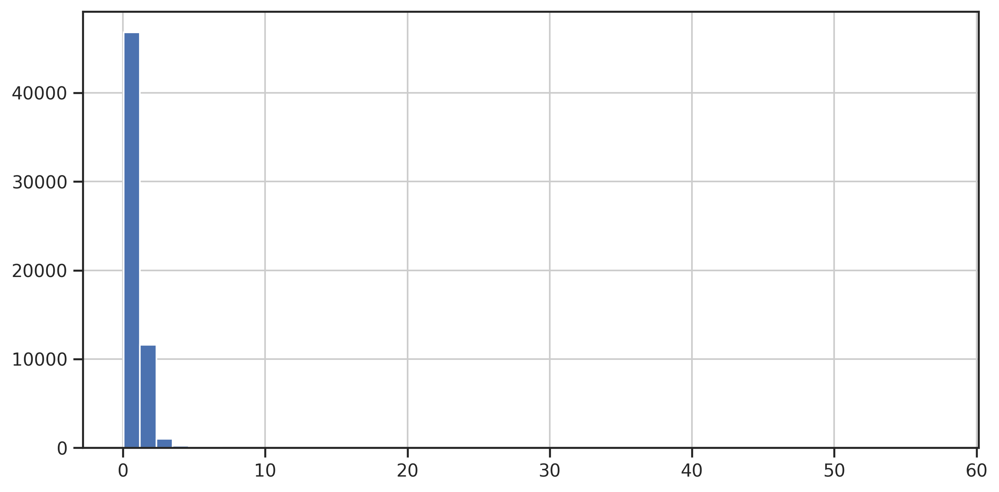

In [ ]:
target.target.hist(bins=50,figsize=(10,5));

### Concatenate all together

In [ ]:
target

,kinase,substrate,target,position,aa
0,AAK1,-5P,1.254994,-5,P
1,ACVR2A,-5P,0.706368,-5,P
2,ACVR2B,-5P,0.842427,-5,P
3,AKT1,-5P,0.862181,-5,P
4,AKT2,-5P,0.939973,-5,P
...,...,...,...,...,...
59989,YANK2,4y,7.133034,4,y
59990,YANK3,4y,6.497018,4,y
59991,YSK1,4y,0.377163,4,y
59992,YSK4,4y,0.725139,4,y


In [ ]:
df = target.merge(aa,'left').merge(prot,'left')

In [ ]:
df

kinase substrate    target  position aa  MaxAbsEStateIndex  \
0        AAK1       -5P  1.254994        -5  P          10.139074   
1      ACVR2A       -5P  0.706368        -5  P          10.139074   
2      ACVR2B       -5P  0.842427        -5  P          10.139074   
3        AKT1       -5P  0.862181        -5  P          10.139074   
4        AKT2       -5P  0.939973        -5  P          10.139074   
...       ...       ...       ...       ... ..                ...   
59989   YANK2        4y  7.133034         4  y          10.527171   
59990   YANK3        4y  6.497018         4  y          10.527171   
59991    YSK1        4y  0.377163         4  y          10.527171   
59992    YSK4        4y  0.725139         4  y          10.527171   
59993     ZAK        4y  0.640778         4  y          10.527171   

       MinAbsEStateIndex  MinEStateIndex       qed     MolWt  \
0              -0.334373        0.630545  0.055833 -0.793519   
1              -0.334373        0.630545  0.055833 -0.793519   
2              -0.334373        0.630545  0.055833 -0.793519   
3              -0.334373        0.630545  0.055833 -0.793519   
4              -0.334373        0.630545  0.055833 -0.793519   
...                  ...             ...       ...       ...   
59989          -1.202297       -2.532486  0.562020  2.831075   
59990          -1.202297       -2.532486  0.562020  2.831075   
59991          -1.202297       -2.532486  0.562020  2.831075   
59992          -1.202297       -2.532486  0.562020  2.831075   
59993          -1.202297       -2.532486  0.562020  2.831075   

       MinPartialCharge  MaxAbsPartialCharge  FpDensityMorgan1  \
0              0.230539            -0.310204          0.445994   
1              0.230539            -0.310204          0.445994   
2              0.230539            -0.310204          0.445994   
3              0.230539            -0.310204          0.445994   
4              0.230539            -0.310204          0.445994   
...                 ...                  ...               ...   
59989          0.231079             3.934947         -1.476873   
59990          0.231079             3.934947         -1.476873   
59991          0.231079             3.934947         -1.476873   
59992          0.231079             3.934947         -1.476873   
59993          0.231079             3.934947         -1.476873   

       FpDensityMorgan2  FpDensityMorgan3  BCUT2D_MWHI  BCUT2D_MWLOW  \
0              1.755094          1.292222    -0.526815      0.156428   
1              1.755094          1.292222    -0.526815      0.156428   
2              1.755094          1.292222    -0.526815      0.156428   
3              1.755094          1.292222    -0.526815      0.156428   
4              1.755094          1.292222    -0.526815      0.156428   
...                 ...               ...          ...           ...   
59989         -1.306127         -0.327286     1.836549     -0.850274   
59990         -1.306127         -0.327286     1.836549     -0.850274   
59991         -1.306127         -0.327286     1.836549     -0.850274   
59992         -1.306127         -0.327286     1.836549     -0.850274   
59993         -1.306127         -0.327286     1.836549     -0.850274   

       BCUT2D_CHGHI  BCUT2D_CHGLO  BCUT2D_LOGPHI  BCUT2D_LOGPLOW  \
0          1.016748      0.338924       0.290406        0.348255   
1          1.016748      0.338924       0.290406        0.348255   
2          1.016748      0.338924       0.290406        0.348255   
3          1.016748      0.338924       0.290406        0.348255   
4          1.016748      0.338924       0.290406        0.348255   
...             ...           ...            ...             ...   
59989      0.588259     -0.817078       1.870252       -0.051427   
59990      0.588259     -0.817078       1.870252       -0.051427   
59991      0.588259     -0.817078       1.870252       -0.051427   
59992      0.588259     -0.817078       1.870252       -0.051427   
599

In [ ]:
# check order
(df.kinase == target.kinase).value_counts()

True    59994
Name: kinase, dtype: int64

## Train

In [ ]:
show_doc(xgb_trainer)

---

### xgb_trainer

>      xgb_trainer (df, feature_col, target_col, test_index=None,
>                   xgb_params={'max_depth': 7, 'learning_rate': 0.001,
>                   'subsample': 0.8, 'colsample_bytree': 1, 'eval_metric':
>                   'rmse', 'objective': 'reg:squarederror', 'tree_method':
>                   'gpu_hist', 'predictor': 'gpu_predictor', 'random_state':
>                   123}, model_file='xgb_model.bin', split_seed=123)

|    | **Type** | **Default** | **Details** |
| -- | -------- | ----------- | ----------- |
| df |  |  |  |
| feature_col |  |  |  |
| target_col |  |  |  |
| test_index | NoneType | None |  |
| xgb_params | dict | {'max_depth': 7, 'learning_rate': 0.001, 'subsample': 0.8, 'colsample_bytree': 1, 'eval_metric': 'rmse', 'objective': 'reg:squarederror', 'tree_method': 'gpu_hist', 'predictor': 'gpu_predictor', 'random_state': 123} |  |
| model_file | str | xgb_model.bin |  |
| split_seed | int | 123 | seed of random split |

### Assign feature and target col

In [ ]:
df.columns

Index(['kinase', 'substrate', 'target', 'position', 'aa', 'MaxAbsEStateIndex',
       'MinAbsEStateIndex', 'MinEStateIndex', 'qed', 'MolWt',
       ...
       '1014', '1015', '1016', '1017', '1018', '1019', '1020', '1021', '1022',
       '1023'],
      dtype='object', length=1101)

In [ ]:
target_col = 'target'

In [ ]:
feat_col = ['position'] + df.columns[5:].tolist()

In [ ]:
feat_col[:5]

['position', 'MaxAbsEStateIndex', 'MinAbsEStateIndex', 'MinEStateIndex', 'qed']

### Randomly split

Randomly split in to 80% train and 20% valid. The disadvantage of this method is that it samples from the dataset not by individual kinase, but by each data point.

xgb params is: {'max_depth': 7, 'learning_rate': 0.001, 'subsample': 0.8, 'colsample_bytree': 1, 'eval_metric': 'rmse', 'objective': 'reg:squarederror', 'tree_method': 'gpu_hist', 'predictor': 'gpu_predictor', 'random_state': 123}
(47836, 38) (47836,) (11960, 38) (11960,)
Int64Index([58933, 48984, 34410, 36788, 19725, 45033, 44261, 35815,  2078,
            13763,
            ...
             6531, 24243, 39897, 58947, 19716,  4417, 38041,  6821, 54208,
            28701],
           dtype='int64', length=11960)
[0]	train-rmse:16.32983	valid-rmse:16.31167
[100]	train-rmse:14.78115	valid-rmse:14.76361
[200]	train-rmse:13.37977	valid-rmse:13.36293
[300]	train-rmse:12.11144	valid-rmse:12.09529
[400]	train-rmse:10.96389	valid-rmse:10.94841
[500]	train-rmse:9.92569	valid-rmse:9.91077
[600]	train-rmse:8.98642	valid-rmse:8.97205
[700]	train-rmse:8.13674	valid-rmse:8.12282
[800]	train-rmse:7.36804	valid-rmse:7.35464
[900]	train-rmse:6.67273	valid-rmse:6.65981
[1000]	train-rmse:6.04384	valid-rm

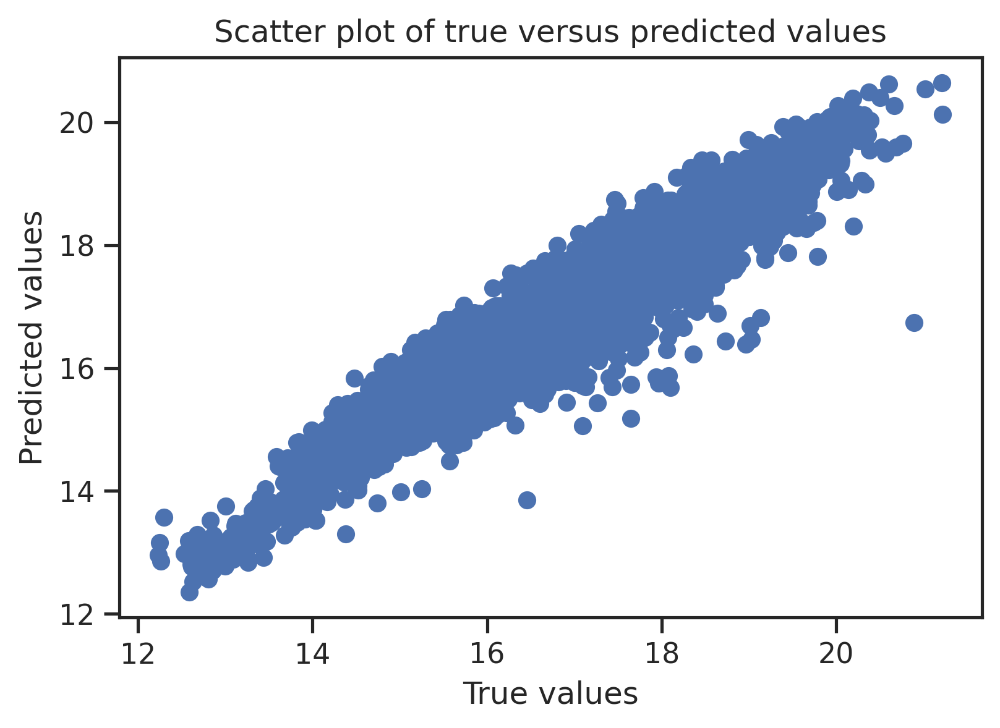

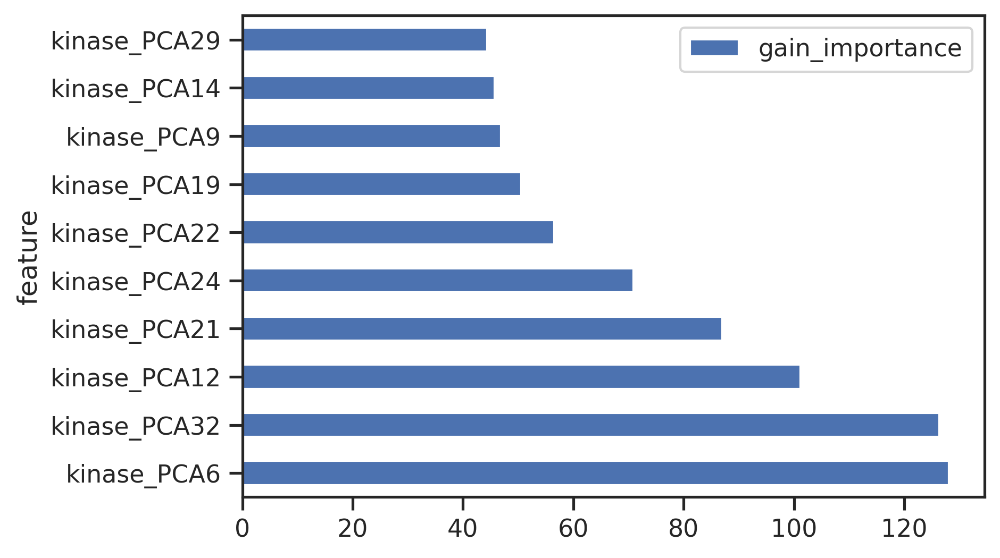

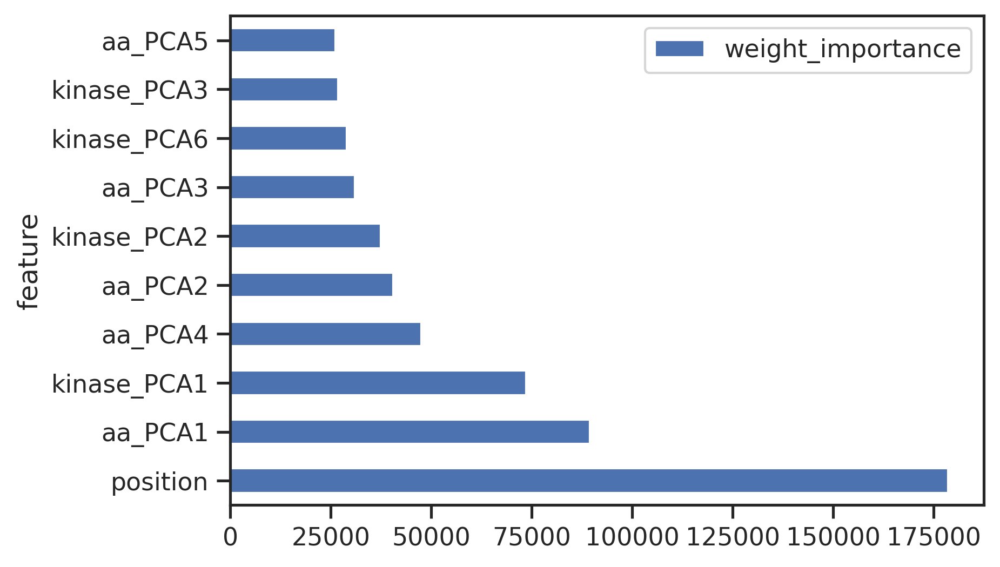

In [ ]:
pred, gain, weight = xgb_trainer(df, feat_col, target_col) #model_file = 'model/dummy.bin'

### StratifiedGroupKfold: split by group

We can use StratifiedGroupKFold to split the training and valid set: we group each point by kinase, and then stratify the kinase by their category. This split method ensures that the model:
- when validate in valid/test set, it would not see the same kinase in training set (no data leakage problem)
- during training, it learns diverse patterns of substrate specificity

In [ ]:
# prepare the dataframe for split
kinase_info = Data.get_kinase_info()

kinase_info = kinase_info[['kinase','Family','category','category_big']]

info = df[['kinase']].merge(kinase_info,'left')

(info.kinase == df.kinase).value_counts()

True    59994
Name: kinase, dtype: int64

We split data into 5 fold, with 80% train, and 20% valid. We can just train one fold; For statsitics purpose, we can train all five folds and get their variance and OOF (out of fold) to calculate overall correlation metrics.

In [ ]:
# change max_depth from 7 to 9
params = {'max_depth': 9, 'learning_rate': 0.001, 'subsample': 0.8, 'colsample_bytree': 1, 'eval_metric': 'rmse', 'objective': 'reg:squarederror', 'tree_method': 'gpu_hist', 'predictor': 'gpu_predictor', 'random_state': 123}

# kinase in valid set: 61
# kinase in train set: 242
xgb params is: {'max_depth': 9, 'learning_rate': 0.001, 'subsample': 0.8, 'colsample_bytree': 1, 'eval_metric': 'rmse', 'objective': 'reg:squarederror', 'tree_method': 'gpu_hist', 'predictor': 'gpu_predictor', 'random_state': 123}
(47916, 1097) (47916,) (12078, 1097) (12078,)
Int64Index([    0,     5,    10,    15,    20,    25,    30,    36,    39,
               42,
            ...
            59946, 59952, 59956, 59964, 59966, 59969, 59971, 59980, 59987,
            59991],
           dtype='int64', length=12078)
[0]	train-rmse:1.02552	valid-rmse:1.00559
[100]	train-rmse:0.97077	valid-rmse:0.96358
[200]	train-rmse:0.92069	valid-rmse:0.92687
[300]	train-rmse:0.87554	valid-rmse:0.89482
[400]	train-rmse:0.83516	valid-rmse:0.86755
[500]	train-rmse:0.79878	valid-rmse:0.84393
[600]	train-rmse:0.76556	valid-rmse:0.82388
[700]	train-rmse:0.73588	valid-rmse:0.80717
[800]	train-rmse:0.70873	valid-rmse:0.79274
[900]	train-rmse:0.68412	valid-

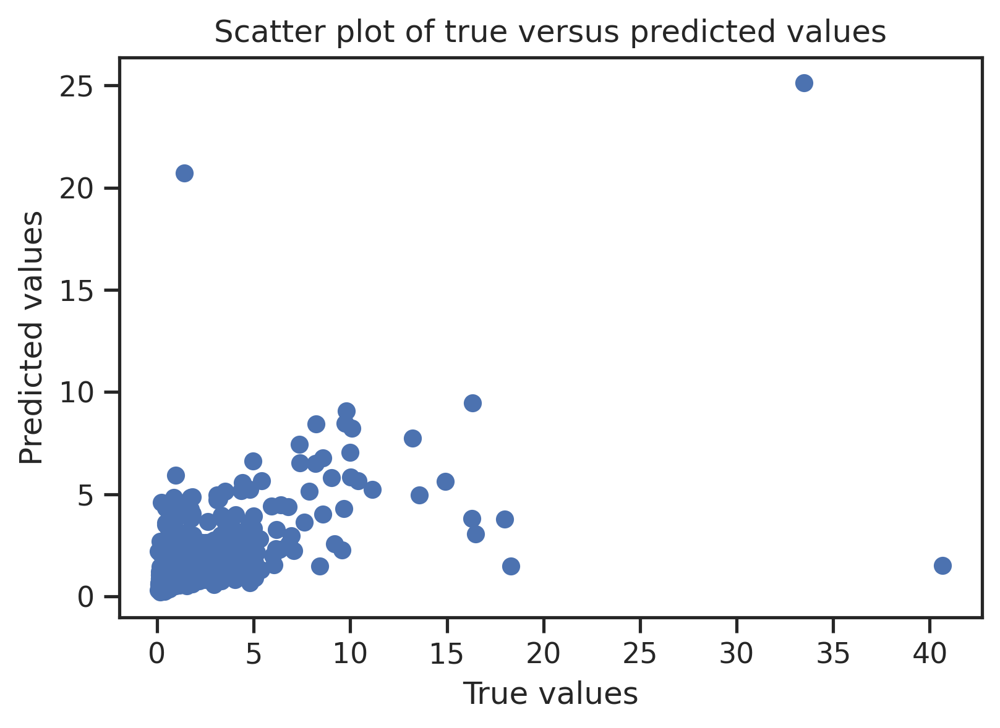

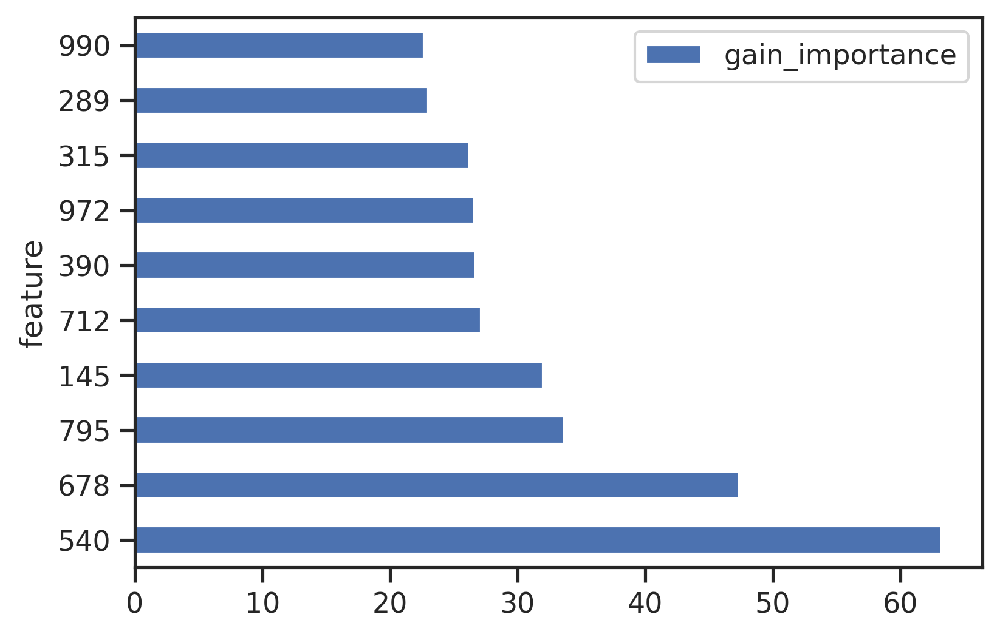

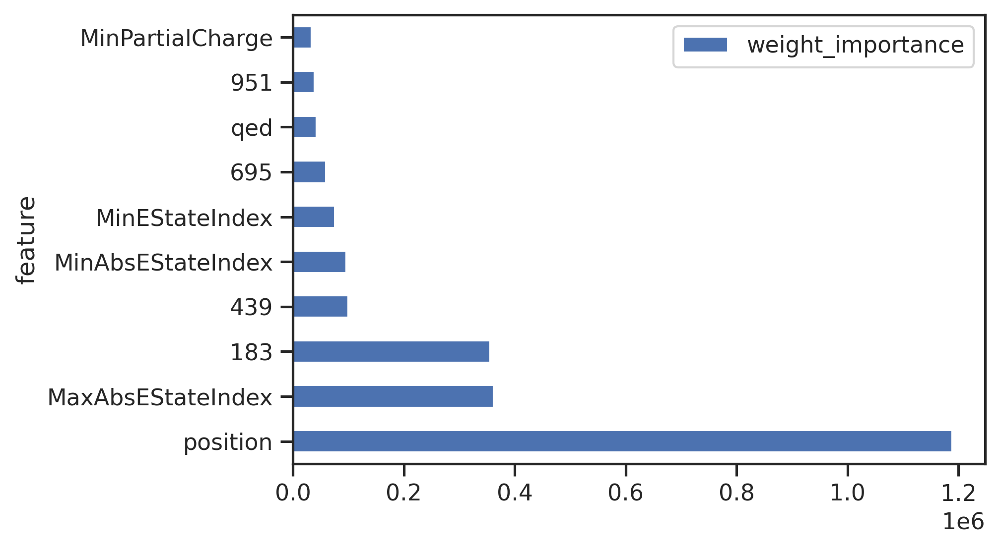

In [ ]:
FOLDS=5
pred_dfs = []
gains = []
weights = []
for fold, (train_idx, valid_idx) in enumerate(StratifiedGroupKFold(FOLDS).split(info.index.values, info.category,info.kinase)):
    print(f'# kinase in valid set: {info.loc[valid_idx].kinase.unique().shape[0]}')
    print(f'# kinase in train set: {info.loc[train_idx].kinase.unique().shape[0]}')
    pred_df5, gain, weight = xgb_trainer(df, feat_col, target_col = 'target', test_index=valid_idx, xgb_params = params, model_file = f'model/fold{fold}.bin')
    break

# kinase in valid set: 61
# kinase in train set: 242
xgb params is: {'max_depth': 7, 'learning_rate': 0.001, 'subsample': 0.8, 'colsample_bytree': 1, 'eval_metric': 'rmse', 'objective': 'reg:squarederror', 'tree_method': 'gpu_hist', 'predictor': 'gpu_predictor', 'random_state': 123}
(47916, 1097) (47916,) (12078, 1097) (12078,)
Int64Index([    0,     5,    10,    15,    20,    25,    30,    36,    39,
               42,
            ...
            59946, 59952, 59956, 59964, 59966, 59969, 59971, 59980, 59987,
            59991],
           dtype='int64', length=12078)
[0]	train-rmse:1.02562	valid-rmse:1.00564
[100]	train-rmse:0.98011	valid-rmse:0.96720
[200]	train-rmse:0.93995	valid-rmse:0.93448
[300]	train-rmse:0.90370	valid-rmse:0.90567
[400]	train-rmse:0.87187	valid-rmse:0.88148
[500]	train-rmse:0.84381	valid-rmse:0.86071
[600]	train-rmse:0.81845	valid-rmse:0.84274
[700]	train-rmse:0.79644	valid-rmse:0.82810
[800]	train-rmse:0.77613	valid-rmse:0.81483
[900]	train-rmse:0.75844	valid-

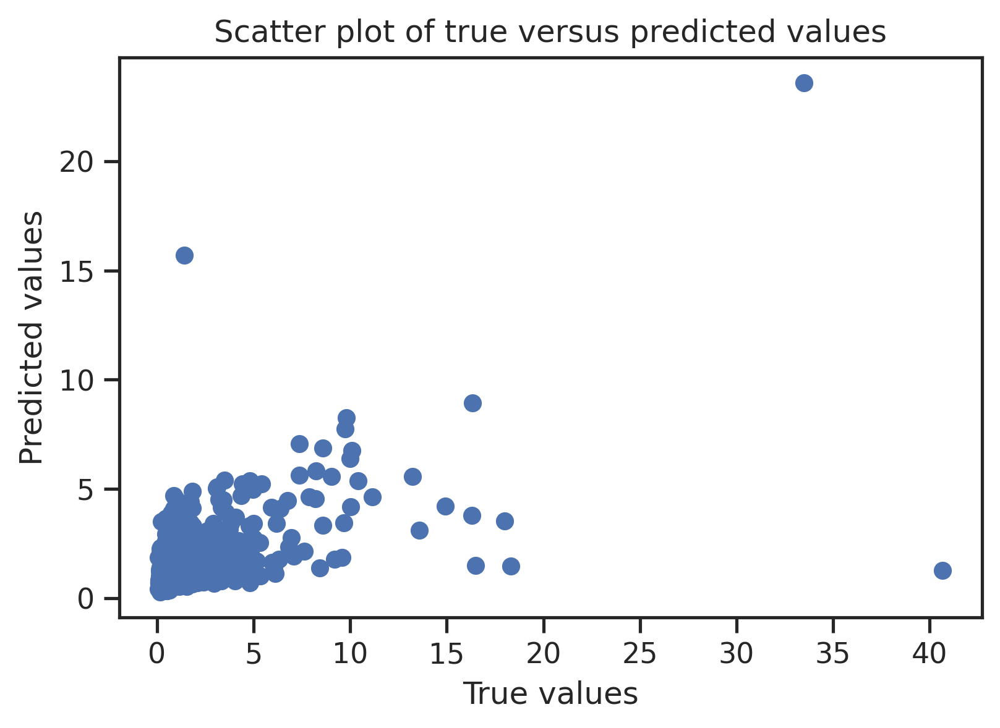

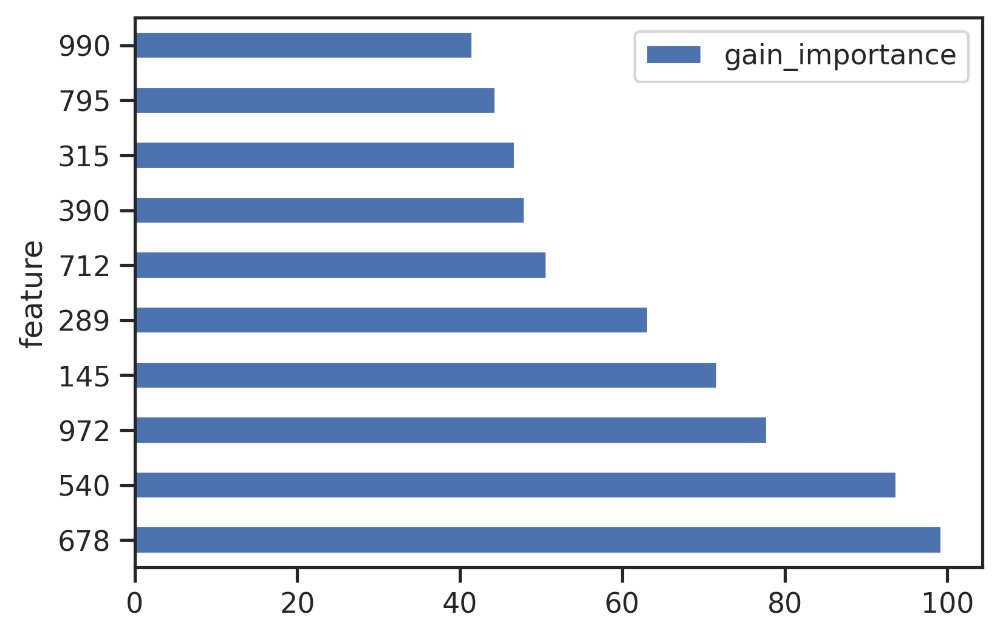

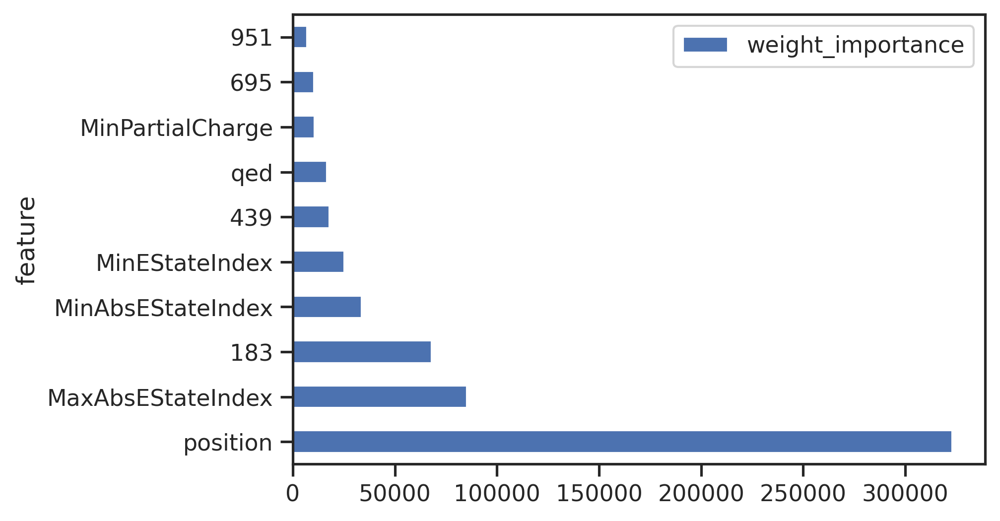

In [ ]:
FOLDS=5
pred_dfs = []
gains = []
weights = []
for fold, (train_idx, valid_idx) in enumerate(StratifiedGroupKFold(FOLDS).split(info.index.values, info.category,info.kinase)):
    print(f'# kinase in valid set: {info.loc[valid_idx].kinase.unique().shape[0]}')
    print(f'# kinase in train set: {info.loc[train_idx].kinase.unique().shape[0]}')
    pred_df5, gain, weight = xgb_trainer(df, feat_col, target_col = 'target', test_index=valid_idx, model_file = f'model/fold{fold}.bin')
    break

# kinase in valid set: 61
# kinase in train set: 242
xgb params is: {'max_depth': 7, 'learning_rate': 0.001, 'subsample': 0.8, 'colsample_bytree': 1, 'eval_metric': 'rmse', 'objective': 'reg:squarederror', 'tree_method': 'gpu_hist', 'predictor': 'gpu_predictor', 'random_state': 123}
(47916, 75) (47916,) (12078, 75) (12078,)
Int64Index([    0,     5,    10,    15,    20,    25,    30,    36,    39,
               42,
            ...
            59946, 59952, 59956, 59964, 59966, 59969, 59971, 59980, 59987,
            59991],
           dtype='int64', length=12078)
[0]	train-rmse:1.02567	valid-rmse:1.00569
[100]	train-rmse:0.98726	valid-rmse:0.97067
[200]	train-rmse:0.95377	valid-rmse:0.94097
[300]	train-rmse:0.92516	valid-rmse:0.91571
[400]	train-rmse:0.90006	valid-rmse:0.89399
[500]	train-rmse:0.87835	valid-rmse:0.87541
[600]	train-rmse:0.85868	valid-rmse:0.85961
[700]	train-rmse:0.84136	valid-rmse:0.84586
[800]	train-rmse:0.82632	valid-rmse:0.83417
[900]	train-rmse:0.81229	valid-rmse

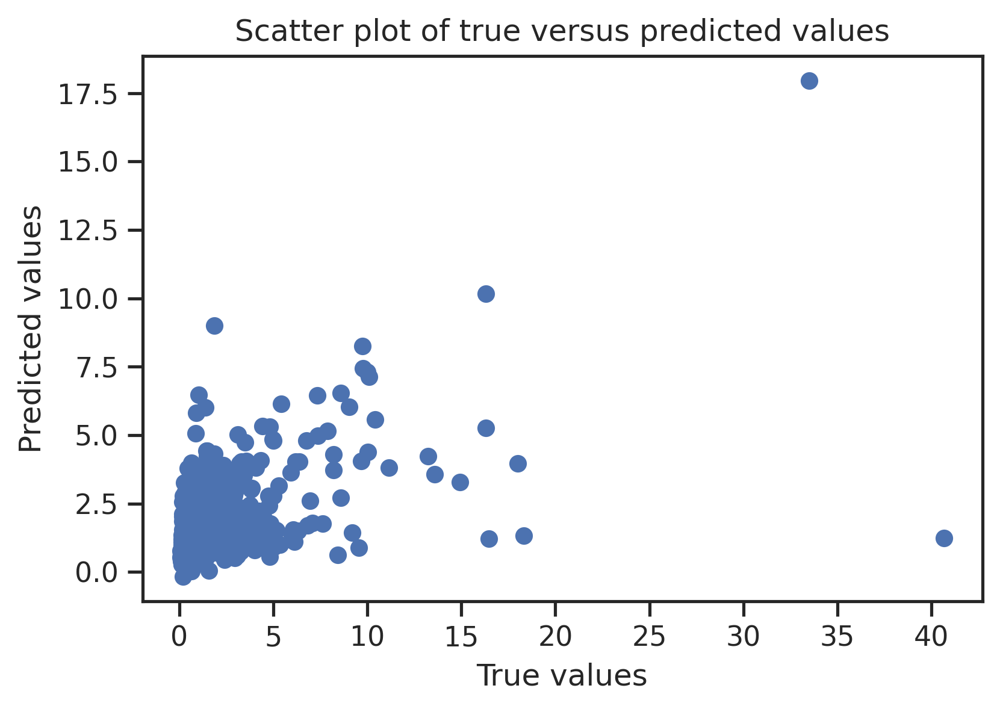

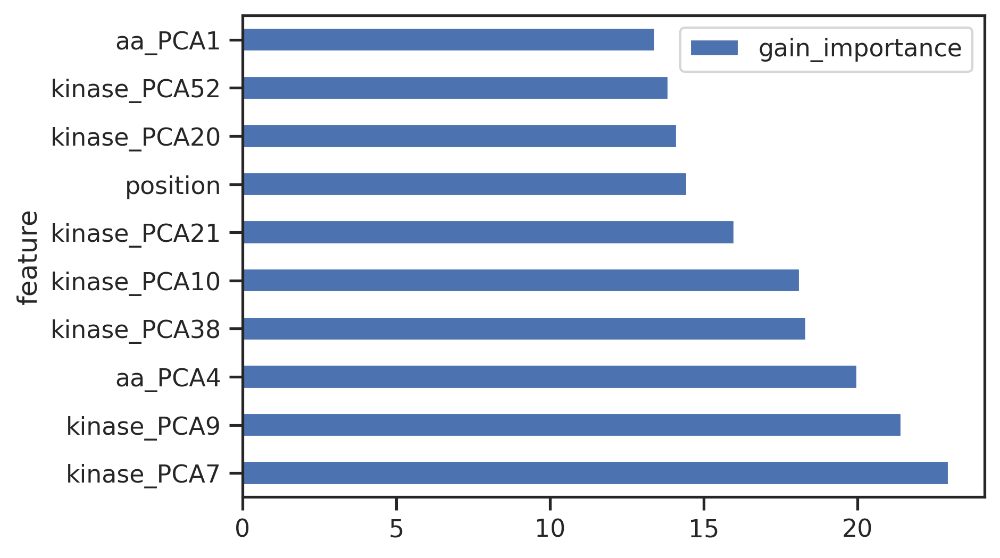

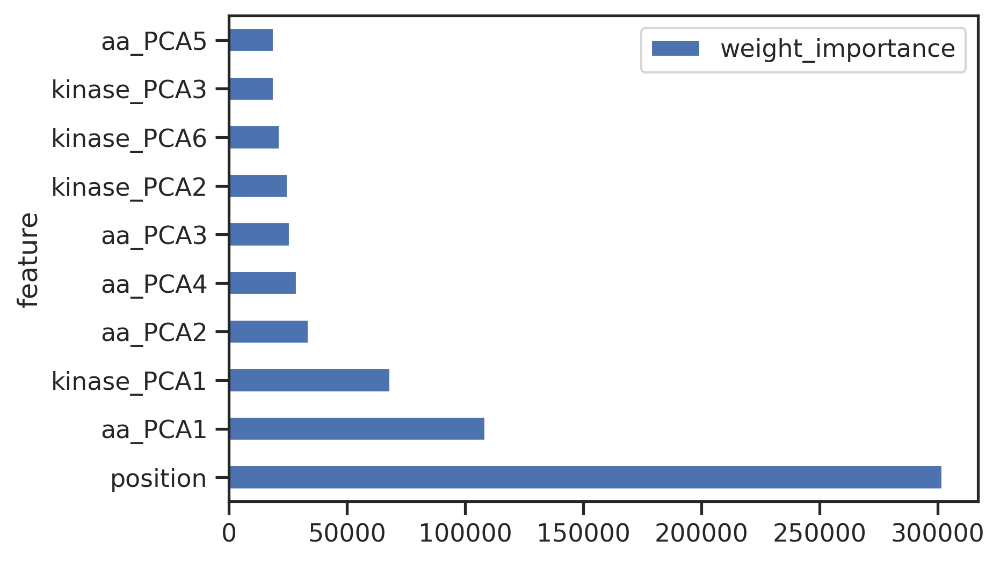

In [ ]:
FOLDS=5
pred_dfs = []
gains = []
weights = []
for fold, (train_idx, valid_idx) in enumerate(StratifiedGroupKFold(FOLDS).split(info.index.values, info.category,info.kinase)):
    print(f'# kinase in valid set: {info.loc[valid_idx].kinase.unique().shape[0]}')
    print(f'# kinase in train set: {info.loc[train_idx].kinase.unique().shape[0]}')
    pred_df4, gain, weight = xgb_trainer(df, feat_col, target_col = 'target', test_index=valid_idx, model_file = f'model/fold{fold}.bin')
    break

# kinase in valid set: 61
# kinase in train set: 242
xgb params is: {'max_depth': 7, 'learning_rate': 0.001, 'subsample': 0.8, 'colsample_bytree': 1, 'eval_metric': 'rmse', 'objective': 'reg:squarederror', 'tree_method': 'gpu_hist', 'predictor': 'gpu_predictor', 'random_state': 123}
(47916, 38) (47916,) (12078, 38) (12078,)
Int64Index([    0,     5,    10,    15,    20,    25,    30,    36,    39,
               42,
            ...
            59946, 59952, 59956, 59964, 59966, 59969, 59971, 59980, 59987,
            59991],
           dtype='int64', length=12078)
[0]	train-rmse:1.63755	valid-rmse:1.35713
[100]	train-rmse:1.59428	valid-rmse:1.31603
[200]	train-rmse:1.55533	valid-rmse:1.28066
[300]	train-rmse:1.52062	valid-rmse:1.25061
[400]	train-rmse:1.48972	valid-rmse:1.22544
[500]	train-rmse:1.46103	valid-rmse:1.20436
[600]	train-rmse:1.43454	valid-rmse:1.18697
[700]	train-rmse:1.40827	valid-rmse:1.17283
[800]	train-rmse:1.37953	valid-rmse:1.16072
[900]	train-rmse:1.35179	valid-rmse

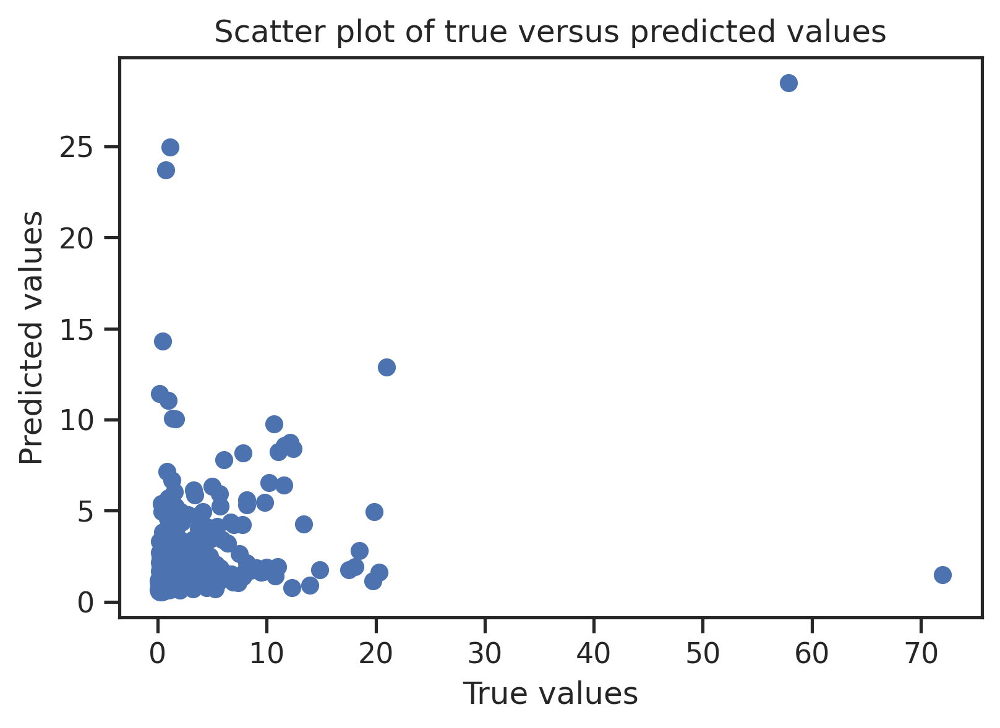

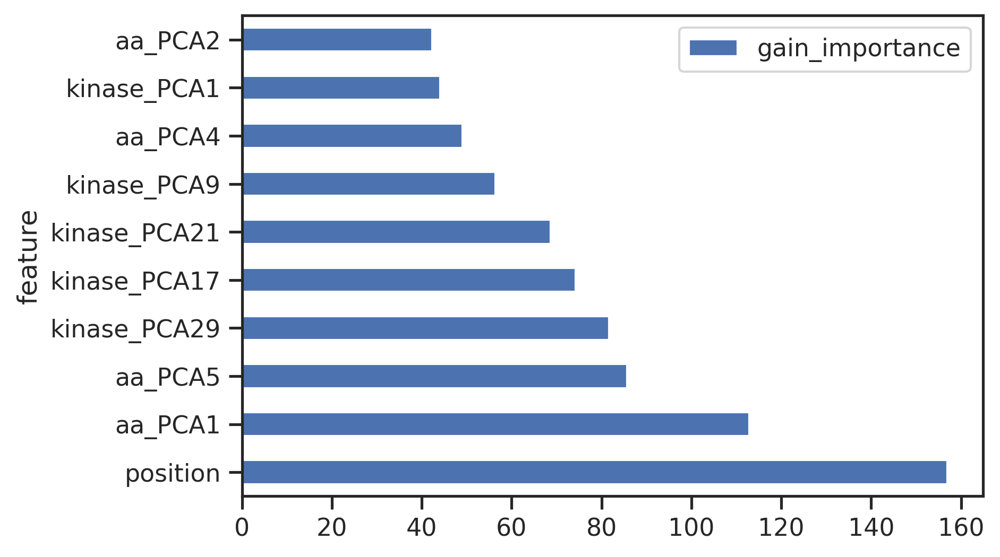

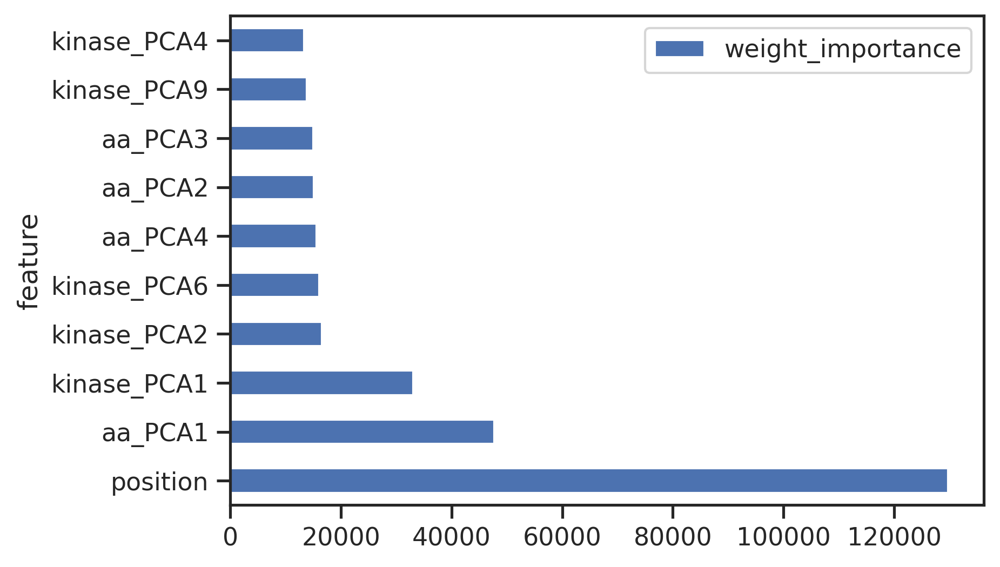

In [ ]:
FOLDS=5
pred_dfs = []
gains = []
weights = []
for fold, (train_idx, valid_idx) in enumerate(StratifiedGroupKFold(FOLDS).split(info.index.values, info.category,info.kinase)):
    print(f'# kinase in valid set: {info.loc[valid_idx].kinase.unique().shape[0]}')
    print(f'# kinase in train set: {info.loc[train_idx].kinase.unique().shape[0]}')
    pred_df3, gain, weight = xgb_trainer(df, feat_col, target_col = 'target', test_index=valid_idx, model_file = f'model/fold{fold}.bin')
    break

# kinase in valid set: 61
# kinase in train set: 242
xgb params is: {'max_depth': 7, 'learning_rate': 0.001, 'subsample': 0.8, 'colsample_bytree': 1, 'eval_metric': 'rmse', 'objective': 'reg:squarederror', 'tree_method': 'gpu_hist', 'predictor': 'gpu_predictor', 'random_state': 123}
(47916, 38) (47916,) (12078, 38) (12078,)
Int64Index([    0,     5,    10,    15,    20,    25,    30,    36,    39,
               42,
            ...
            59946, 59952, 59956, 59964, 59966, 59969, 59971, 59980, 59987,
            59991],
           dtype='int64', length=12078)
[0]	train-rmse:1.02568	valid-rmse:1.00569
[100]	train-rmse:0.98859	valid-rmse:0.97169
[200]	train-rmse:0.95652	valid-rmse:0.94281
[300]	train-rmse:0.92877	valid-rmse:0.91824
[400]	train-rmse:0.90470	valid-rmse:0.89736
[500]	train-rmse:0.88376	valid-rmse:0.87958
[600]	train-rmse:0.86547	valid-rmse:0.86458
[700]	train-rmse:0.84950	valid-rmse:0.85189
[800]	train-rmse:0.83530	valid-rmse:0.84098
[900]	train-rmse:0.82257	valid-rmse

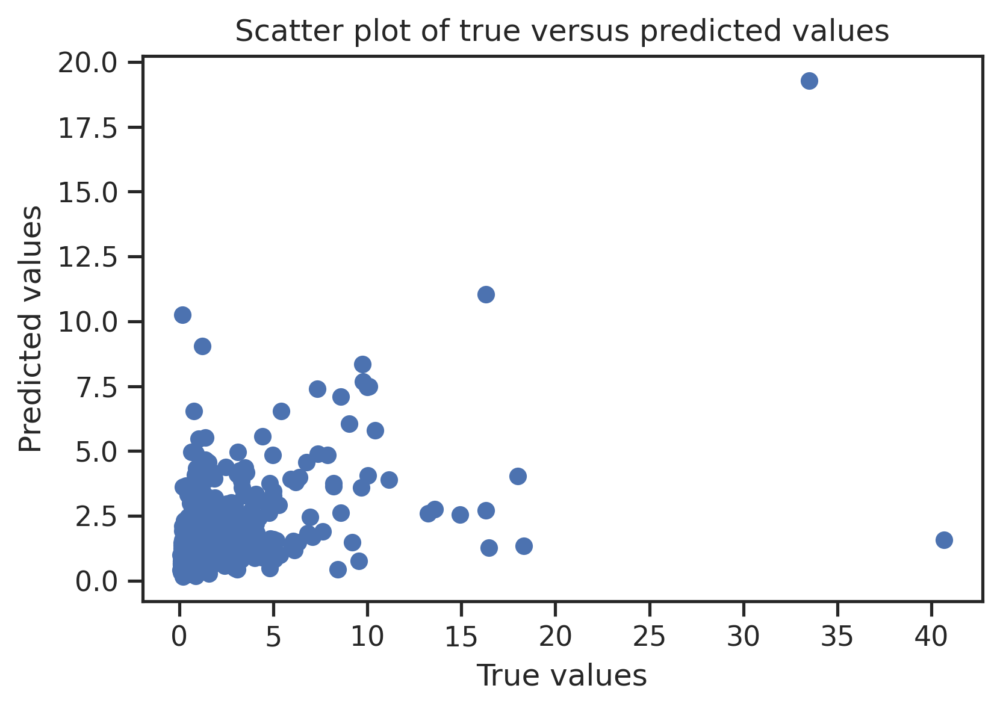

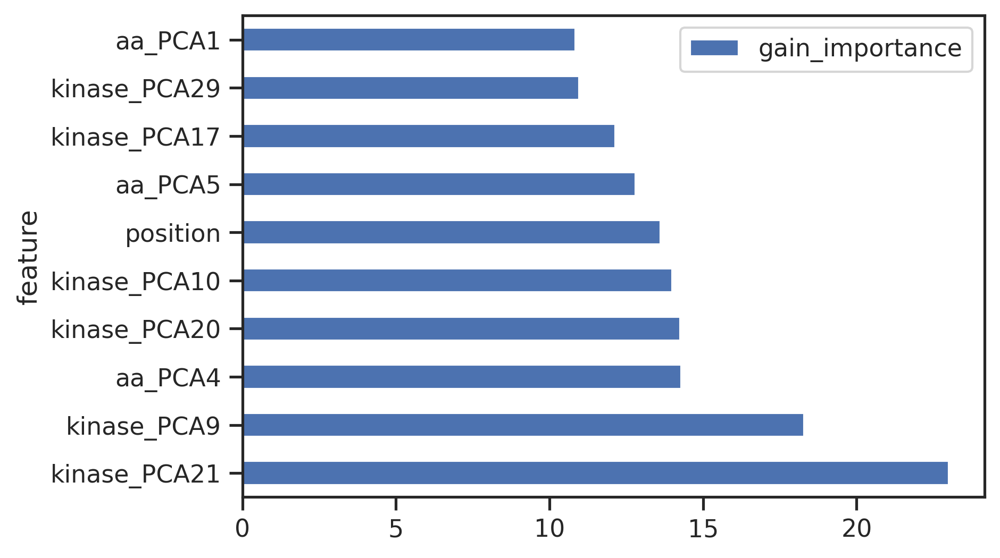

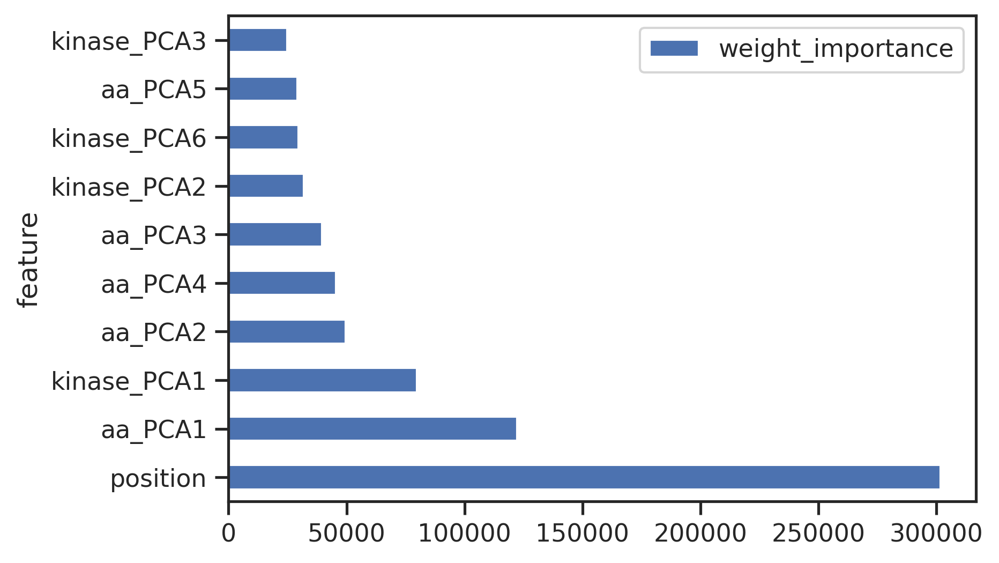

In [ ]:
FOLDS=5
pred_dfs = []
gains = []
weights = []
for fold, (train_idx, valid_idx) in enumerate(StratifiedGroupKFold(FOLDS).split(info.index.values, info.category,info.kinase)):
    print(f'# kinase in valid set: {info.loc[valid_idx].kinase.unique().shape[0]}')
    print(f'# kinase in train set: {info.loc[train_idx].kinase.unique().shape[0]}')
    pred_df2, gain, weight = xgb_trainer(df, feat_col, target_col = 'target', test_index=valid_idx, model_file = f'model/fold{fold}.bin')
    pred_dfs.append(pred_df2)
    gains.append(gain)
    weights.append(weight)
    break

# kinase in valid set: 61
# kinase in train set: 242
xgb params is: {'max_depth': 7, 'learning_rate': 0.001, 'subsample': 0.8, 'colsample_bytree': 1, 'eval_metric': 'rmse', 'objective': 'reg:squarederror', 'tree_method': 'gpu_hist', 'predictor': 'gpu_predictor', 'random_state': 123}
(47916, 38) (47916,) (12078, 38) (12078,)
Int64Index([    0,     5,    10,    15,    20,    25,    30,    36,    39,
               42,
            ...
            59946, 59952, 59956, 59964, 59966, 59969, 59971, 59980, 59987,
            59991],
           dtype='int64', length=12078)
[0]	train-rmse:78544830.72334	valid-rmse:136230139.39014
[100]	train-rmse:73249339.78485	valid-rmse:132460683.47466
[200]	train-rmse:68559755.35750	valid-rmse:129353476.61663
[300]	train-rmse:64364996.22699	valid-rmse:126760556.83009
[400]	train-rmse:60630301.17449	valid-rmse:124606043.23851
[500]	train-rmse:57302085.68086	valid-rmse:122791082.38527
[600]	train-rmse:54340598.21943	valid-rmse:121248276.49325
[700]	train-rmse:5

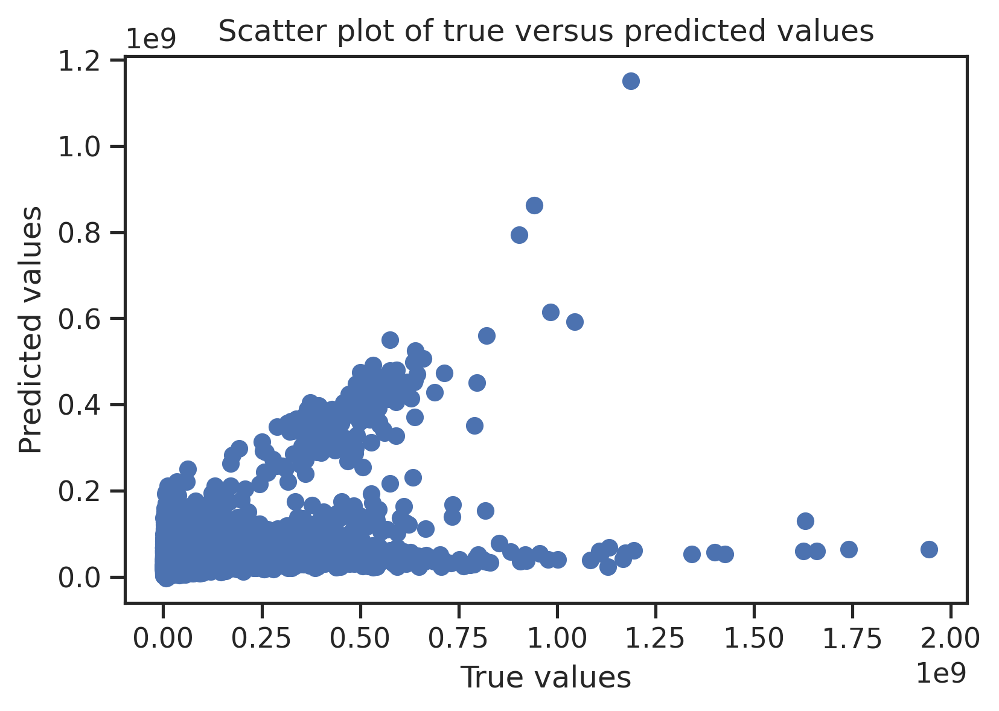

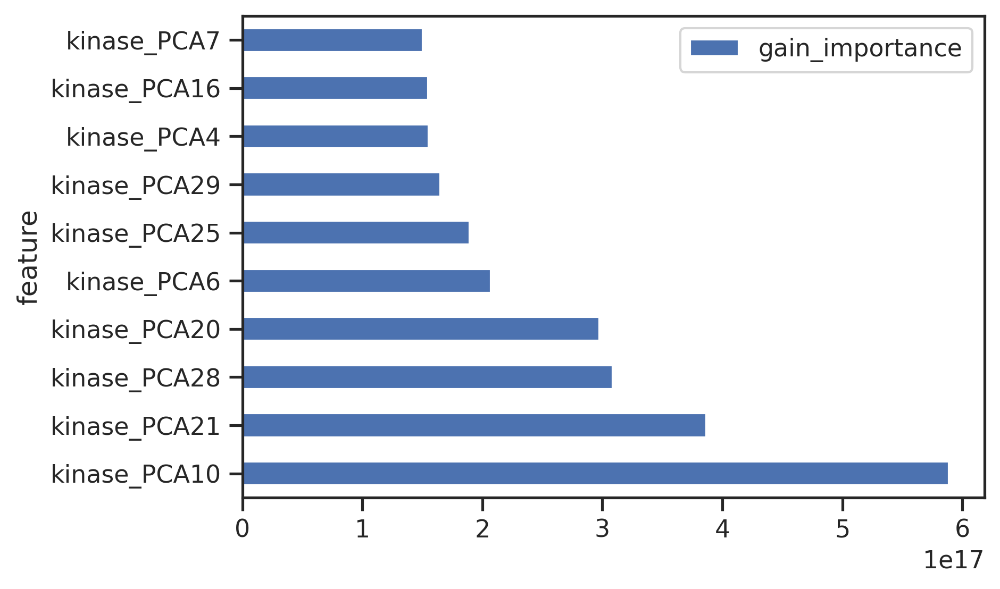

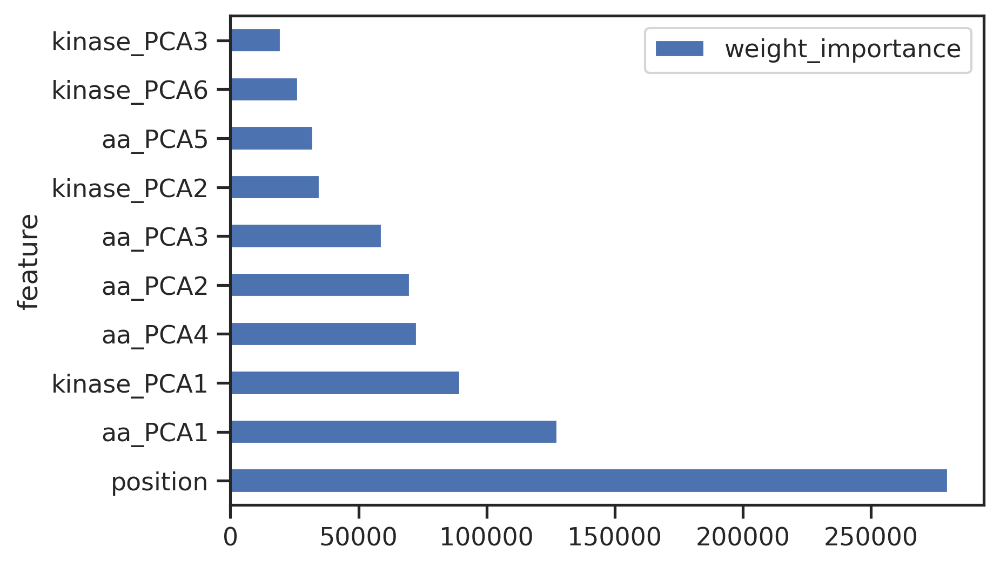

In [ ]:
FOLDS=5
pred_dfs = []
gains = []
weights = []
for fold, (train_idx, valid_idx) in enumerate(StratifiedGroupKFold(FOLDS).split(info.index.values, info.category,info.kinase)):
    print(f'# kinase in valid set: {info.loc[valid_idx].kinase.unique().shape[0]}')
    print(f'# kinase in train set: {info.loc[train_idx].kinase.unique().shape[0]}')
    pred_df, gain, weight = xgb_trainer(df, feat_col, target_col = 'target', test_index=valid_idx, model_file = f'model/fold{fold}.bin')
    pred_dfs.append(pred_df)
    gains.append(gain)
    weights.append(weight)
    break

## Save gain & weight importance

Save gain importance and weight importance of each fold to dataframes

In [ ]:
# gain importance
g = pd.concat(gains, axis=1, keys=range(len(gains)))

g.columns = ['gain_importance_'+ str(i) for i in range(FOLDS)]

In [ ]:
# weight importance
w = pd.concat(weights,axis=1,keys = range(len(weights)))

w.columns = ['weight_importance_'+ str(i) for i in range(FOLDS)]

In [ ]:
# g.to_csv('model/gains.csv')
# w.to_csv('model/weights.csv')

In [ ]:
g.head()

In [ ]:
w.head()

## Predict

Here's just an example. Suppose we prepared a test set

In [ ]:
show_doc(xgb_predict)

---

### xgb_predict

>      xgb_predict (df, feature_col, ID_col='ID', model_file='xgb_model.bin')

|    | **Type** | **Default** | **Details** |
| -- | -------- | ----------- | ----------- |
| df |  |  | a dataframe that contains ID and features for prediction |
| feature_col |  |  | feature column name |
| ID_col | str | ID | ID column name |
| model_file | str | xgb_model.bin |  |

In [ ]:
test_idx = valid_idx

In [ ]:
test = df.loc[test_idx]

In [ ]:
test.head(2)

,kinase,substrate,target,position,aa,A,C,D,E,F,G,H,I,K,L,M,N,P,Q,R,S,T,V,W,Y,t,y,AAK1,ACVR2A,ACVR2B,AKT1,AKT2,AKT3,ALK2,ALK4,ALPHAK3,AMPKA1,AMPKA2,ANKRD3,ASK1,ATM,ATR,AURA,AURB,AURC,BCKDK,BIKE,BMPR1A,BMPR1B,BMPR2,BRAF,BRSK1,BRSK2,BUB1,CAMK1A,CAMK1B,CAMK1D,CAMK1G,CAMK2A,CAMK2B,CAMK2D,CAMK2G,CAMK4,CAMKK1,CAMKK2,CAMLCK,CDC7,CDK1,CDK10,CDK12,CDK13,CDK14,CDK16,CDK17,CDK18,CDK19,CDK2,CDK3,CDK4,CDK5,CDK6,CDK7,CDK8,CDK9,CDKL1,CDKL5,CHAK1,CHAK2,CHK1,CHK2,CK1A,CK1A2,CK1D,CK1E,CK1G1,CK1G3,CK2A1,CK2A2,CLK1,CLK2,CLK3,CLK4,COT,CRIK,DAPK1,DAPK2,DAPK3,DCAMKL1,DCAMKL2,DLK,DMPK1,DNAPK,DRAK1,DSTYK,DYRK1A,DYRK1B,DYRK2,DYRK3,DYRK4,EEF2K,ERK1,ERK2,ERK5,ERK7,FAM20C,GAK,GCK,GCN2,GRK1,GRK2,GRK3,GRK4,GRK5,GRK6,GRK7,GSK3A,GSK3B,HASPIN,HGK,HIPK1,HIPK2,HIPK3,HIPK4,HPK1,HRI,HUNK,ICK,IKKA,IKKB,IKKE,IRAK1,IRAK4,IRE1,IRE2,JNK1,JNK2,JNK3,KHS1,KHS2,KIS,LATS1,LATS2,LKB1,LOK,LRRK2,MAK,MAP3K15,MAPKAPK2,MAPKAPK3,MAPKAPK5,MARK1,MARK2,MARK3,MARK4,MASTL,MEK1,MEK2,MEK5,MEKK1,MEKK2,MEKK3,MEKK6,MELK,MINK,MLK1,MLK2,MLK3,MLK4,MNK1,MNK2,MOK,MOS,MPSK1,MRCKA,MRCKB,MSK1,MSK2,MST1,MST2,MST3,MST4,MTOR,MYLK4,MYO3A,MYO3B,NDR1,NDR2,NEK1,NEK11,NEK2,NEK3,NEK4,NEK5,NEK6,NEK7,NEK8,NEK9,NIK,NIM1,NLK,NUAK1,NUAK2,OSR1,P38A,P38B,P38D,P38G,P70S6K,P70S6KB,P90RSK,PAK1,PAK2,PAK3,PAK4,PAK5,PAK6,PASK,PBK,PDHK1,PDHK4,PDK1,PERK,PHKG1,PHKG2,PIM1,PIM2,PIM3,PINK1,PKACA,PKACB,PKACG,PKCA,PKCB,PKCD,PKCE,PKCG,PKCH,PKCI,PKCT,PKCZ,PKG1,PKG2,PKN1,PKN2,PKN3,PKR,PLK1,PLK2,PLK3,PLK4,PRKD1,PRKD2,PRKD3,PRKX,PRP4,PRPK,QIK,QSK,RAF1,RIPK1,RIPK2,RIPK3,ROCK1,ROCK2,RSK2,RSK3,RSK4,SBK,SGK1,SGK3,SIK,SKMLCK,SLK,SMG1,SMMLCK,SNRK,SRPK1,SRPK2,SRPK3,SSTK,STK33,STLK3,TAK1,TAO1,TAO2,TAO3,TBK1,TGFBR1,TGFBR2,TLK1,TLK2,TNIK,TSSK1,TSSK2,TTBK1,TTBK2,TTK,ULK1,ULK2,VRK1,VRK2,WNK1,WNK3,WNK4,YANK2,YANK3,YSK1,YSK4,ZAK
0,AAK1,-5P,15.845517,-5,P,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
5,AKT3,-5P,15.962520,-5,P,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
pred_test = xgb_predict(test, feat_col, ID_col = 'kinase', model_file = 'model/fold0.bin')

Check whether predict works

In [ ]:
(pred_test.preds.round(2) == pred_df.pred.round(2)).value_counts()

True    12078
dtype: int64

## Transform target/pred back

In [ ]:
pred_df.head()

,label,pred
0,15.845517,16.214771
5,15.962520,16.510622
10,17.624320,17.831568
15,15.553056,17.284220
20,14.881759,16.441727


As we log transform the label, we need to transform them back

In [ ]:
pred_df = pred_df.apply(np.exp)

Combine all info

In [ ]:
pred5 = pd.concat([pred_df5, df[['kinase','substrate','position','aa']].loc[pred_df5.index],info.loc[pred_df5.index].drop(columns='kinase')], axis=1)

In [ ]:
pred5 = pd.concat([pred_df5, df[['kinase','substrate','position','aa']].loc[pred_df5.index],info.loc[pred_df5.index].drop(columns='kinase')], axis=1)

In [ ]:
pred4 = pd.concat([pred_df4, df[['kinase','substrate','position','aa']].loc[pred_df4.index],info.loc[pred_df4.index].drop(columns='kinase')], axis=1)

In [ ]:
pred3 = pd.concat([pred_df3, df[['kinase','substrate','position','aa']].loc[pred_df3.index],info.loc[pred_df3.index].drop(columns='kinase')], axis=1)

In [ ]:
pred2 = pd.concat([pred_df2, df[['kinase','substrate','position','aa']].loc[pred_df2.index],info.loc[pred_df2.index].drop(columns='kinase')], axis=1)

In [ ]:
pred = pd.concat([pred_df, df[['kinase','substrate','position','aa']].loc[pred_df.index],info.loc[pred_df.index].drop(columns='kinase')], axis=1)

In [ ]:
pred.kinase.unique().shape

(61,)

In [ ]:
pred.head()

,label,pred,kinase,substrate,position,aa,Family,category,category_big
0,7614134.38,11412400.0,AAK1,-5P,-5,P,Other,NAK,NAK
5,8559223.07,28787494.0,AKT3,-5P,-5,P,AGC,AKT/ROCK,basophilic
10,45096733.42,77062984.0,AMPKA2,-5P,-5,P,CAMK,AMPK,basophilic
15,5683377.86,66964656.0,AURA,-5P,-5,P,Other,AURK/PKA,basophilic
20,2904462.06,14244610.0,BMPR1A,-5P,-5,P,TKL,TGFBR,acidophilic


## Overall analysis

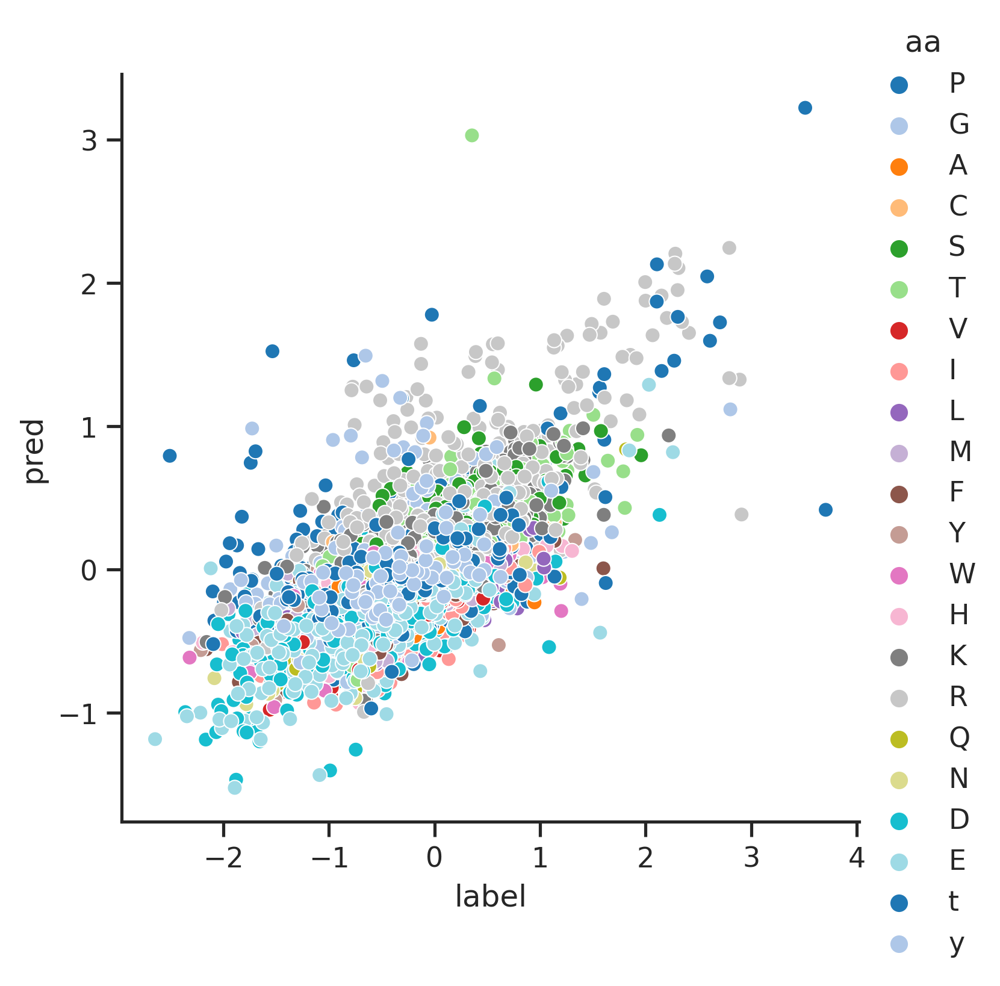

In [ ]:
sns.relplot(x=np.log(pred5.label), y=np.log(pred5.pred), hue = pred5.aa,palette='tab20');

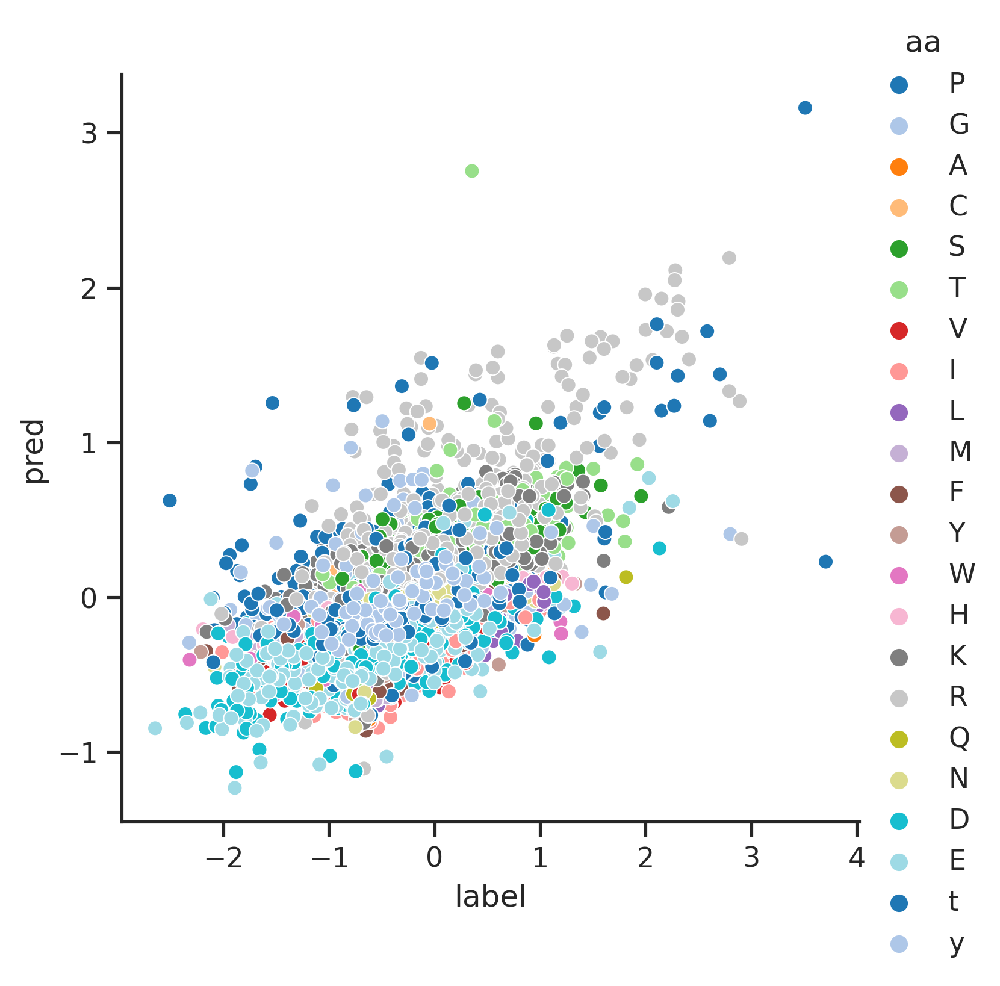

In [ ]:
sns.relplot(x=np.log(pred5.label), y=np.log(pred5.pred), hue = pred5.aa,palette='tab20');

/usr/local/lib/python3.9/dist-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


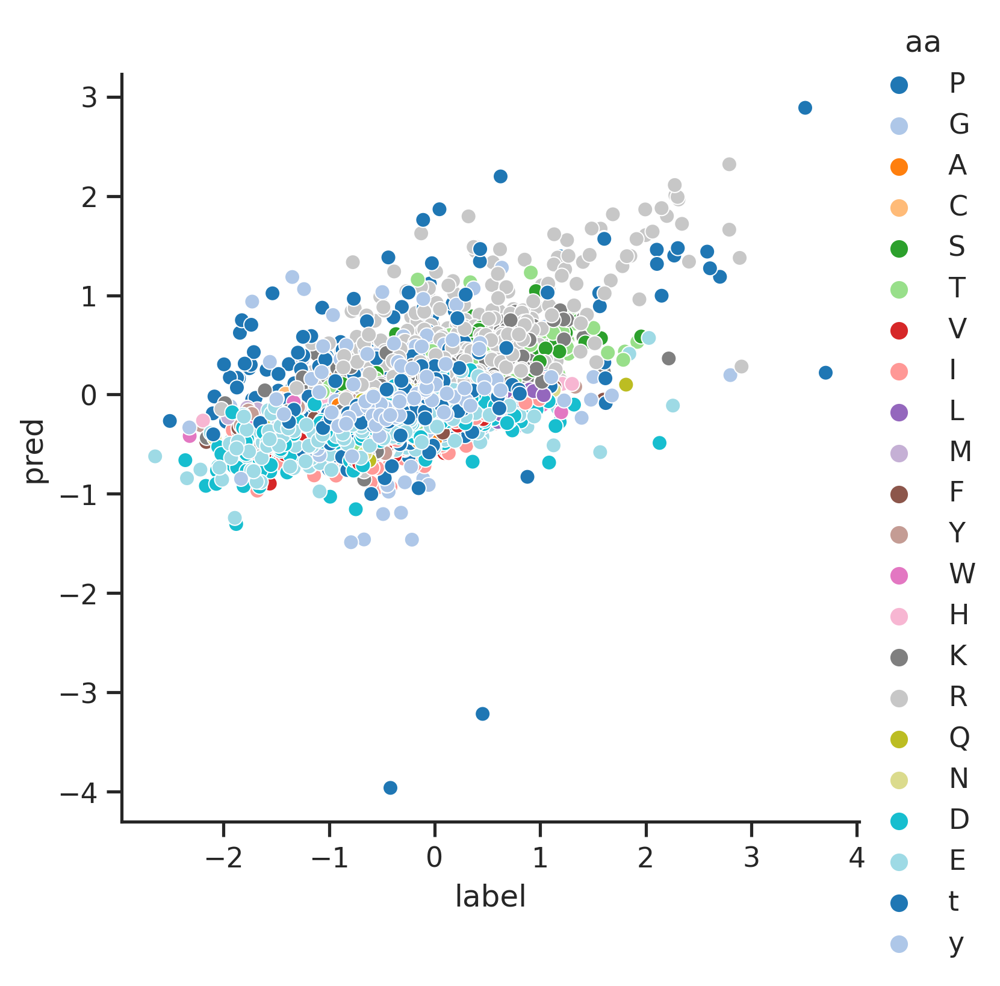

In [ ]:
sns.relplot(x=np.log(pred4.label), y=np.log(pred4.pred), hue = pred4.aa,palette='tab20');

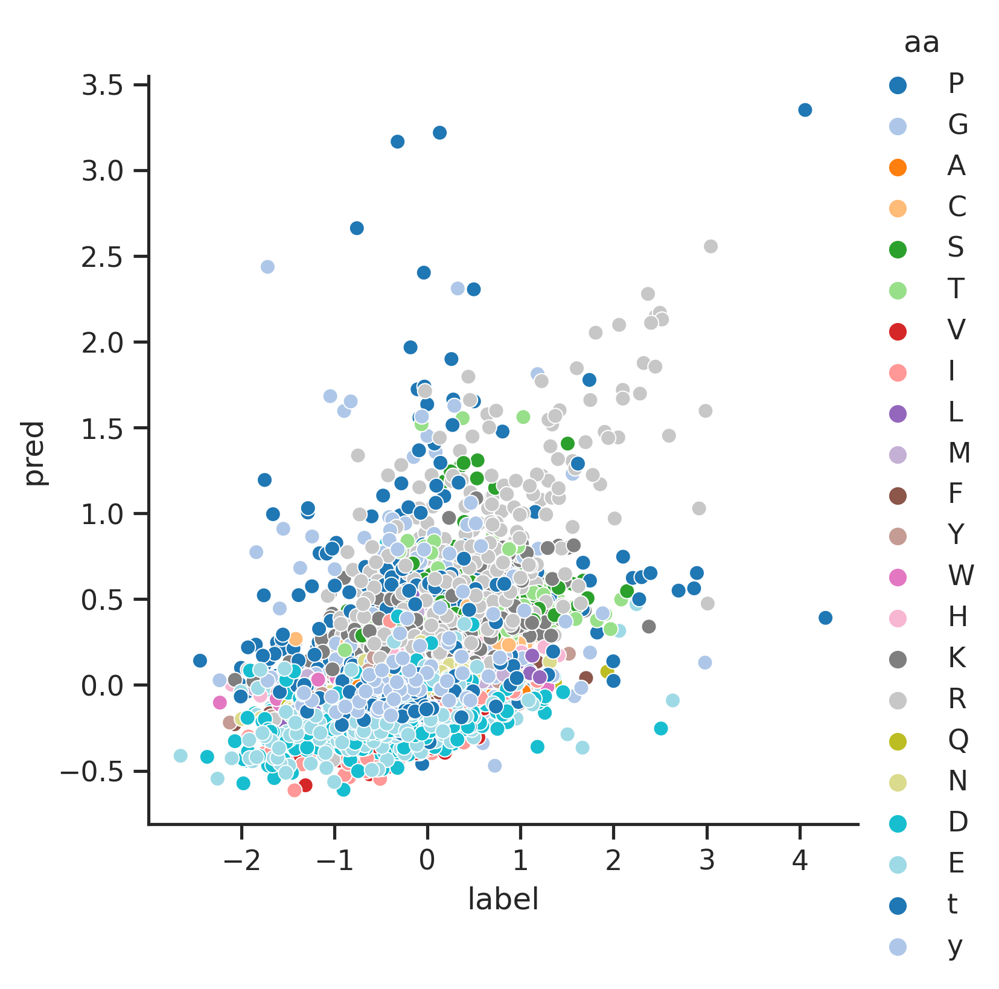

In [ ]:
sns.relplot(x=np.log(pred3.label), y=np.log(pred3.pred), hue = pred3.aa,palette='tab20');

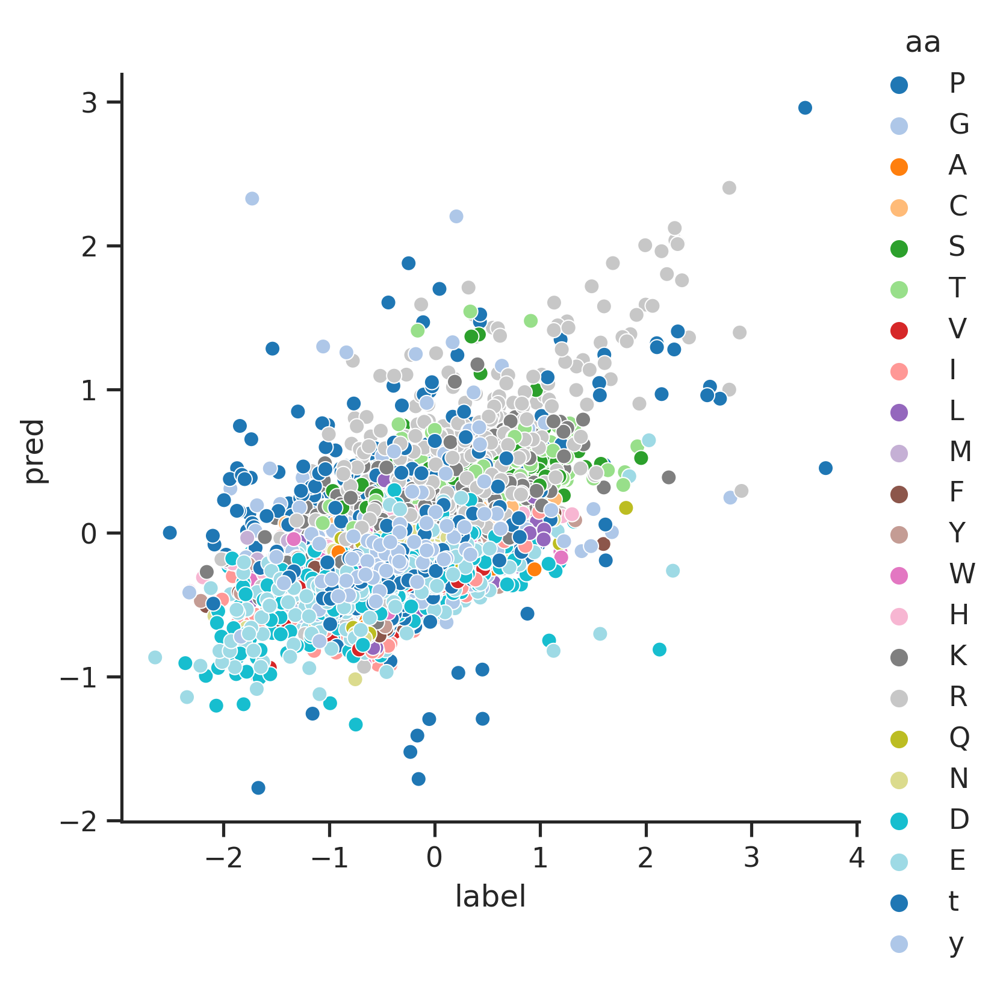

In [ ]:
sns.relplot(x=np.log(pred2.label), y=np.log(pred2.pred), hue = pred2.aa,palette='tab20');

In [ ]:
pred=pred5.copy()

/usr/local/lib/python3.9/dist-packages/pandas/core/arraylike.py:397: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


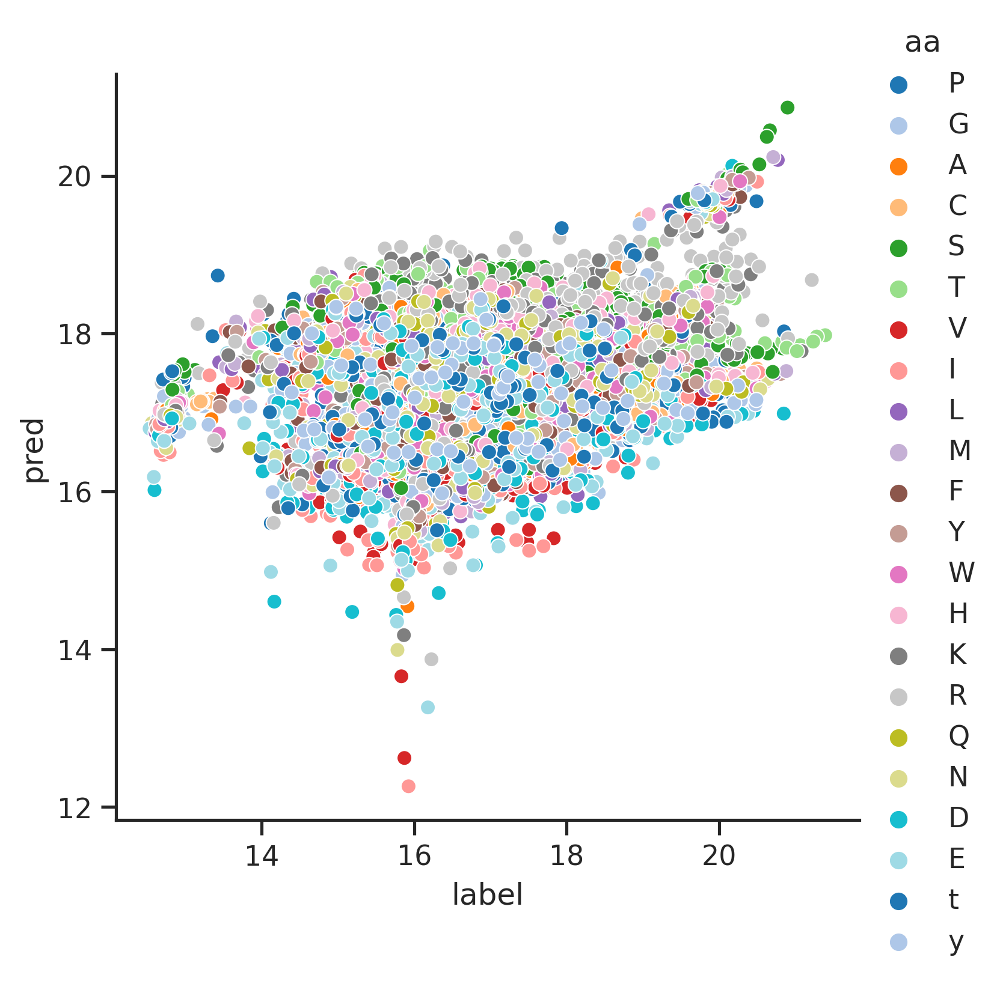

In [ ]:
sns.relplot(x=np.log(pred.label), y=np.log(pred.pred), hue = pred.aa,palette='tab20');

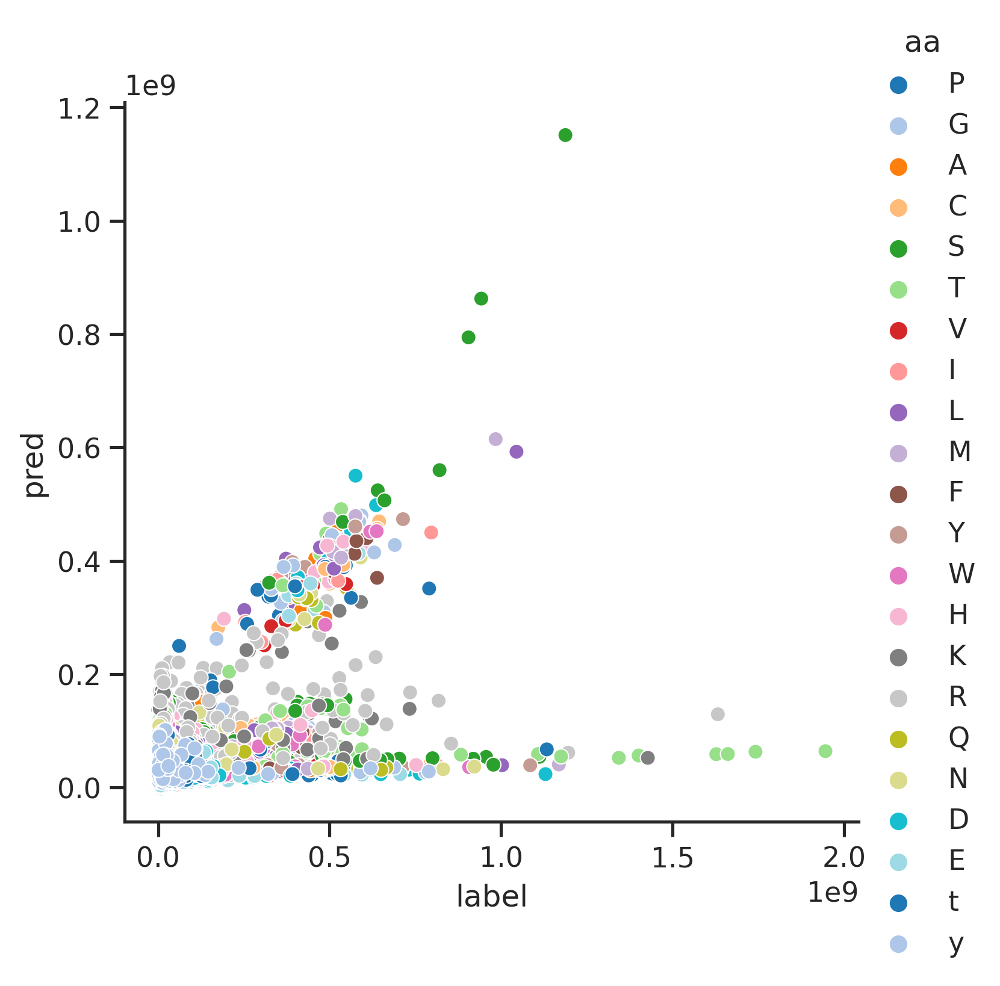

In [ ]:
sns.relplot(x=pred.label, y=pred.pred, hue = pred.aa,palette='tab20');

Check which substrate (position+aa) is favored by the model

In [ ]:
pred.groupby('substrate').pred.mean().sort_values(ascending=False)

substrate
-3R    3.744854
-2R    2.531535
1P     1.814036
-4R    1.626881
2S     1.621584
         ...   
-3V    0.626278
-2I    0.621823
1E     0.613611
-3I    0.611250
1D     0.604923
Name: pred, Length: 198, dtype: float32

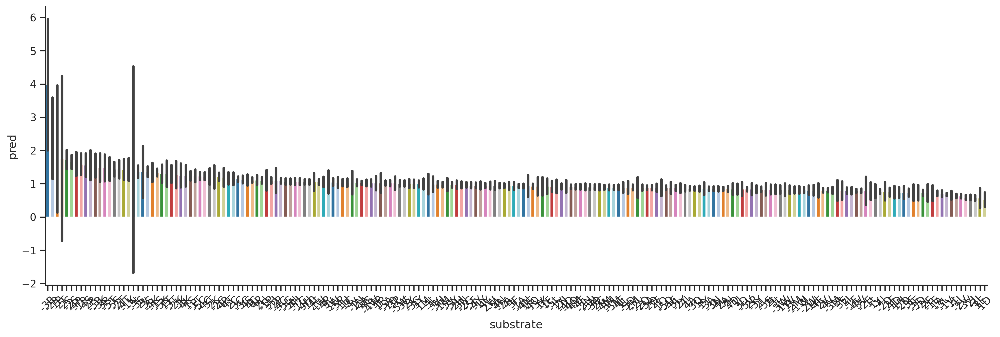

In [ ]:
plot_bar(pred, 'pred','substrate', circle = False)

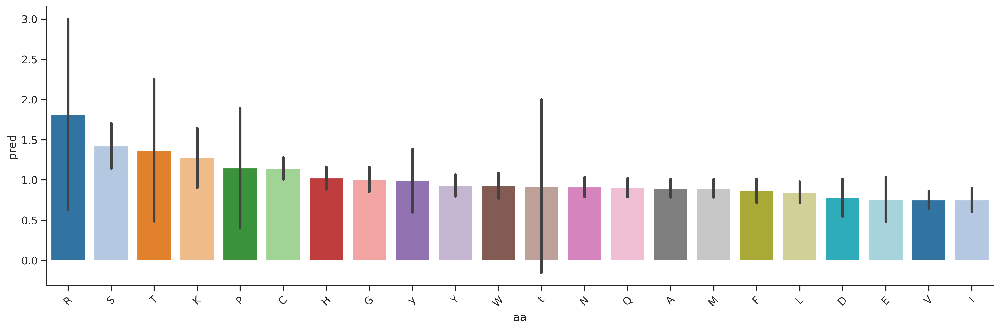

In [ ]:
plot_bar(pred, 'pred','aa', circle = False)

## Analysis Pearson

In [ ]:
pred.groupby('kinase')[['label','pred']].corr()

label      pred
kinase                          
AAK1   label  1.000000  0.719353
       pred   0.719353  1.000000
AKT3   label  1.000000  0.965673
       pred   0.965673  1.000000
AMPKA2 label  1.000000  0.823987
...                ...       ...
TTBK2  pred   0.407274  1.000000
WNK3   label  1.000000  0.475506
       pred   0.475506  1.000000
YSK1   label  1.000000  0.781982
       pred   0.781982  1.000000

[122 rows x 2 columns]

In [ ]:
pred.groupby('kinase')[['label','pred']].corr()

label      pred
kinase                          
AAK1   label  1.000000  0.254565
       pred   0.254565  1.000000
AKT3   label  1.000000  0.960784
       pred   0.960784  1.000000
AMPKA2 label  1.000000  0.767173
...                ...       ...
TTBK2  pred   0.337952  1.000000
WNK3   label  1.000000  0.433491
       pred   0.433491  1.000000
YSK1   label  1.000000  0.744658
       pred   0.744658  1.000000

[122 rows x 2 columns]

In [ ]:
pearson = pred.groupby('kinase')[['label','pred']].corr().pred.loc[::2].reset_index()

In [ ]:
# Get the absolute value of pearson correlation, and name the column pearson
pearson['pearson'] = abs(pearson.pred)

In [ ]:
pearson.head()

,kinase,level_1,pred,pearson
0,AAK1,label,0.719353,0.719353
1,AKT3,label,0.965673,0.965673
2,AMPKA2,label,0.823987,0.823987
3,AURA,label,0.612266,0.612266
4,BMPR1A,label,0.837638,0.837638


Collect information for this df

In [ ]:
pearson = pearson.merge(kinase_info, 'left')

In [ ]:
pearson.head()

,kinase,level_1,pred,pearson,Family,category,category_big
0,AAK1,label,0.719353,0.719353,Other,NAK,NAK
1,AKT3,label,0.965673,0.965673,AGC,AKT/ROCK,basophilic
2,AMPKA2,label,0.823987,0.823987,CAMK,AMPK,basophilic
3,AURA,label,0.612266,0.612266,Other,AURK/PKA,basophilic
4,BMPR1A,label,0.837638,0.837638,TKL,TGFBR,acidophilic


In [ ]:
pearson.head()

,kinase,level_1,pred,pearson,Family,category,category_big
0,AAK1,label,0.719353,0.719353,Other,NAK,NAK
1,AKT3,label,0.965673,0.965673,AGC,AKT/ROCK,basophilic
2,AMPKA2,label,0.823987,0.823987,CAMK,AMPK,basophilic
3,AURA,label,0.612266,0.612266,Other,AURK/PKA,basophilic
4,BMPR1A,label,0.837638,0.837638,TKL,TGFBR,acidophilic


In [ ]:
print(f'The average pearson value across kinases in valid set is : {pearson.pearson.mean().round(4)}')

The average pearson value across kinases in valid set is : 0.6559


In [ ]:
print(f'The average pearson value across kinases in valid set is : {pearson.pearson.mean().round(4)}')

The average pearson value across kinases in valid set is : 0.6015


In [ ]:
print(f'The average pearson value across kinases in valid set is : {pearson.pearson.mean().round(4)}')

The average pearson value across kinases in valid set is : 0.5797


In [ ]:
print(f'The average pearson value across kinases in valid set is : {pearson.pearson.mean().round(4)}')

The average pearson value across kinases in valid set is : 0.4918


In [ ]:
print(f'The average pearson value across kinases in valid set is : {pearson.pearson.mean().round(4)}')

The average pearson value across kinases in valid set is : 0.5651


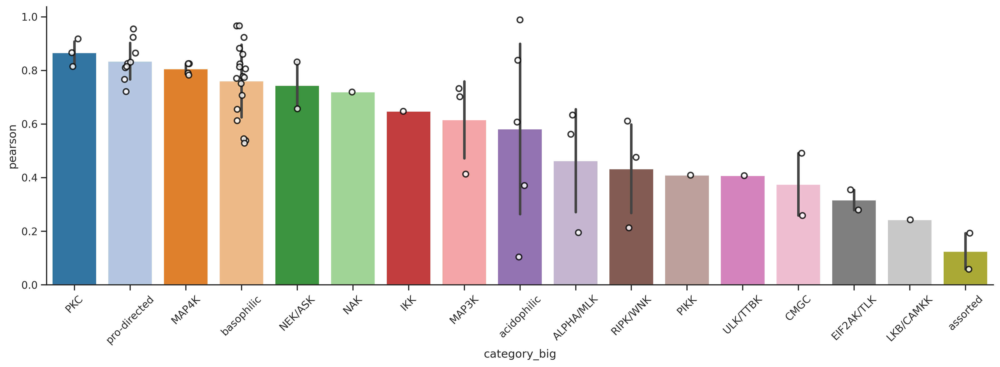

In [ ]:
plot_bar(pearson,'pearson','category_big')

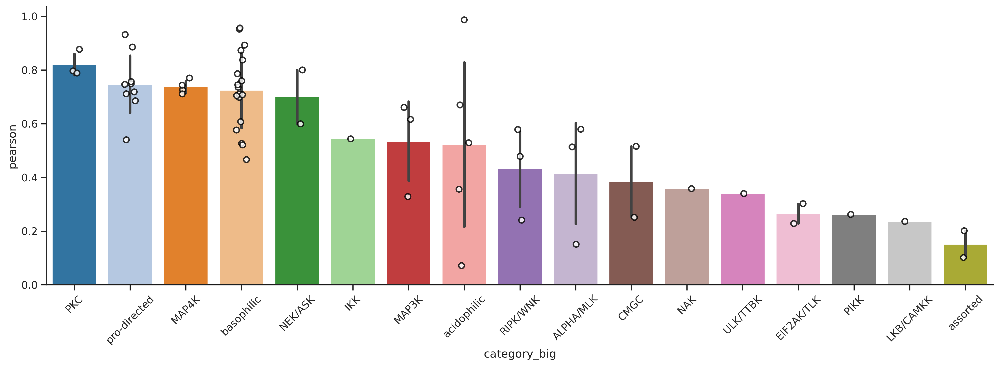

In [ ]:
plot_bar(pearson,'pearson','category_big')

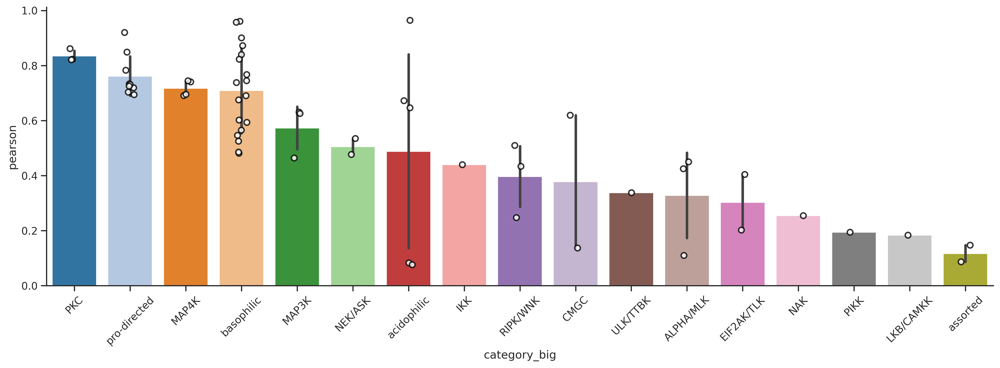

In [ ]:
plot_bar(pearson,'pearson','category_big')

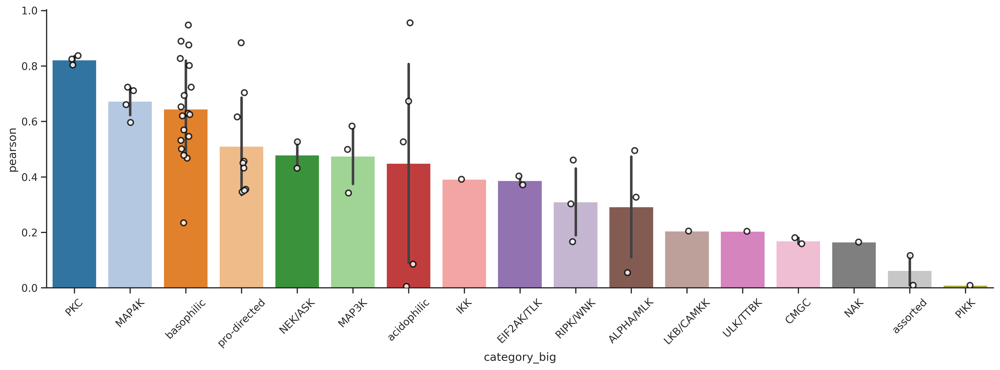

In [ ]:
plot_bar(pearson,'pearson','category_big')

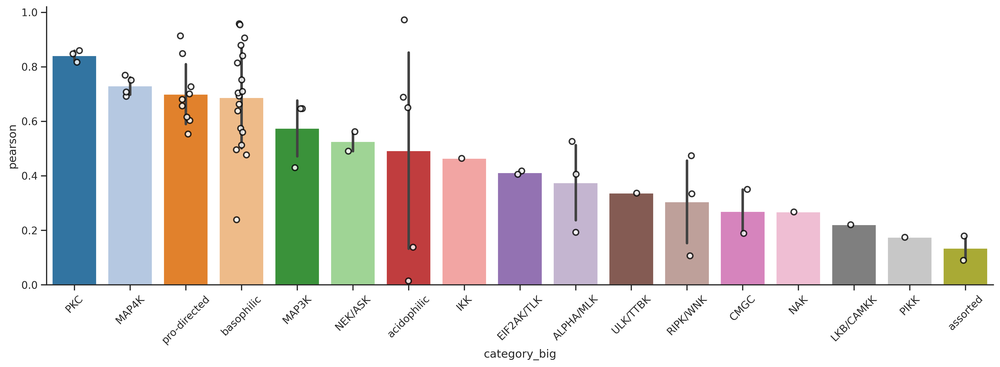

In [ ]:
plot_bar(pearson,'pearson','category_big')

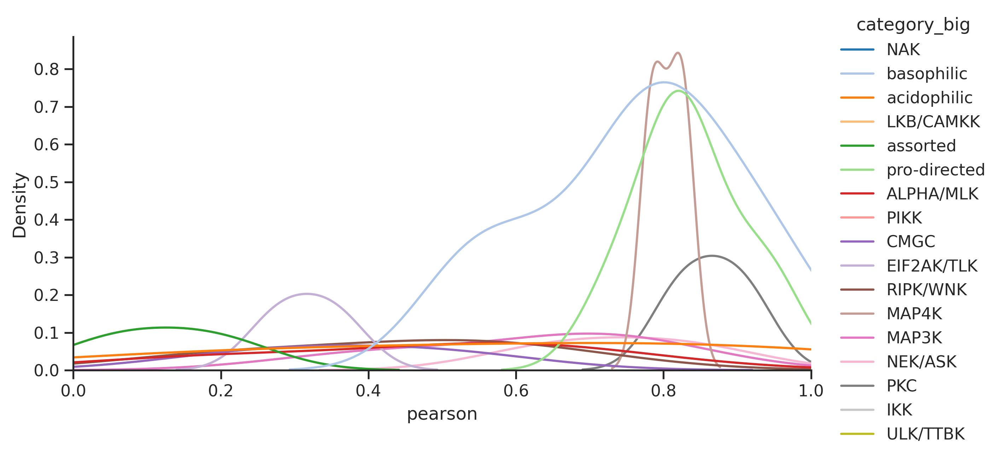

In [ ]:
sns.displot(pearson,
            x = 'pearson',
            aspect=2,
            kind='kde',
            hue = 'category_big',
            palette = 'tab20',
            height=4,
            warn_singular=False
           ).set(xlim=(0,1));

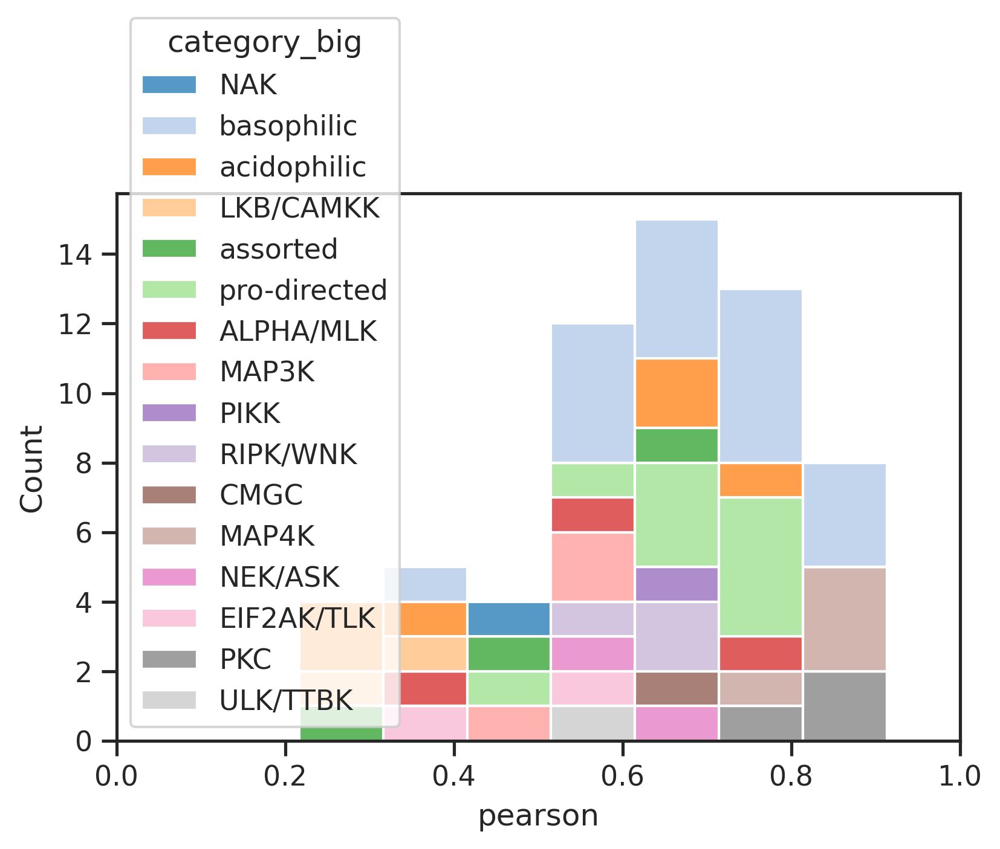

In [ ]:
sns.histplot(data=pearson,
             x='pearson',
             hue='category_big',
             palette='tab20',
             multiple='stack',
            ).set(xlim=(0, 1));

## Individual Kinase

In [ ]:
max_group = pearson.groupby('category_big').apply(lambda r: r.loc[r['pearson'].idxmax()]).reset_index(drop=True).sort_values('pearson',ascending=False)

In [ ]:
min_group = pearson.groupby('category_big').apply(lambda r: r.loc[r['pearson'].idxmin()]).reset_index(drop=True).sort_values('pearson',ascending=False)

In [ ]:
min_group

,kinase,level_1,pred,pearson,Family,category,category_big
10,PKN1,label,0.814304,0.814304,AGC,PKC,PKC
6,YSK1,label,0.781982,0.781982,STE,MAP4K,MAP4K
16,CDK7,label,0.720691,0.720691,CMGC,CDK_II,pro-directed
7,AAK1,label,0.719353,0.719353,Other,NAK,NAK
8,NEK4,label,0.656457,0.656457,Other,NEK/ASK,NEK/ASK
3,TBK1,label,0.647553,0.647553,Other,IKK,IKK
15,SSTK,label,0.528161,0.528161,CAMK,AMPK,basophilic
5,STLK3,label,0.412911,0.412911,STE,MAP3K,MAP3K
9,DNAPK,label,0.409192,0.409192,PIKK,PIKK,PIKK
12,TTBK2,label,0.407274,0.407274,CK1,ULK/TTBK,ULK/TTBK


In [ ]:
max_group

,kinase,level_1,pred,pearson,Family,category,category_big
13,CK1D,label,0.988247,0.988247,CK1,CK1,acidophilic
15,MRCKB,label,0.966006,0.966006,AGC,AKT/ROCK,basophilic
16,CLK4,label,0.954368,0.954368,CMGC,SRPK/CLK,pro-directed
10,PKCH,label,0.917253,0.917253,AGC,PKC,PKC
8,MEKK6,label,0.831186,0.831186,STE,NEK/ASK,NEK/ASK
6,TAO2,label,0.824952,0.824952,STE,MAP4K,MAP4K
5,MST2,label,0.732020,0.732020,STE,MAP3K,MAP3K
7,AAK1,label,0.719353,0.719353,Other,NAK,NAK
3,TBK1,label,0.647553,0.647553,Other,IKK,IKK
0,MLK4,label,0.633195,0.633195,STE,ALPHA/MLK,ALPHA/MLK


In [ ]:
max_group

,kinase,level_1,pred,pearson,Family,category,category_big
13,CK1D,label,0.986580,0.986580,CK1,CK1,acidophilic
15,MRCKB,label,0.956341,0.956341,AGC,AKT/ROCK,basophilic
16,CLK4,label,0.931703,0.931703,CMGC,SRPK/CLK,pro-directed
10,PKCH,label,0.876847,0.876847,AGC,PKC,PKC
8,MEKK6,label,0.800130,0.800130,STE,NEK/ASK,NEK/ASK
6,KHS2,label,0.770012,0.770012,STE,MAP4K,MAP4K
5,MEK5,label,0.660642,0.660642,STE,MAP3K,MAP3K
0,PKR,label,0.579258,0.579258,Other,ALPHA/MLK,ALPHA/MLK
11,RIPK3,label,0.578184,0.578184,TKL,RIPK/WNK,RIPK/WNK
3,TBK1,label,0.543653,0.543653,Other,IKK,IKK


### Max group

------CK1D------
Logo of CK1D  from raw dataset


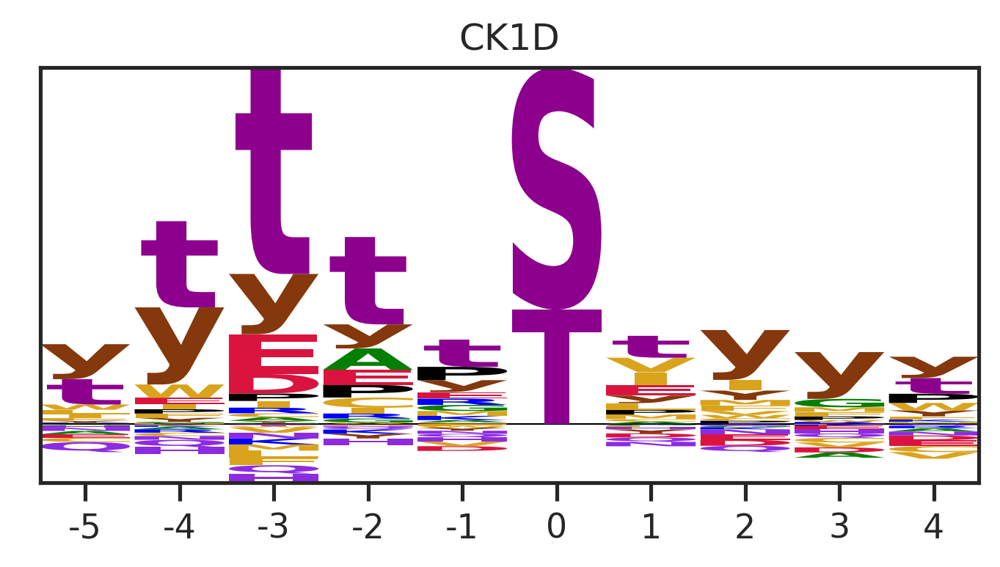

Logo of CK1D  from reversed label


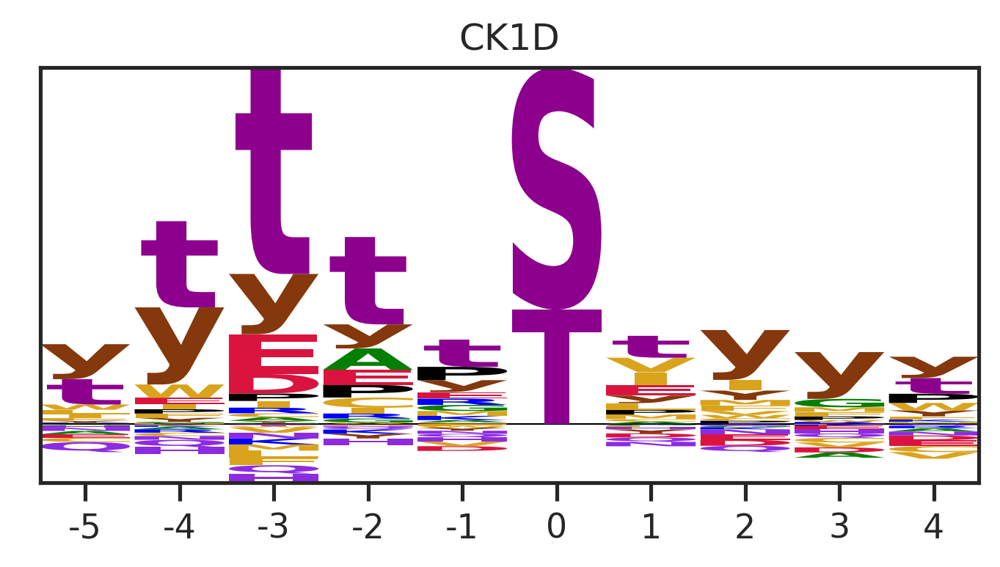

Logo of CK1D  based on prediction


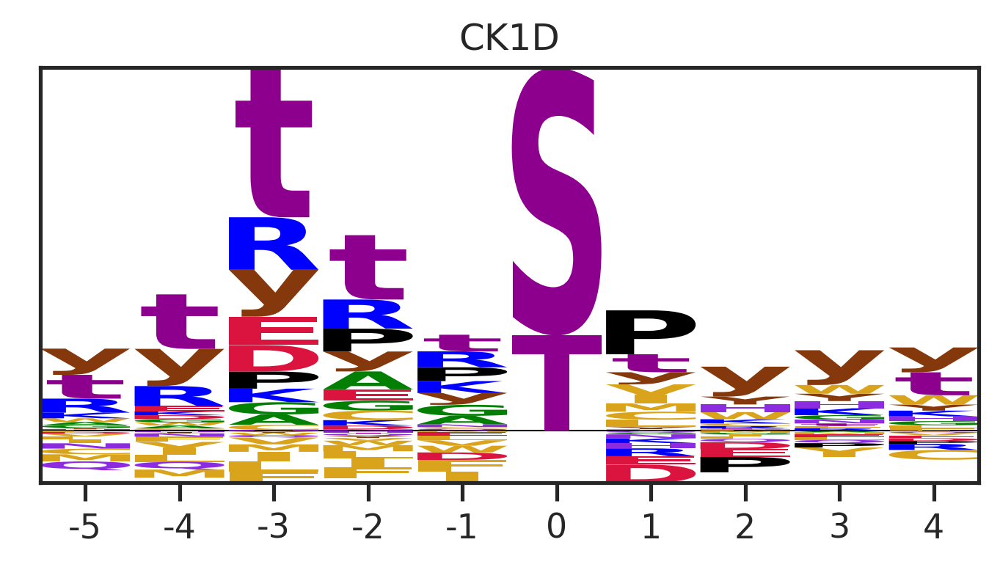

correlation


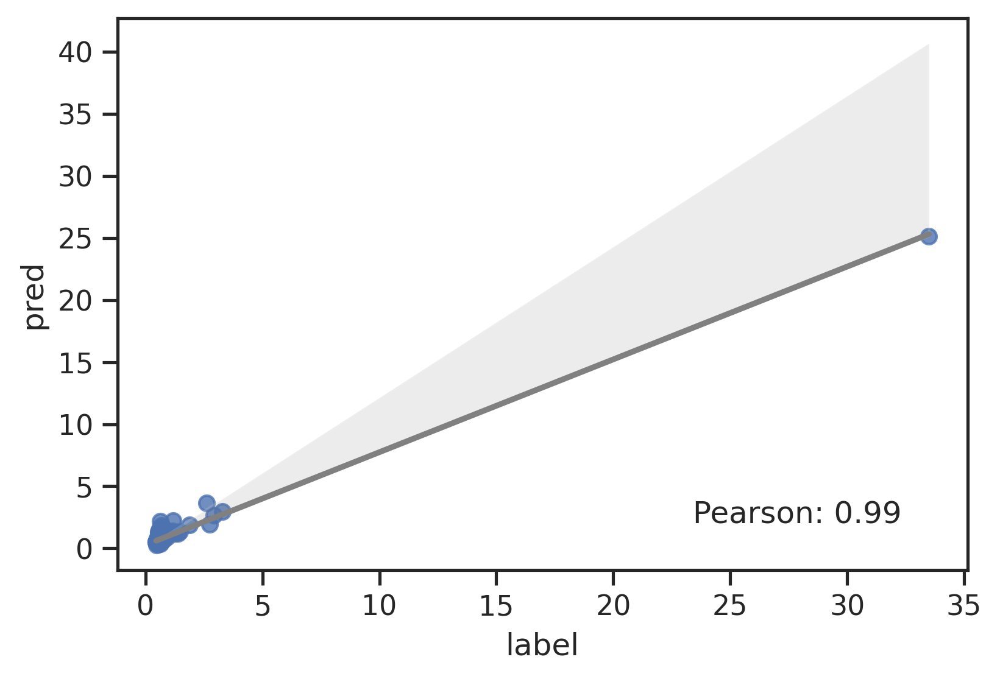

colored by aa


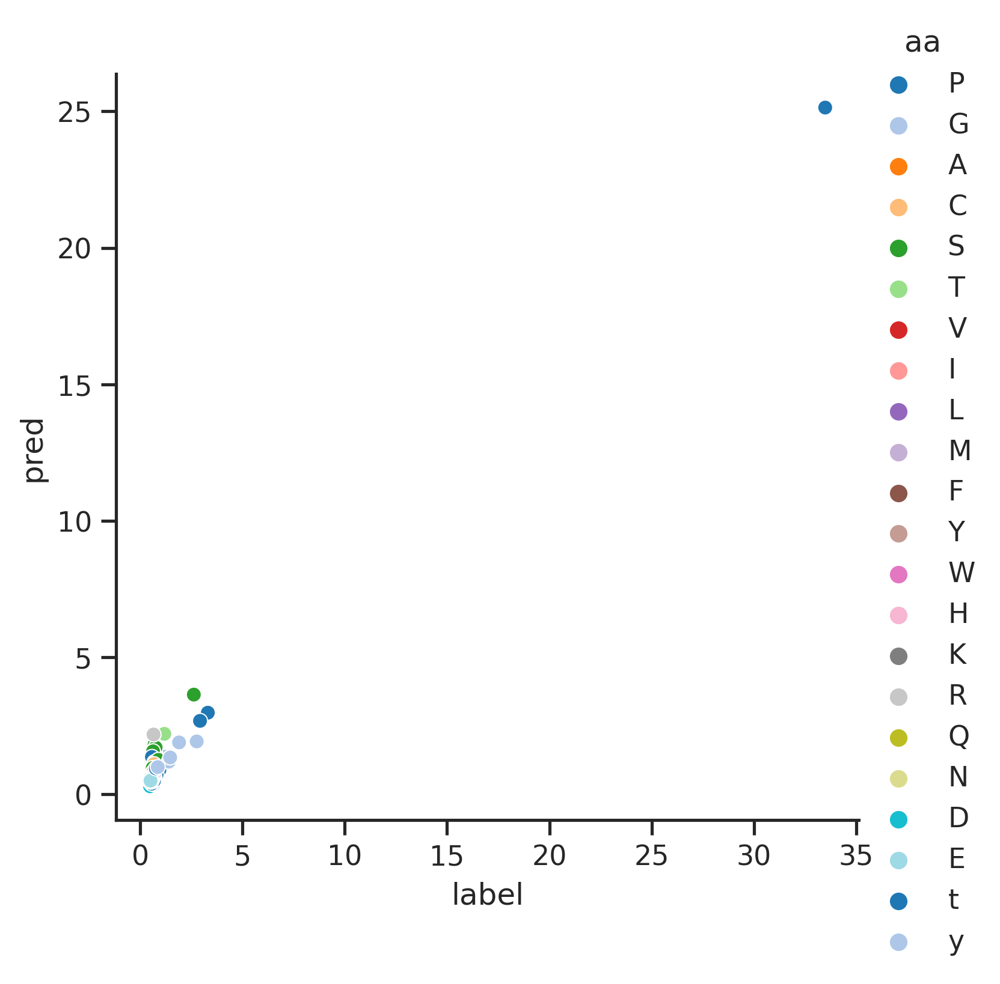

------MRCKB------
Logo of MRCKB  from raw dataset


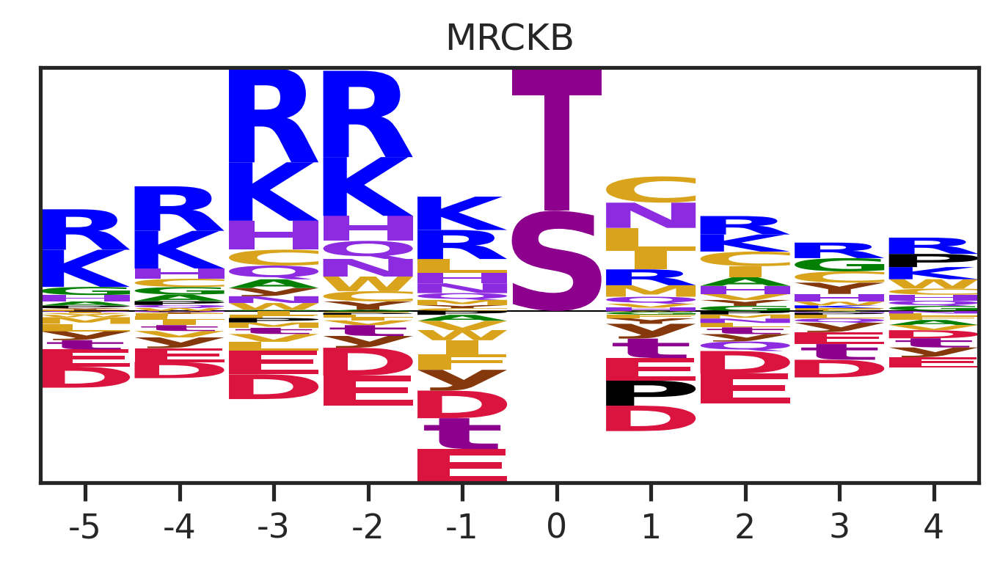

Logo of MRCKB  from reversed label


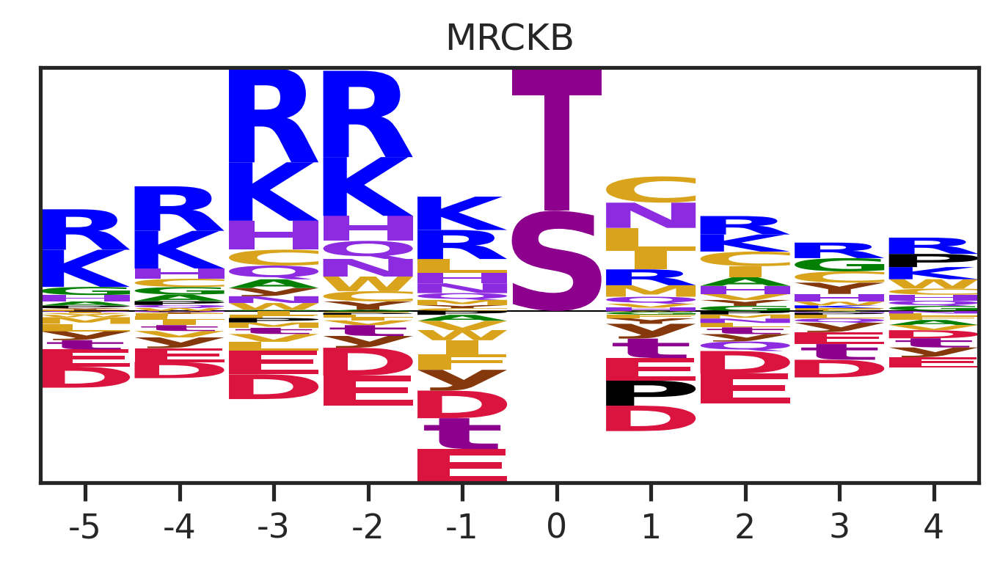

Logo of MRCKB  based on prediction


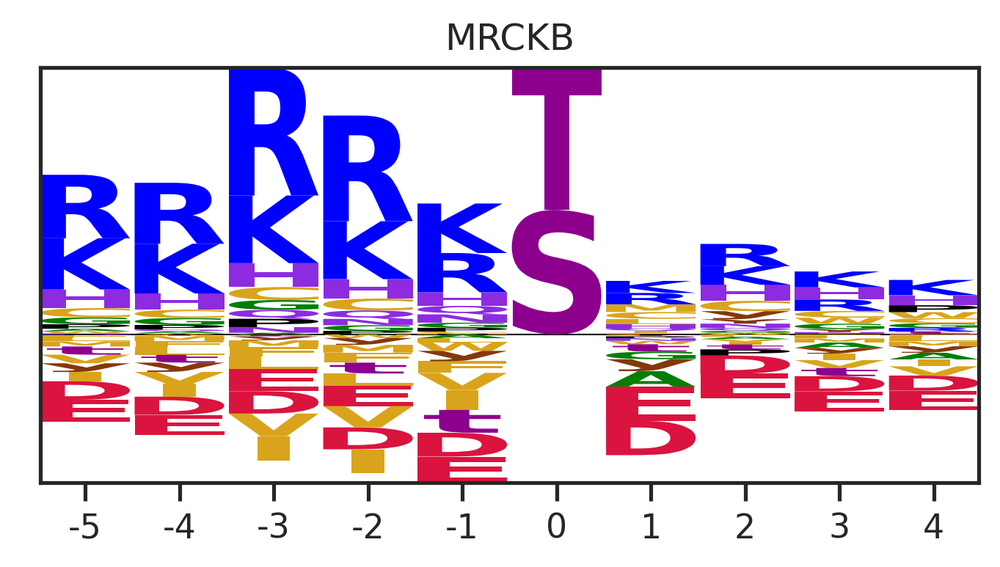

correlation


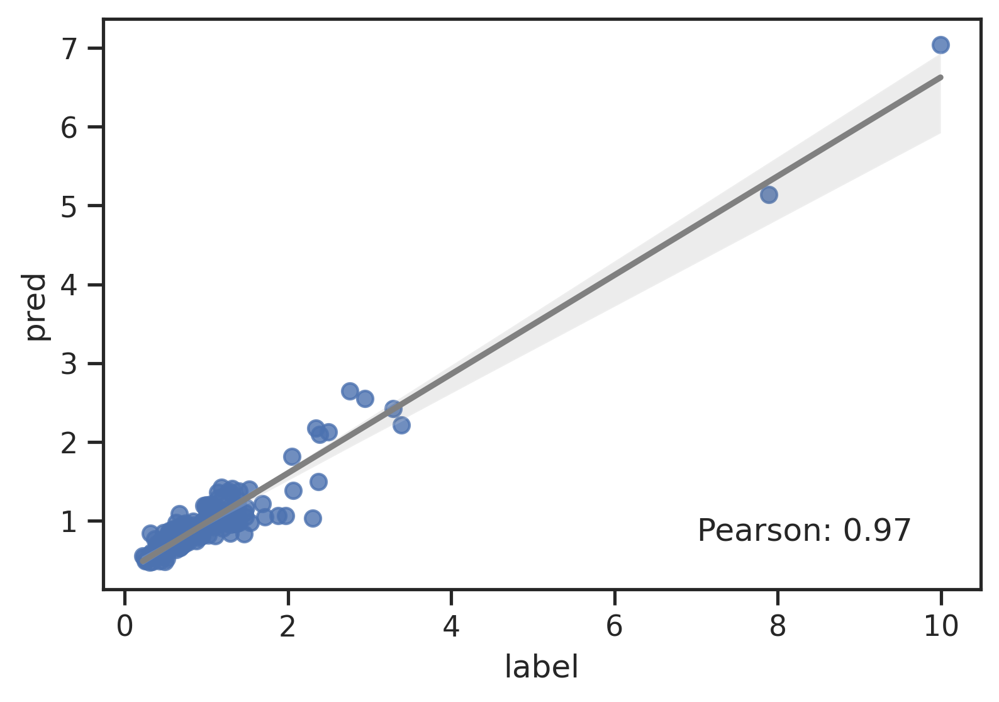

colored by aa


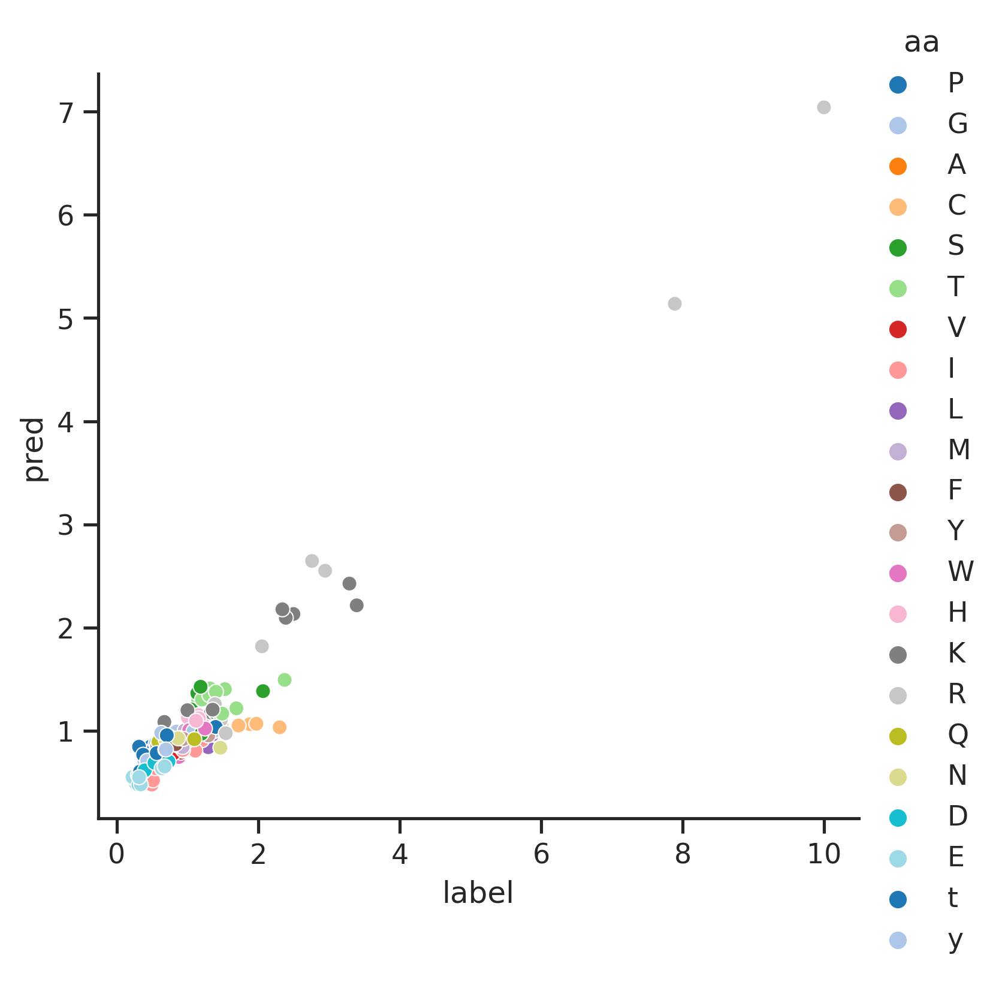

------CLK4------
Logo of CLK4  from raw dataset


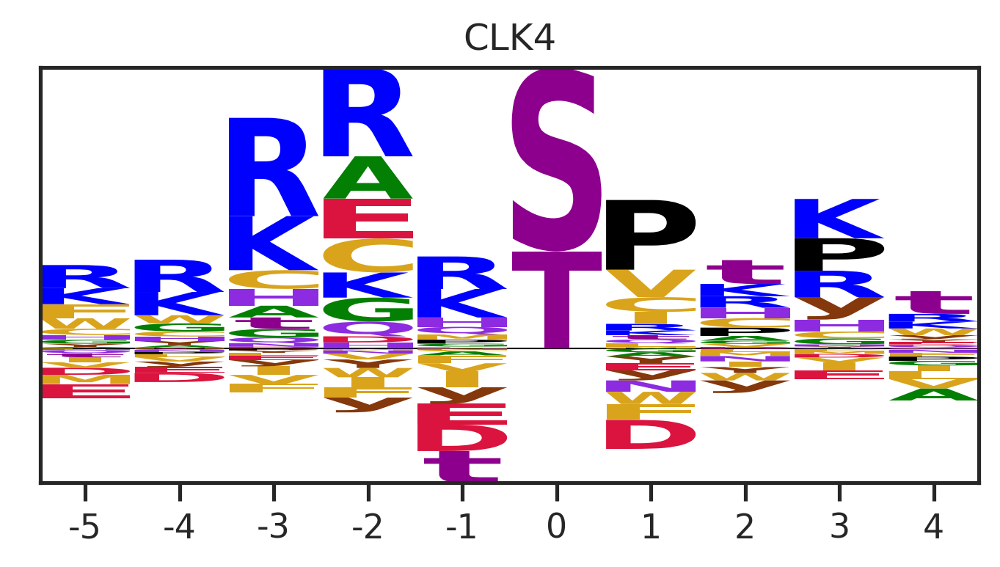

Logo of CLK4  from reversed label


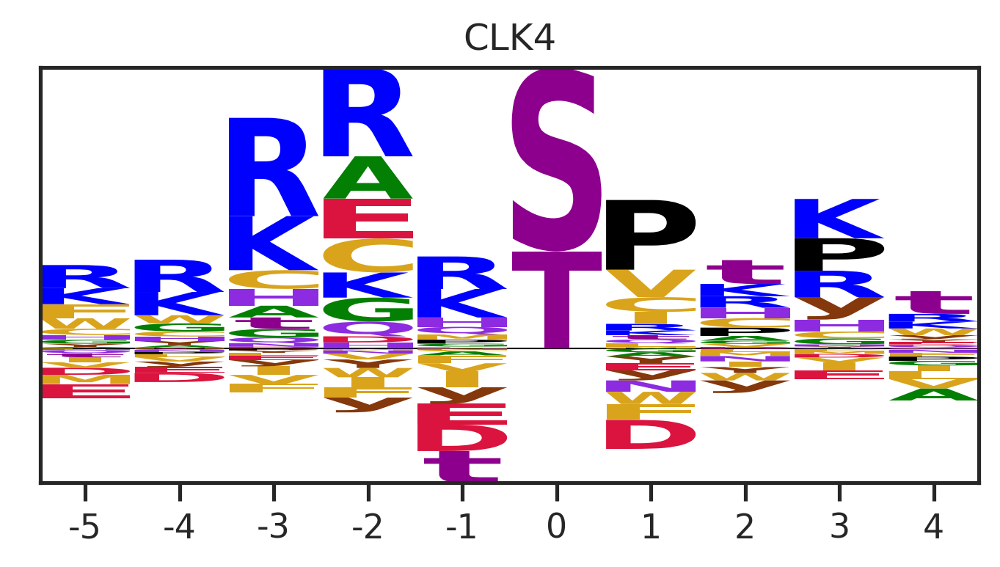

Logo of CLK4  based on prediction


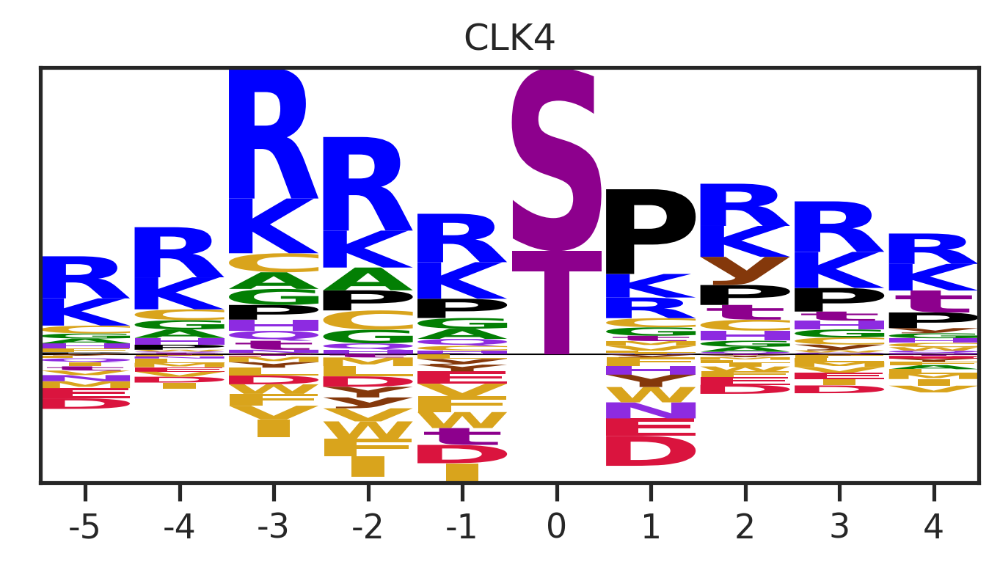

correlation


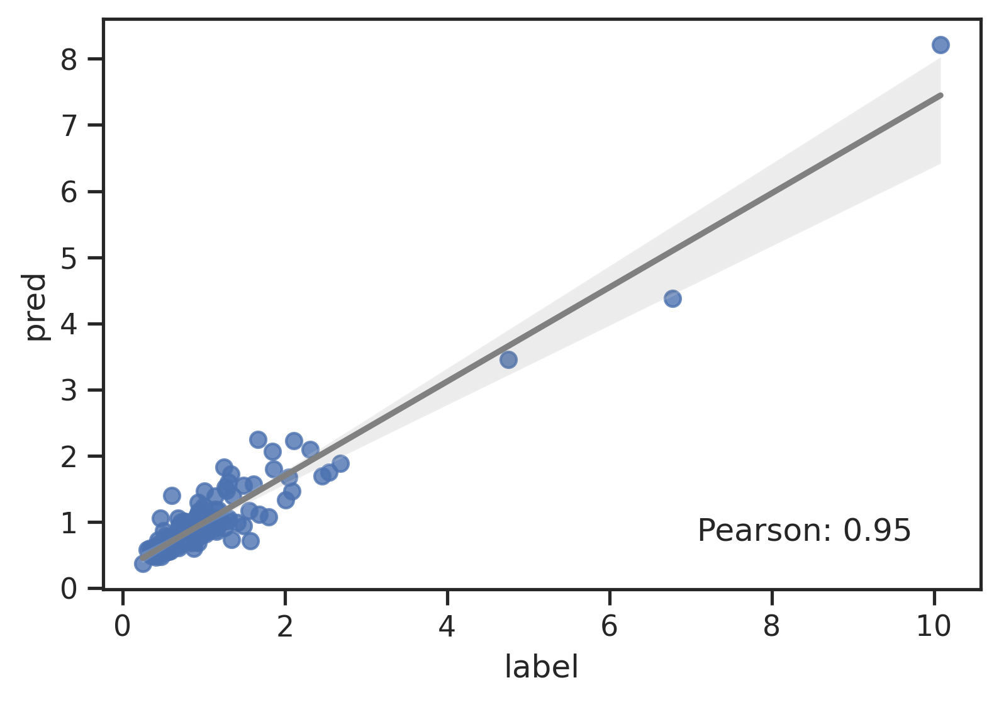

colored by aa


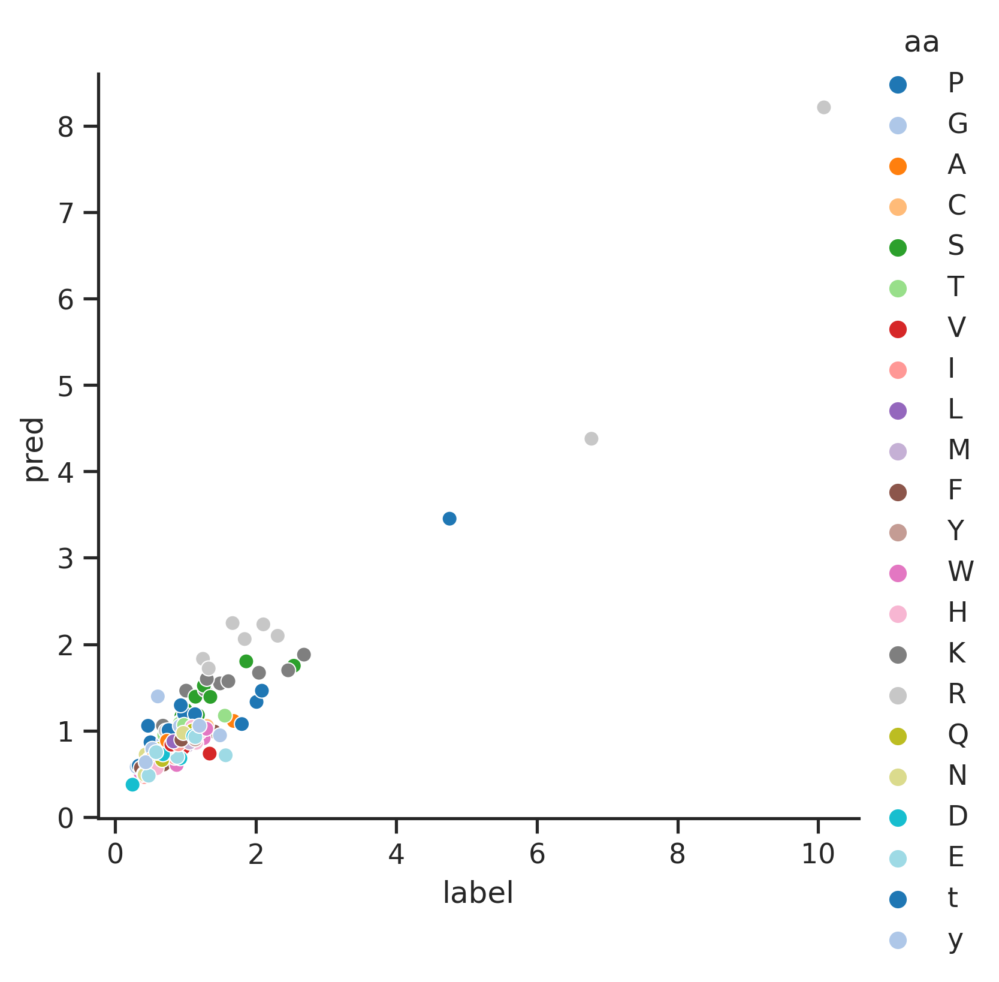

------PKCH------
Logo of PKCH  from raw dataset


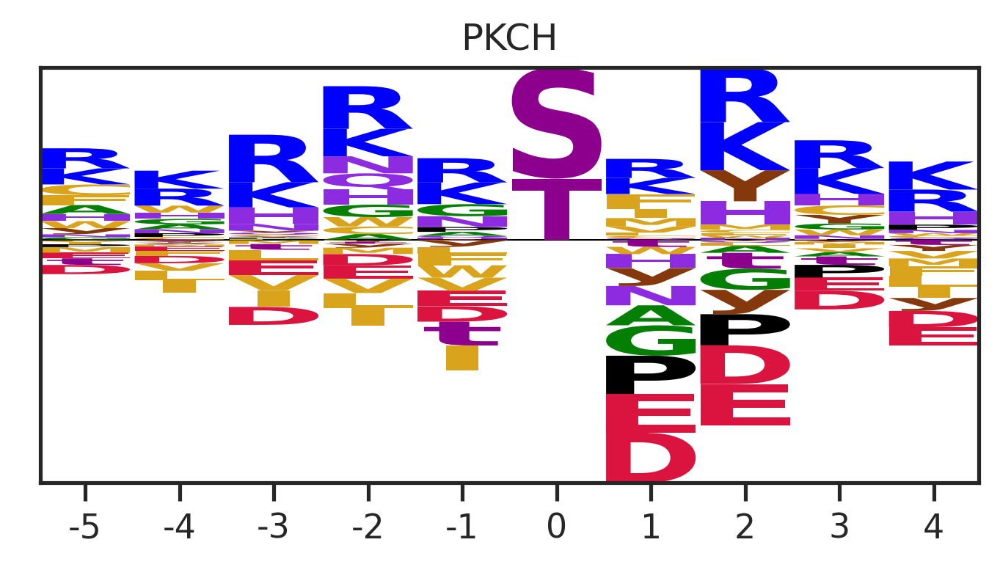

Logo of PKCH  from reversed label


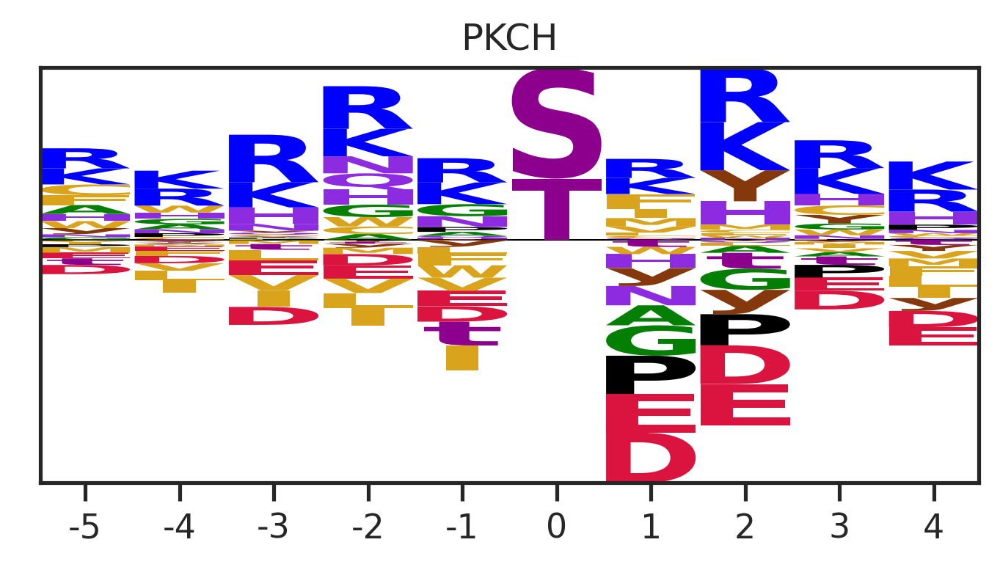

Logo of PKCH  based on prediction


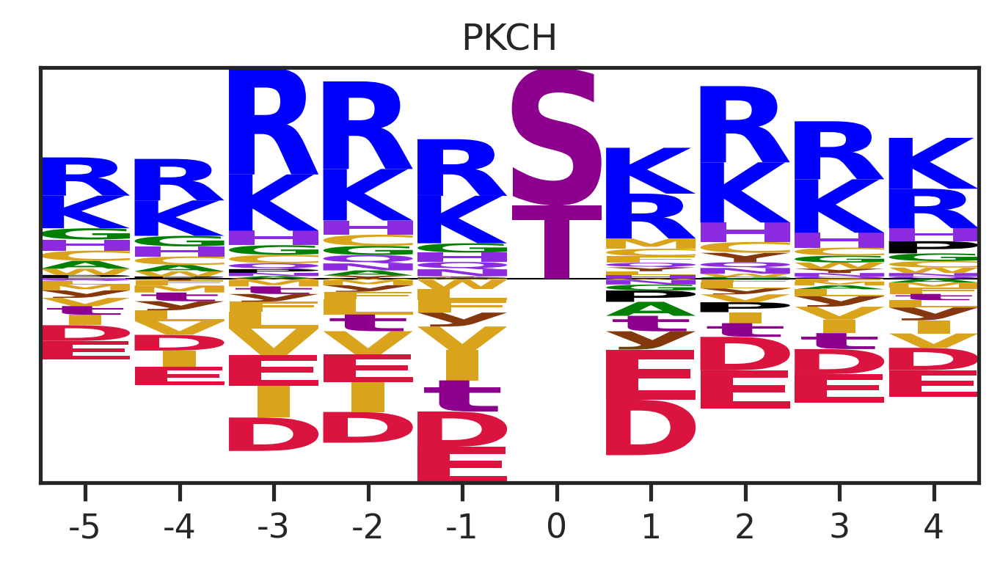

correlation


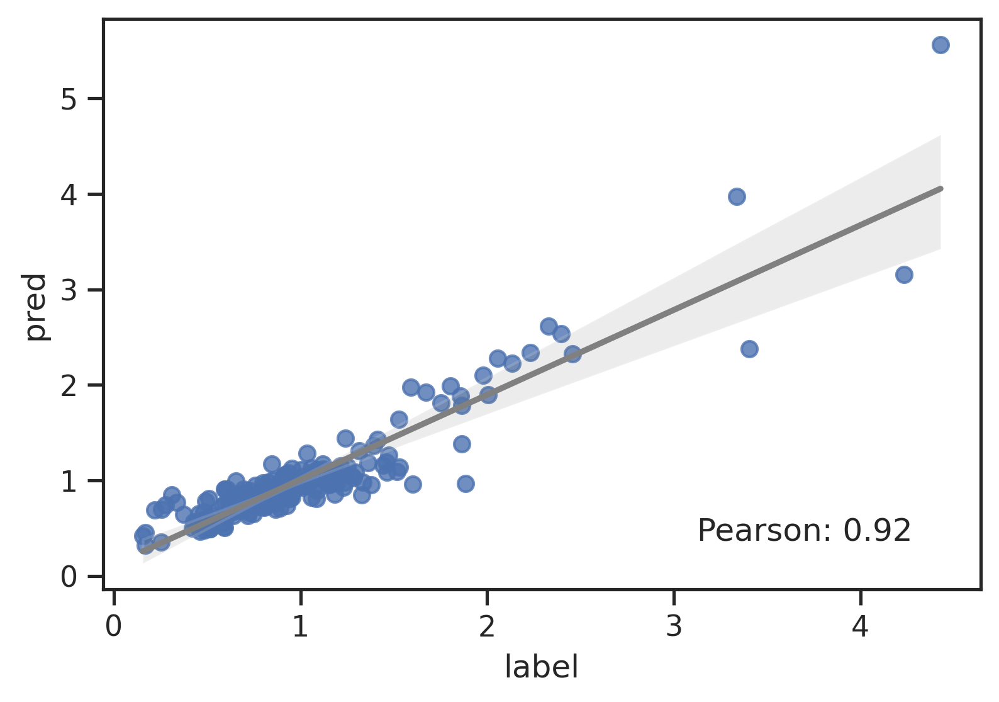

colored by aa


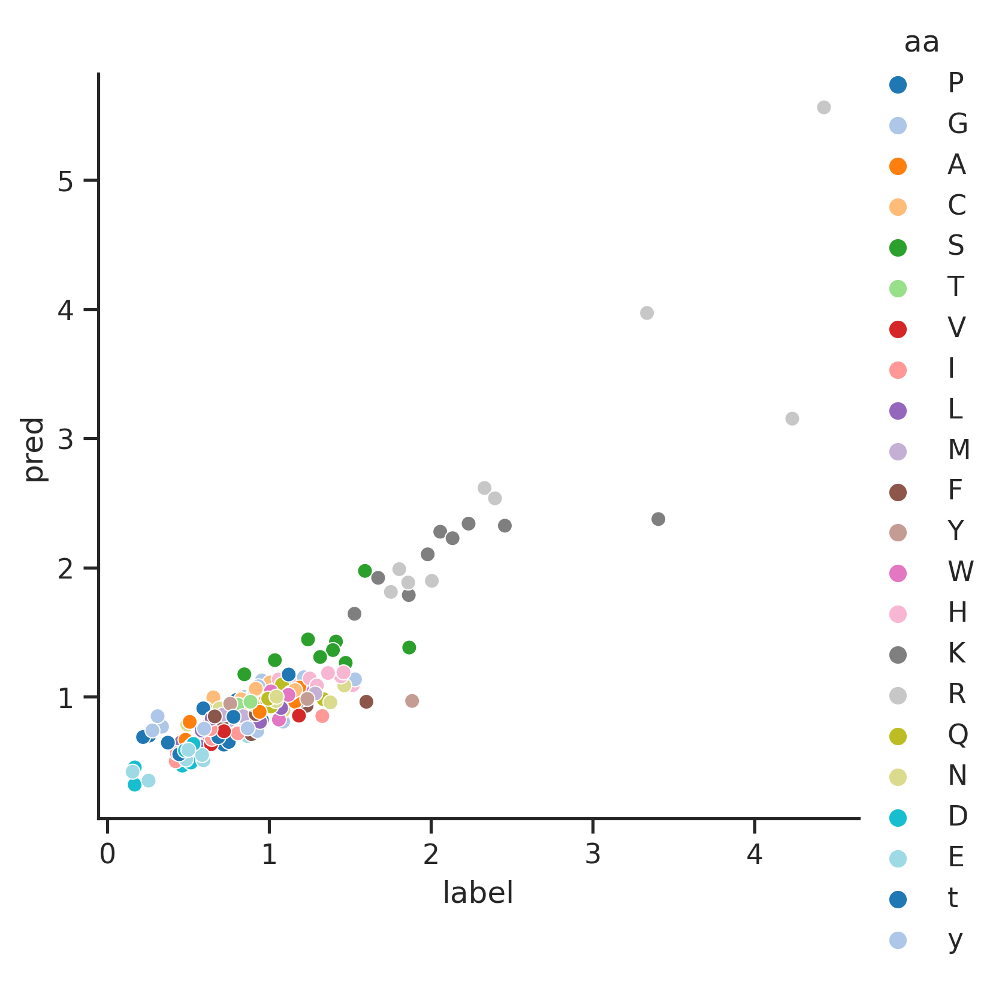

------MEKK6------
Logo of MEKK6  from raw dataset


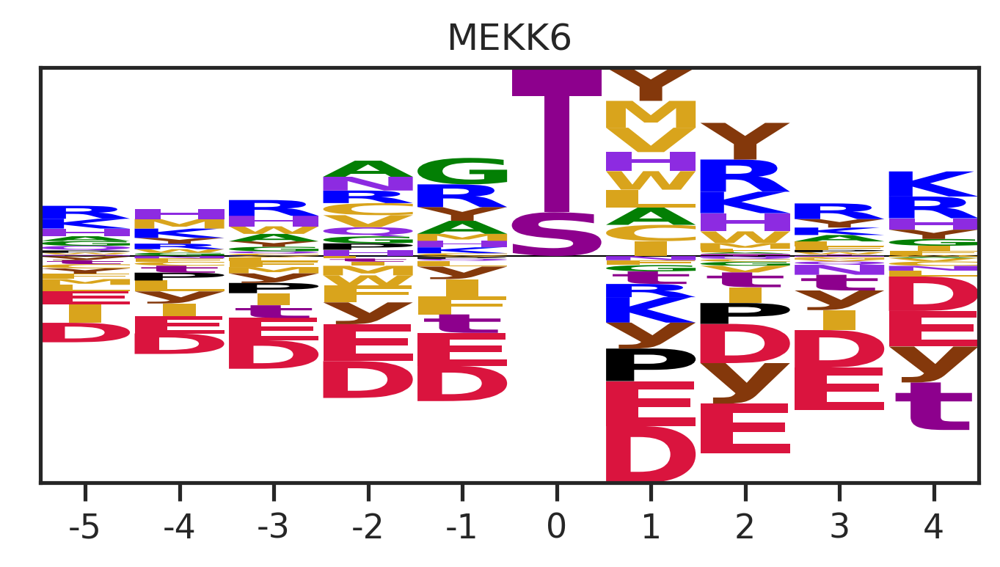

Logo of MEKK6  from reversed label


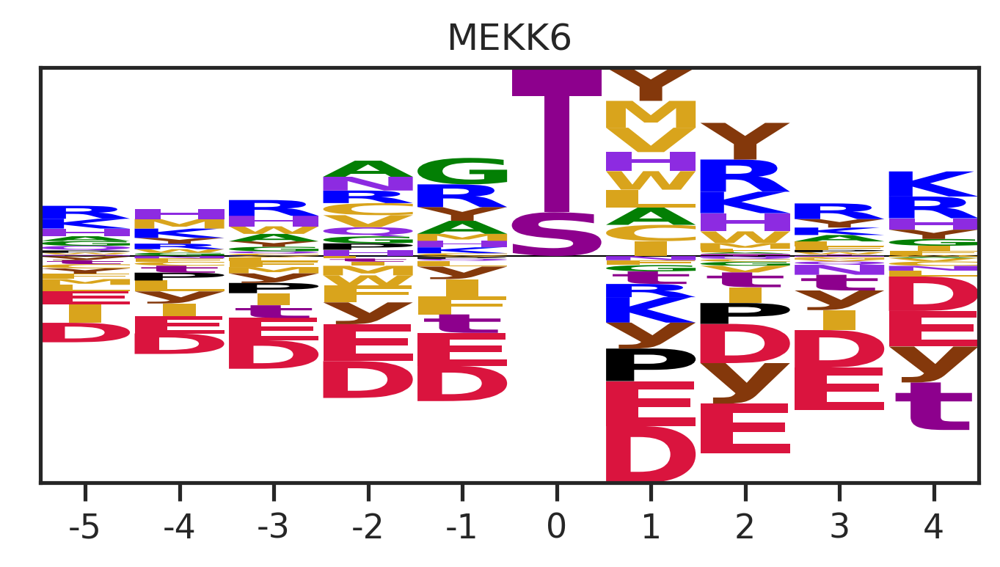

Logo of MEKK6  based on prediction


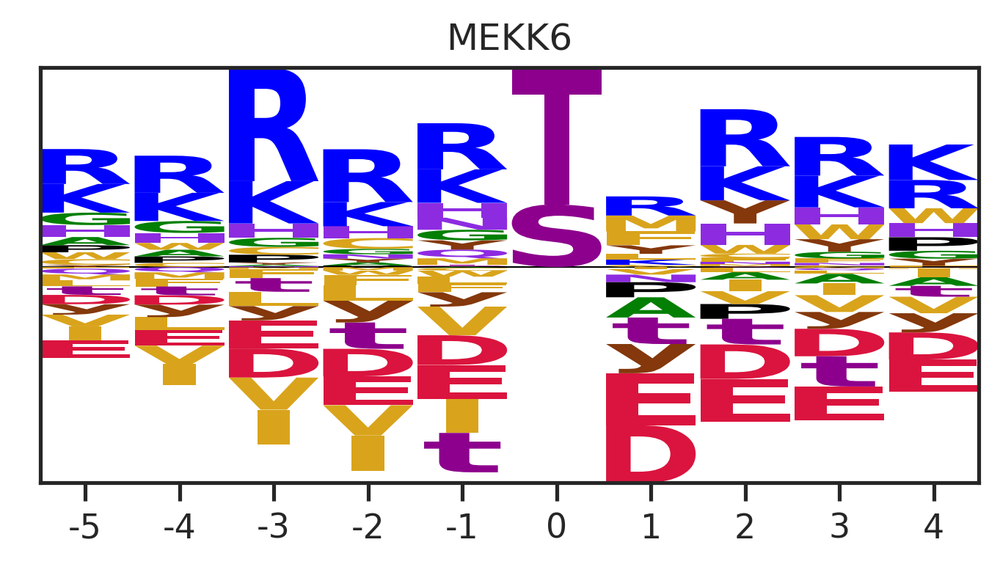

correlation


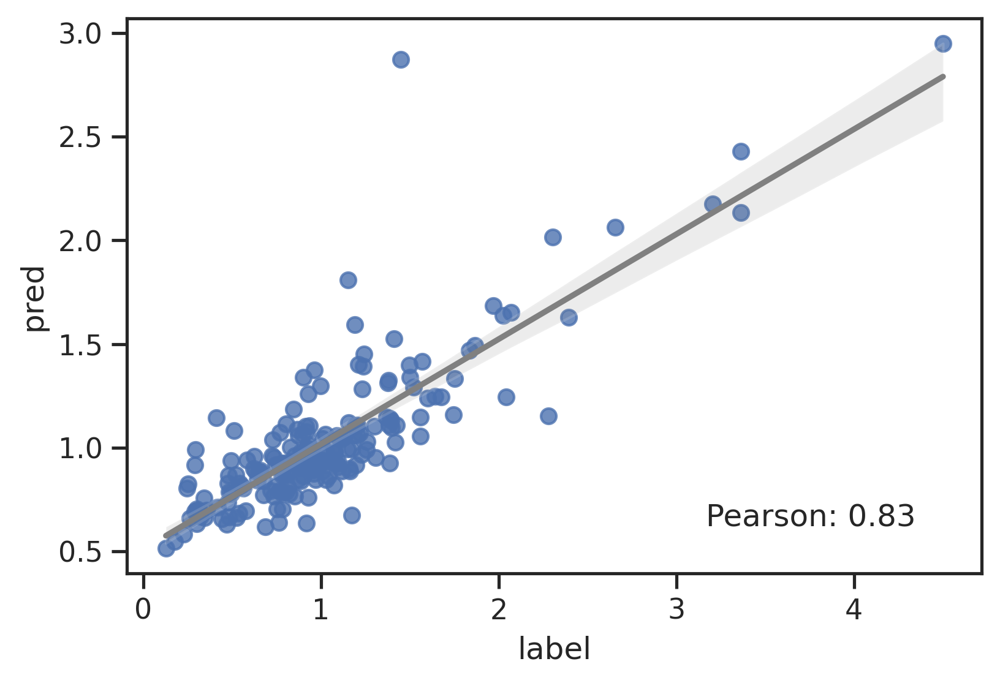

colored by aa


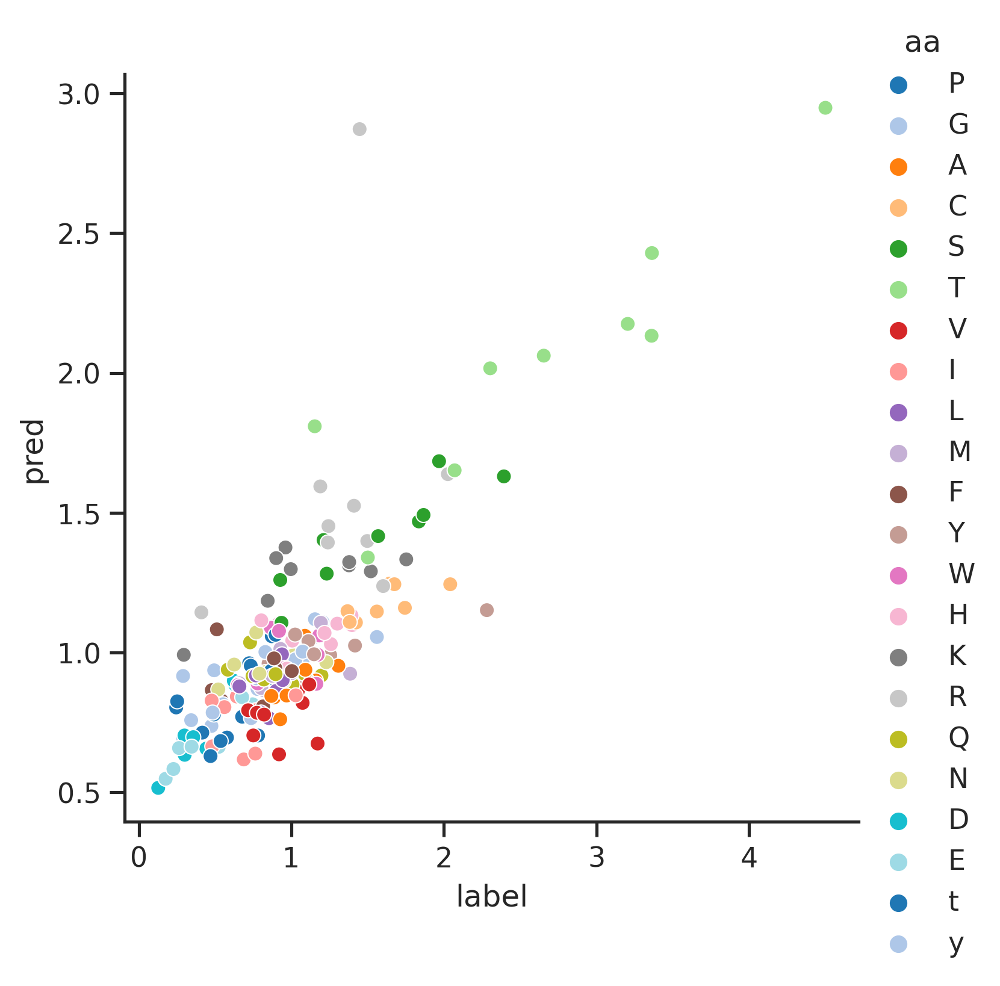

------TAO2------
Logo of TAO2  from raw dataset


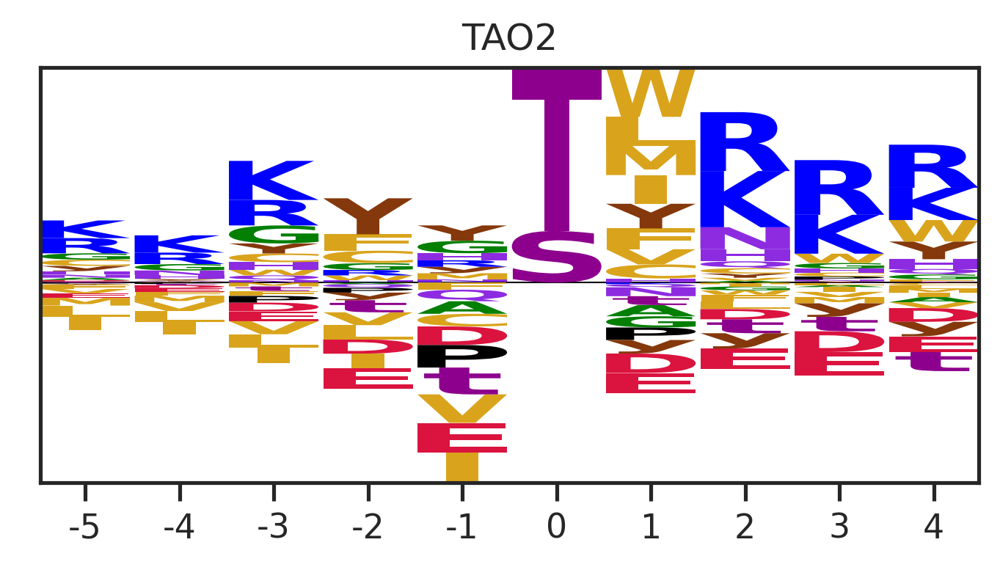

Logo of TAO2  from reversed label


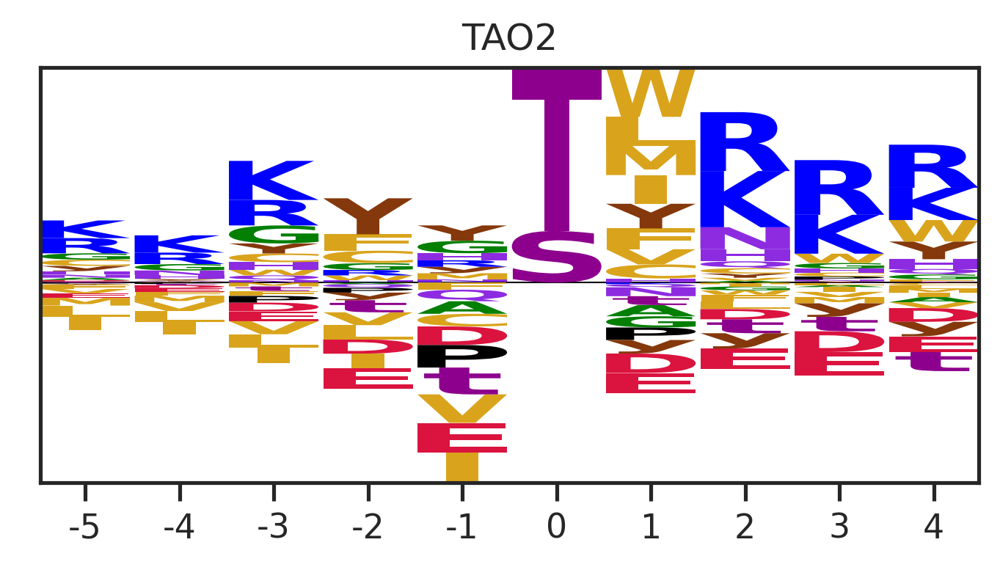

Logo of TAO2  based on prediction


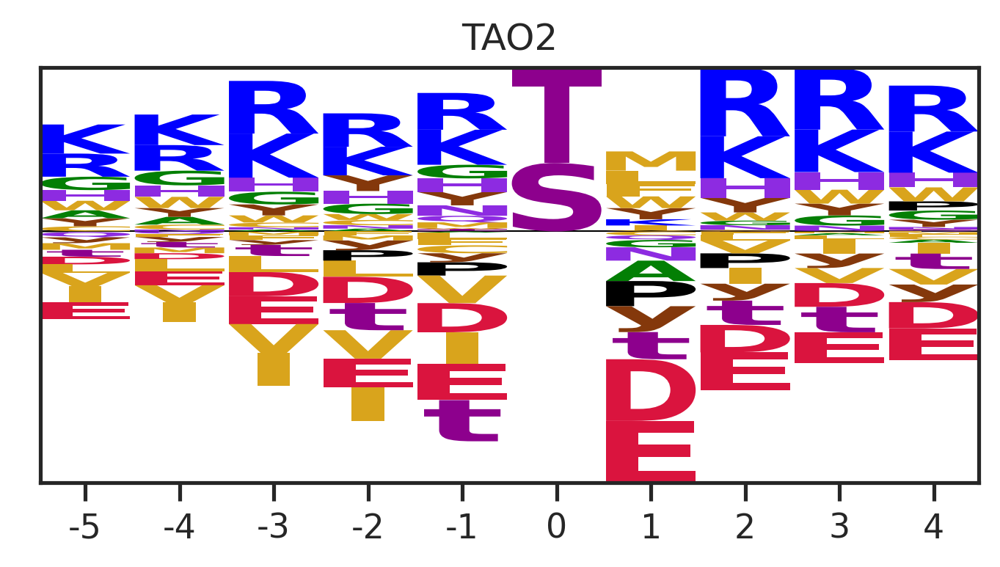

correlation


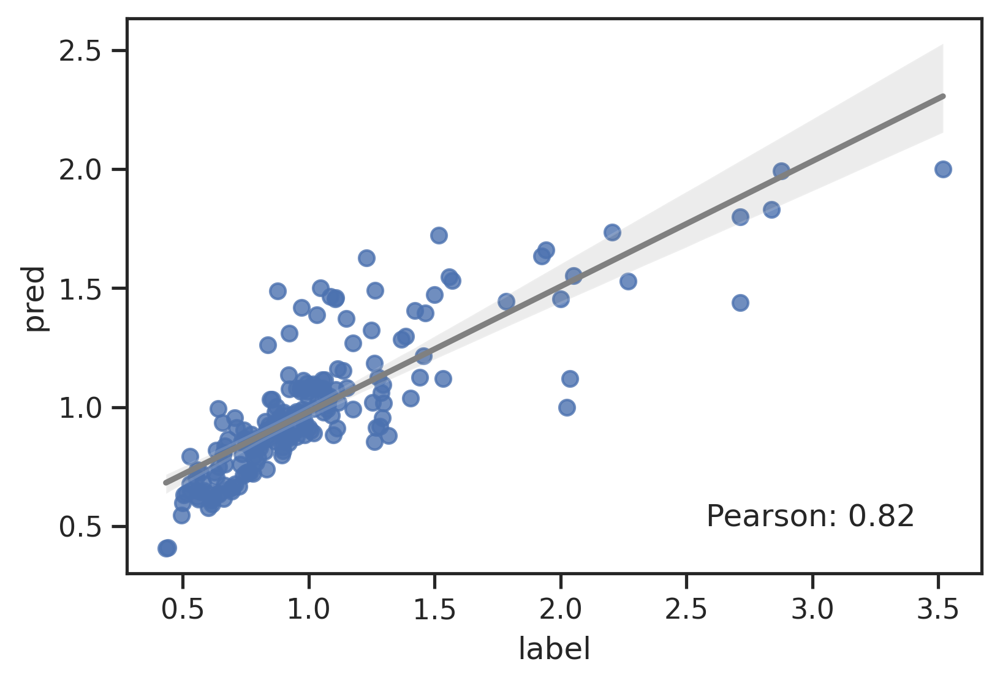

colored by aa


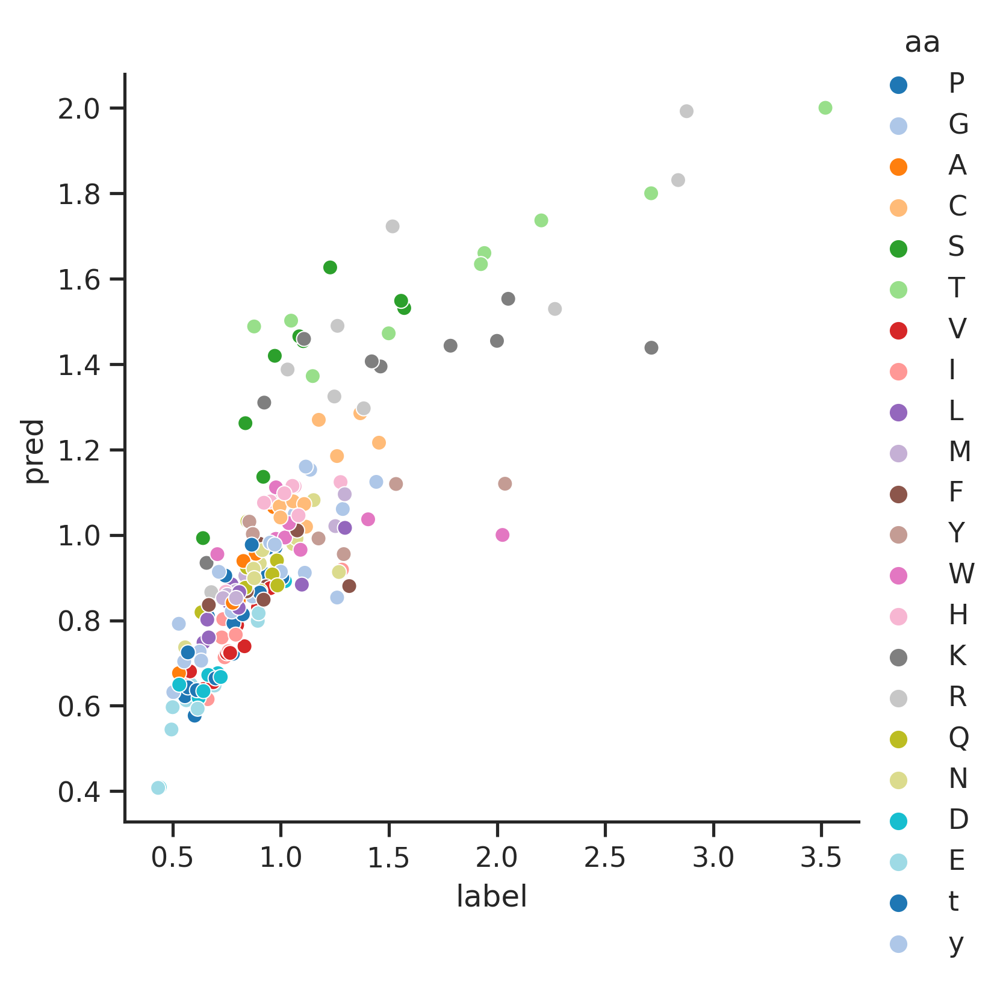

------MST2------
Logo of MST2  from raw dataset


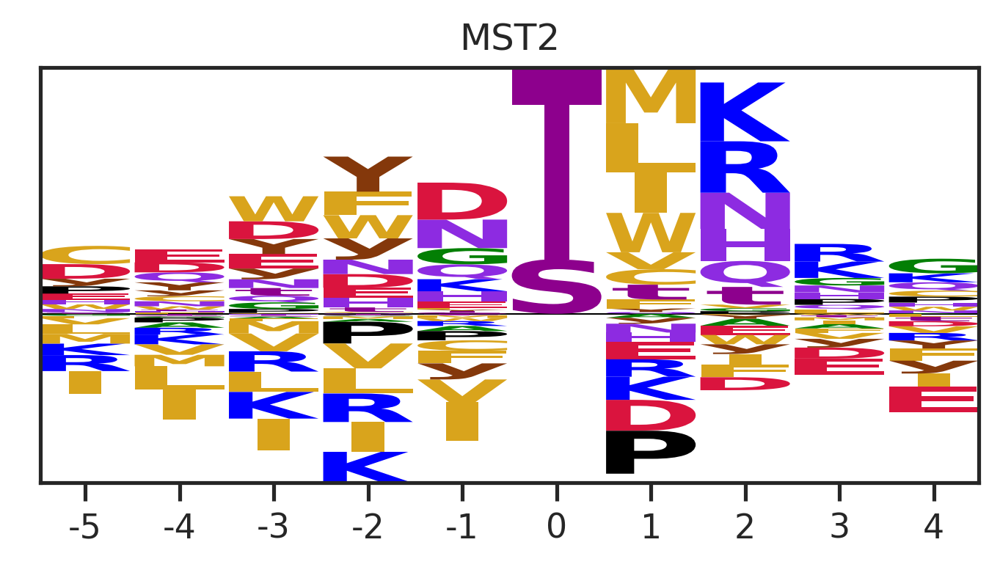

Logo of MST2  from reversed label


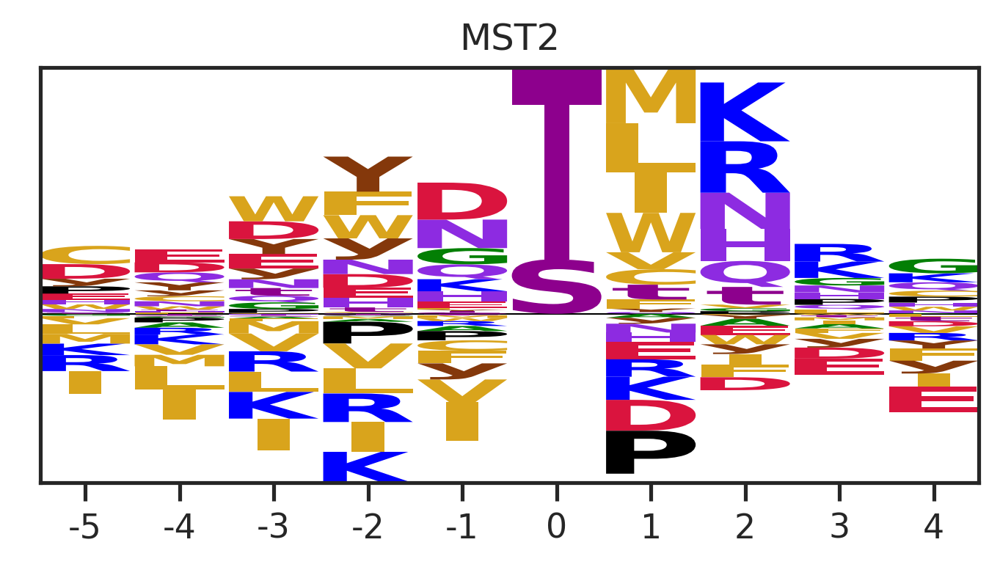

Logo of MST2  based on prediction


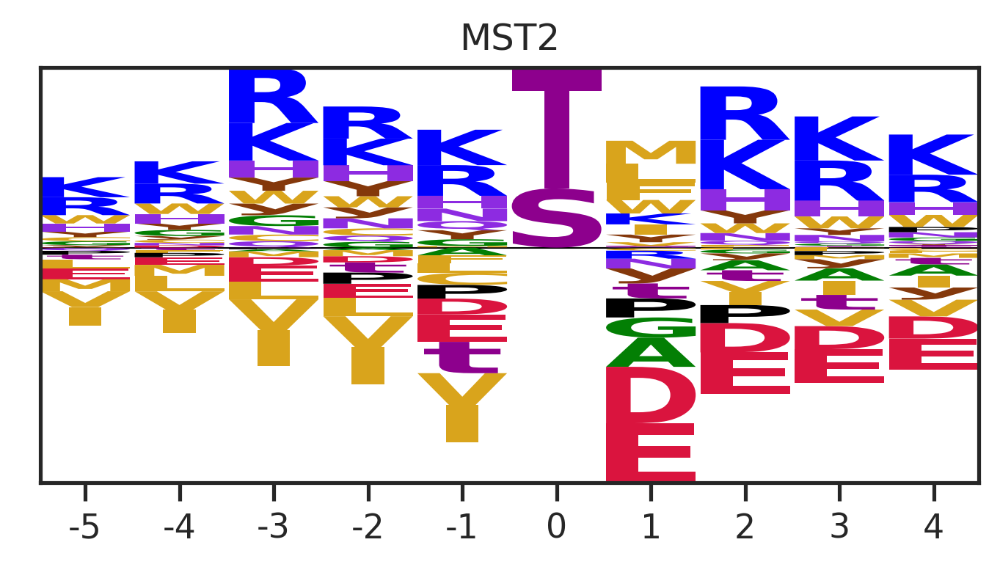

correlation


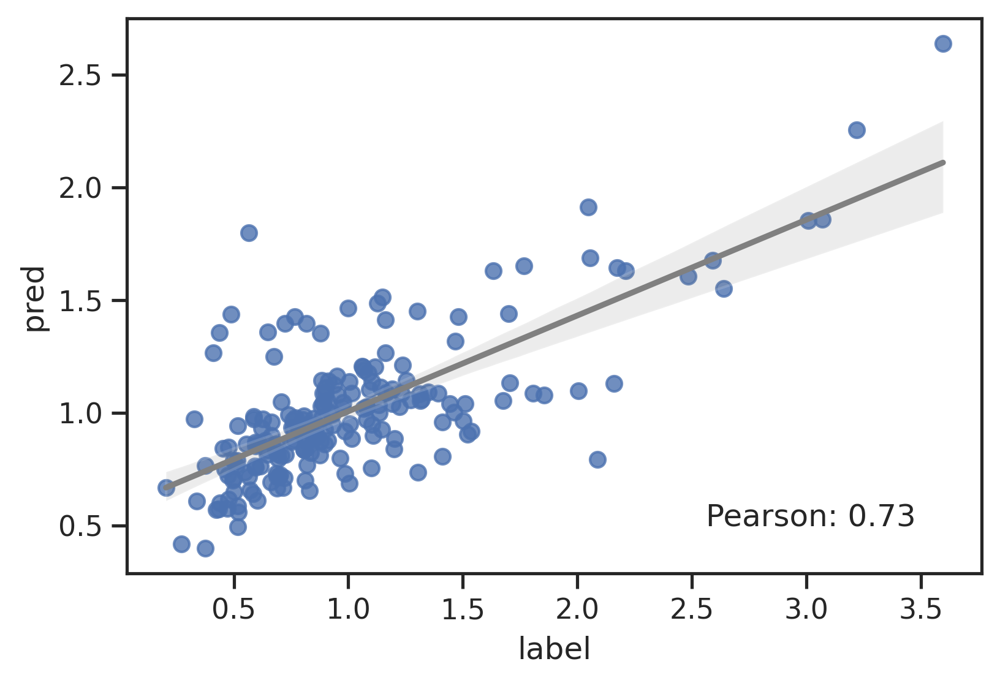

colored by aa


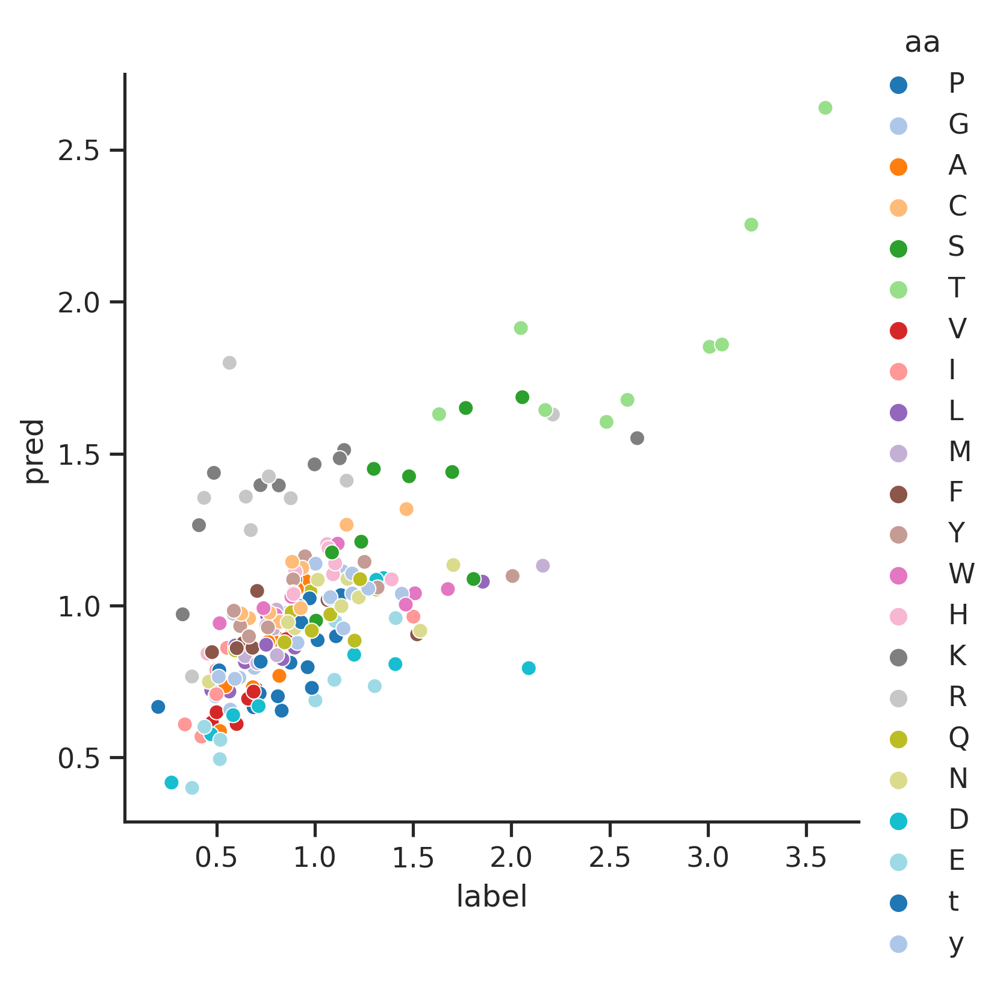

------AAK1------
Logo of AAK1  from raw dataset


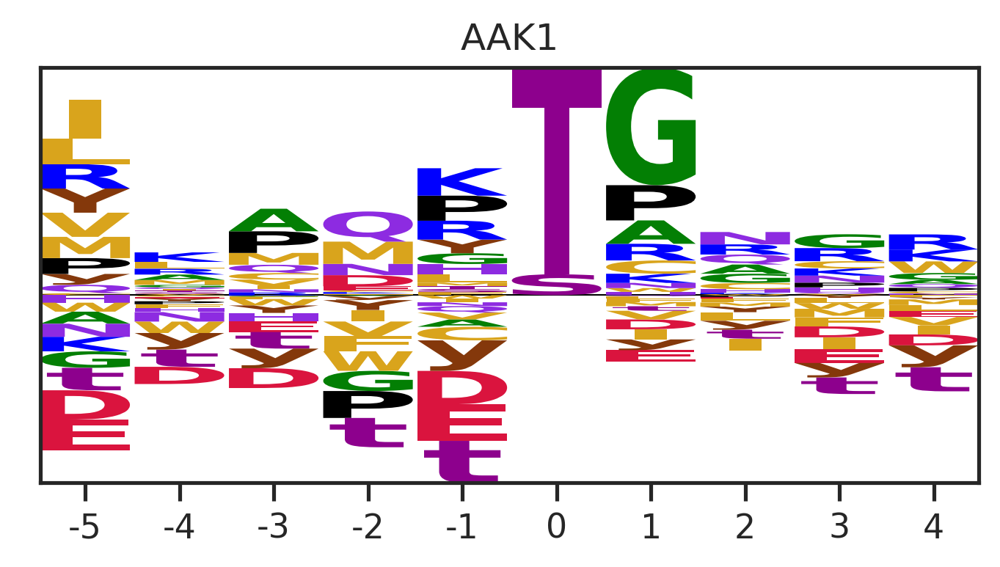

Logo of AAK1  from reversed label


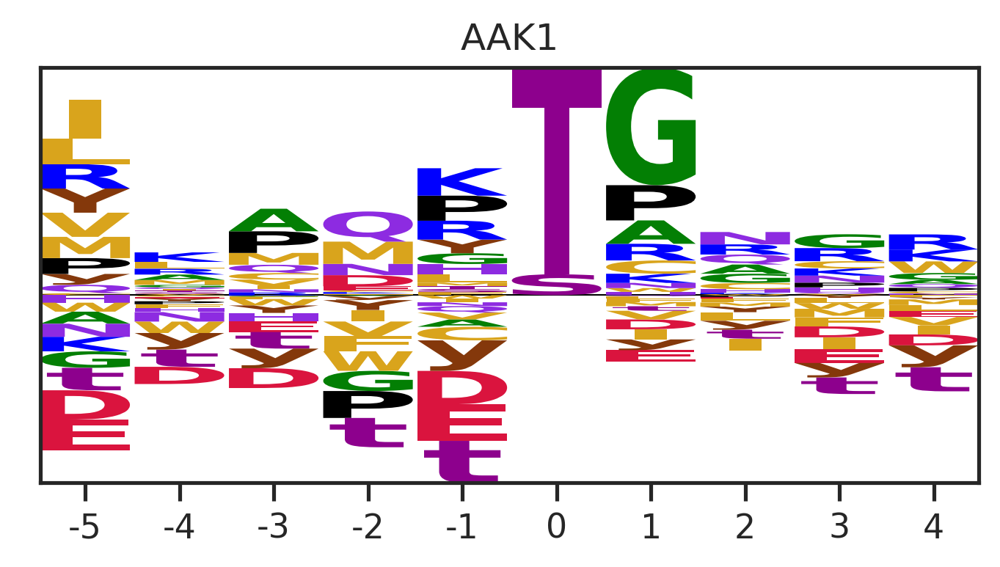

Logo of AAK1  based on prediction


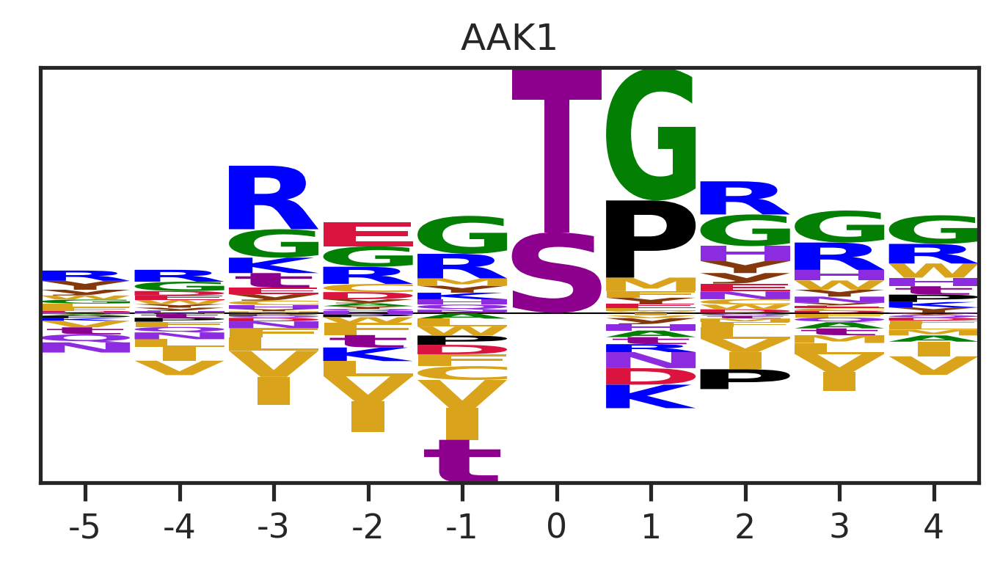

correlation


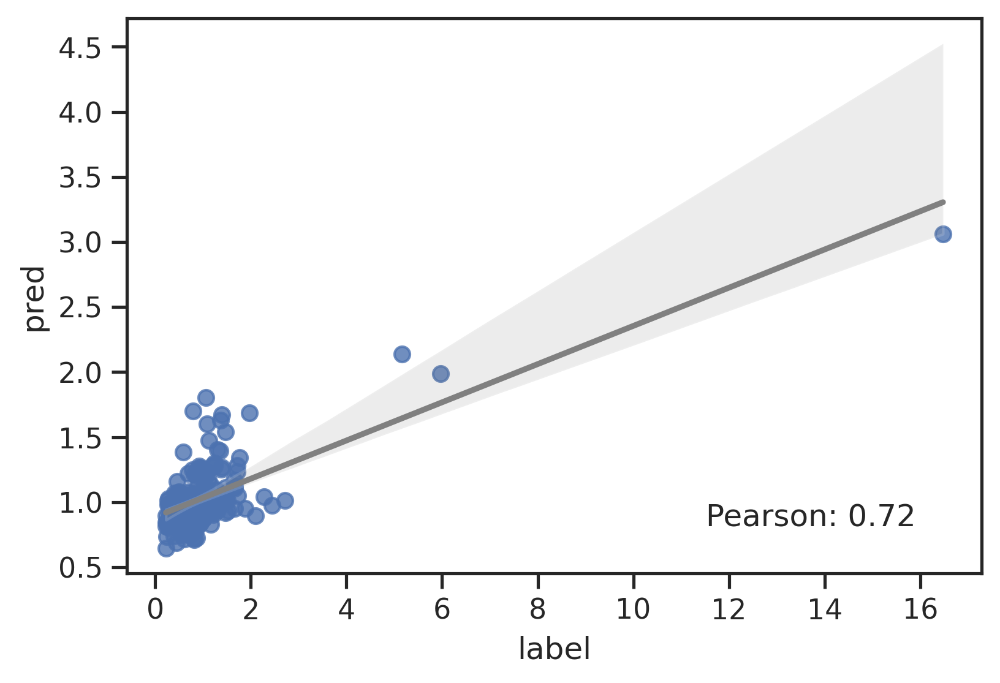

colored by aa


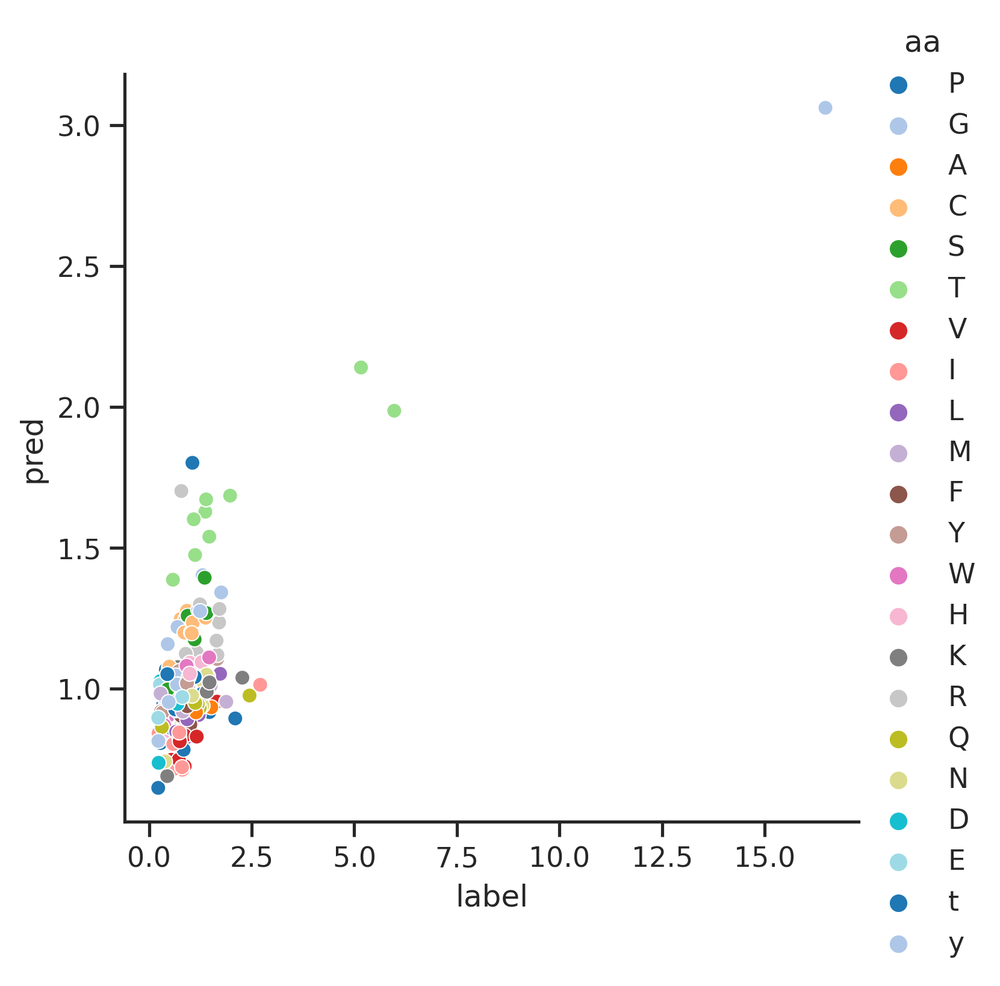

------TBK1------
Logo of TBK1  from raw dataset


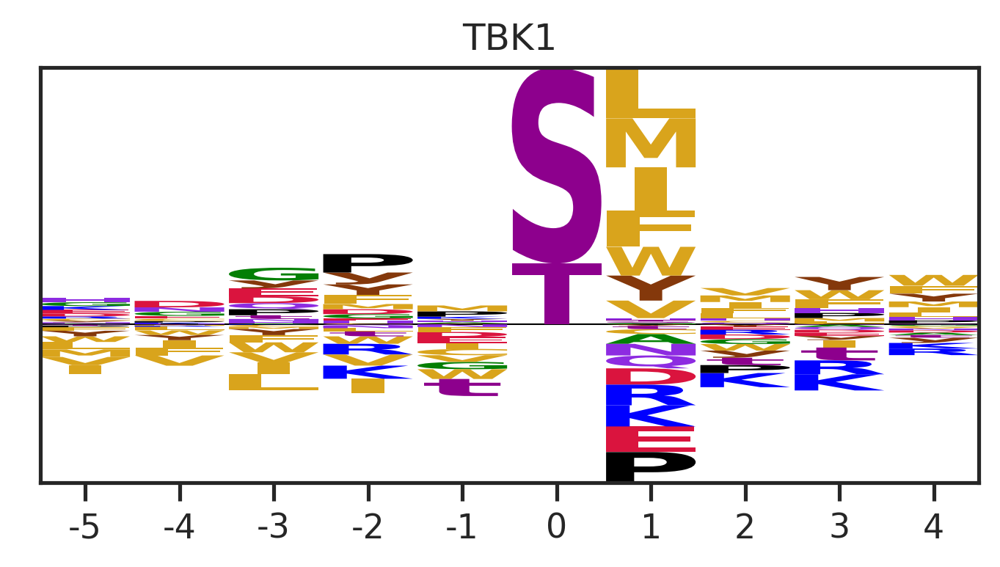

Logo of TBK1  from reversed label


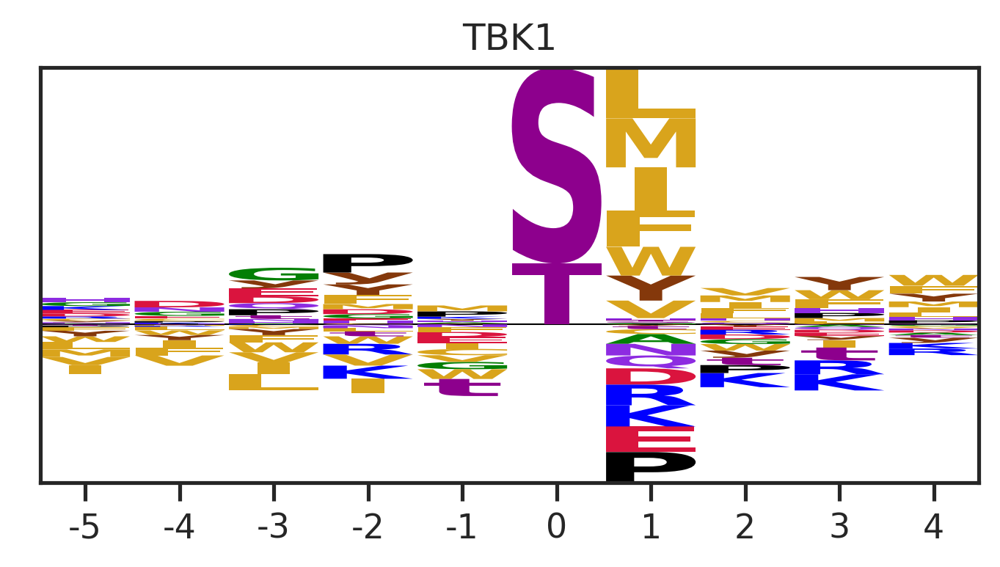

Logo of TBK1  based on prediction


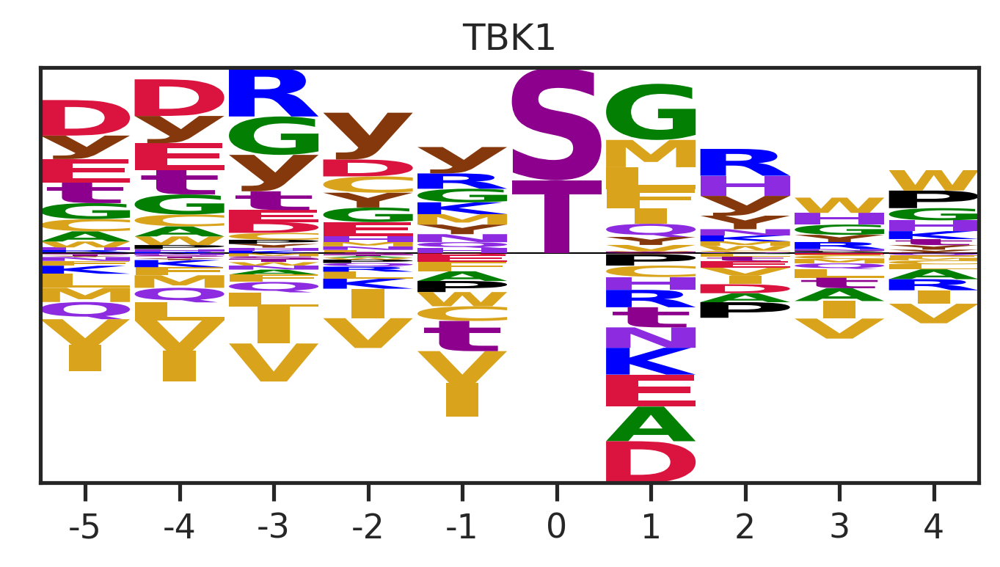

correlation


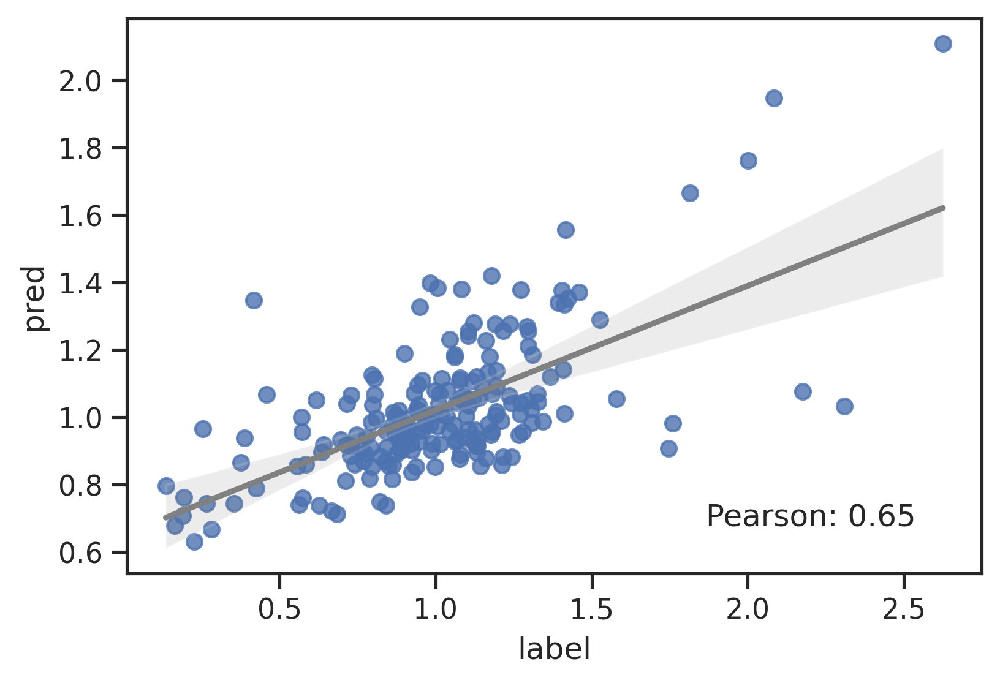

colored by aa


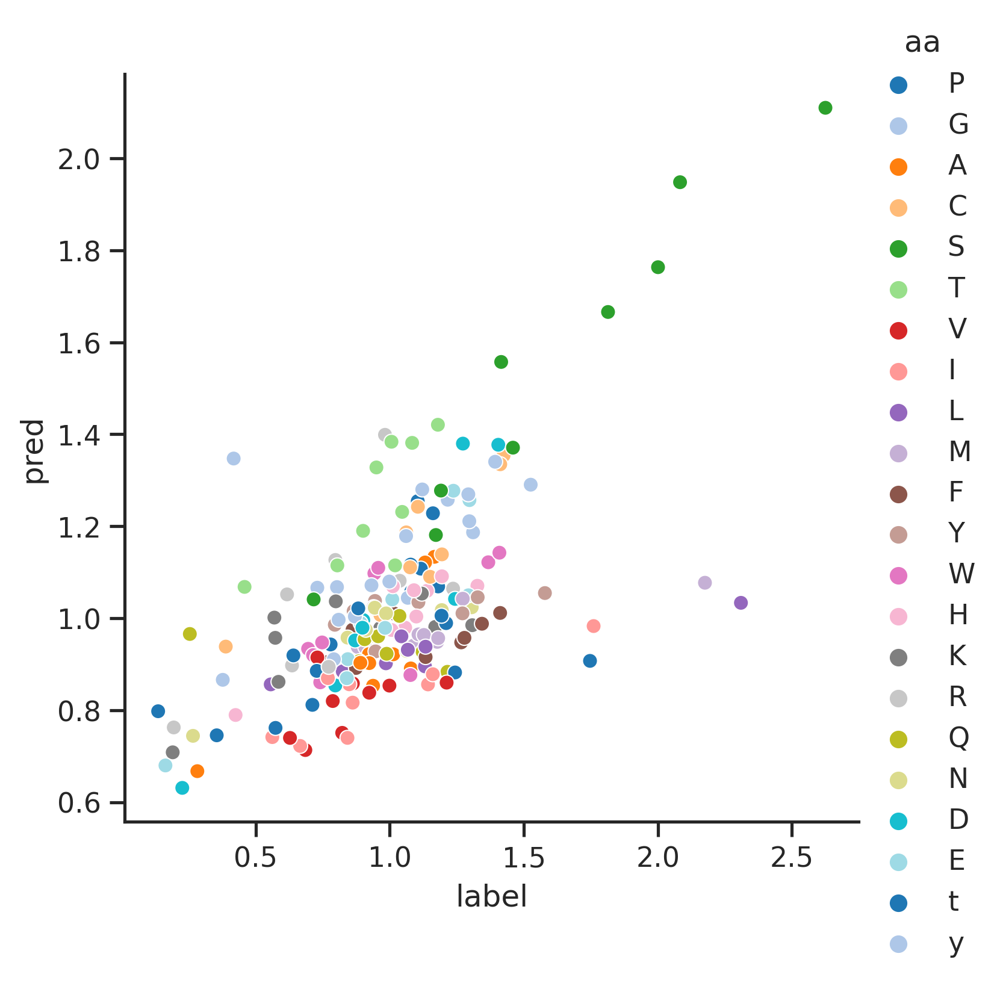

------MLK4------
Logo of MLK4  from raw dataset


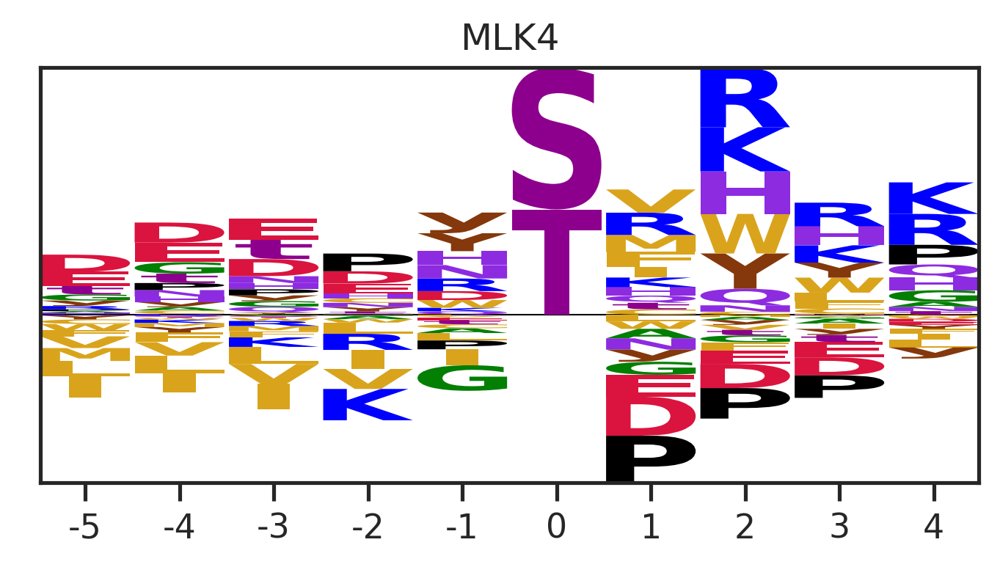

Logo of MLK4  from reversed label


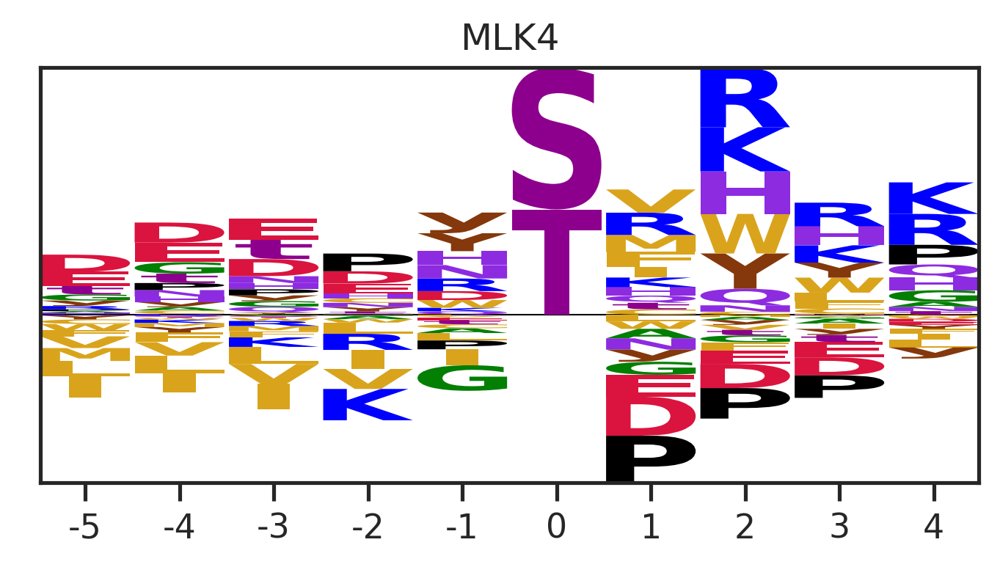

Logo of MLK4  based on prediction


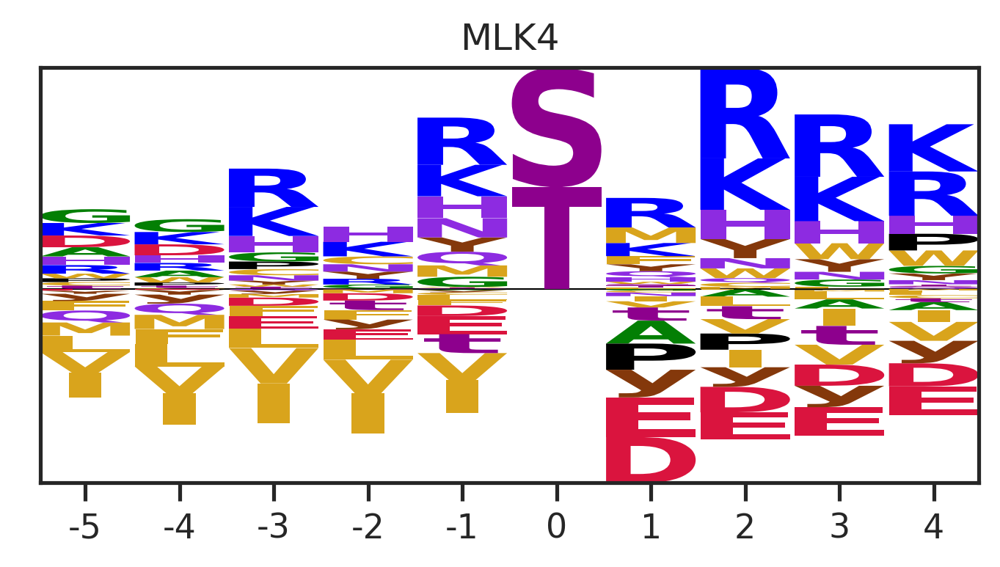

correlation


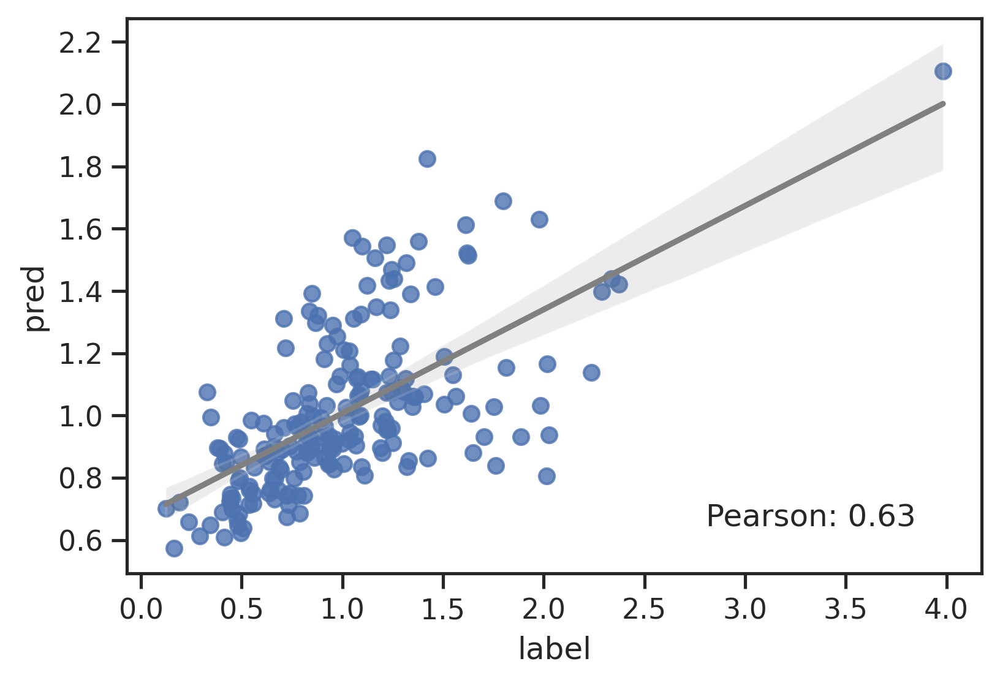

colored by aa


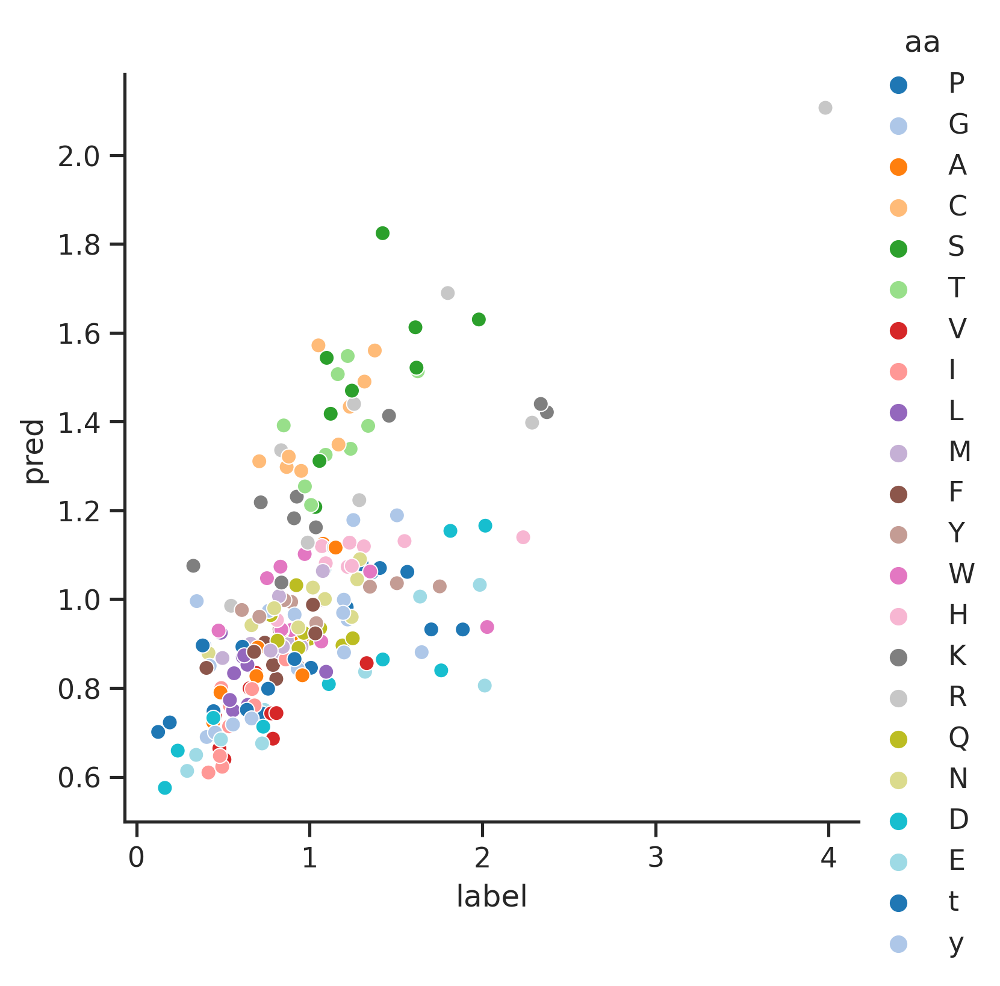

------RIPK3------
Logo of RIPK3  from raw dataset


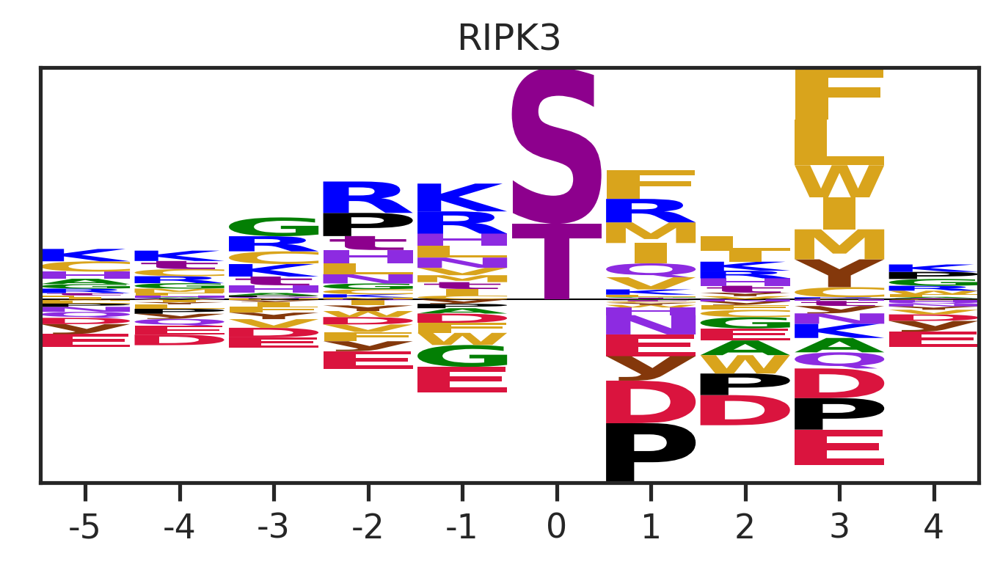

Logo of RIPK3  from reversed label


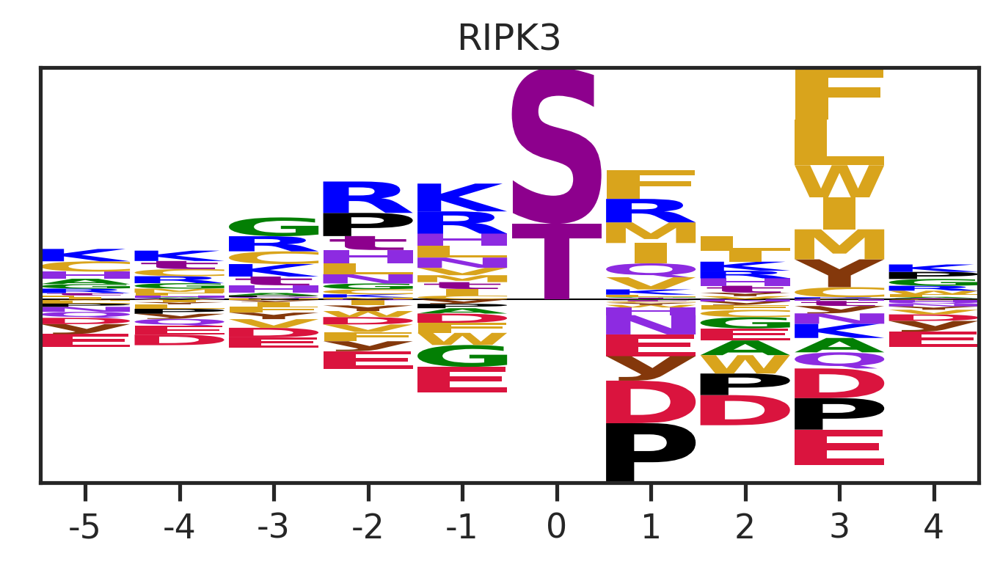

Logo of RIPK3  based on prediction


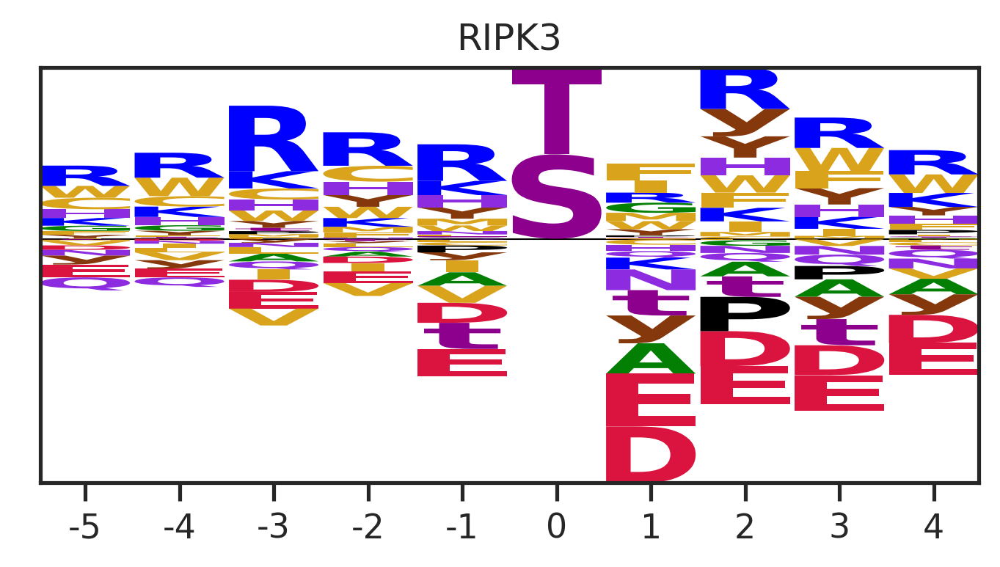

correlation


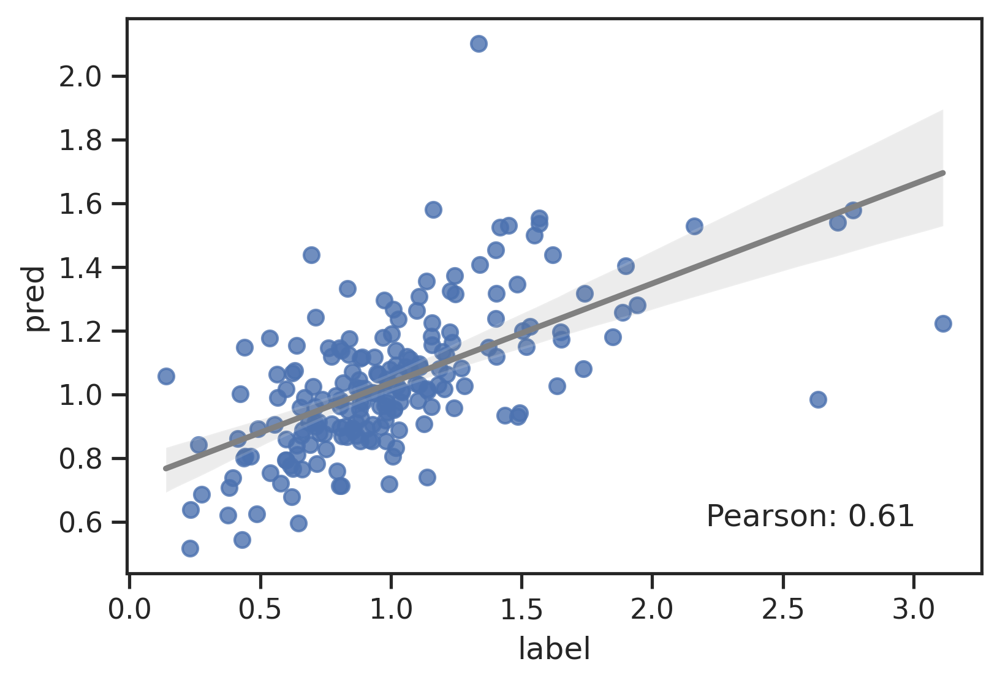

colored by aa


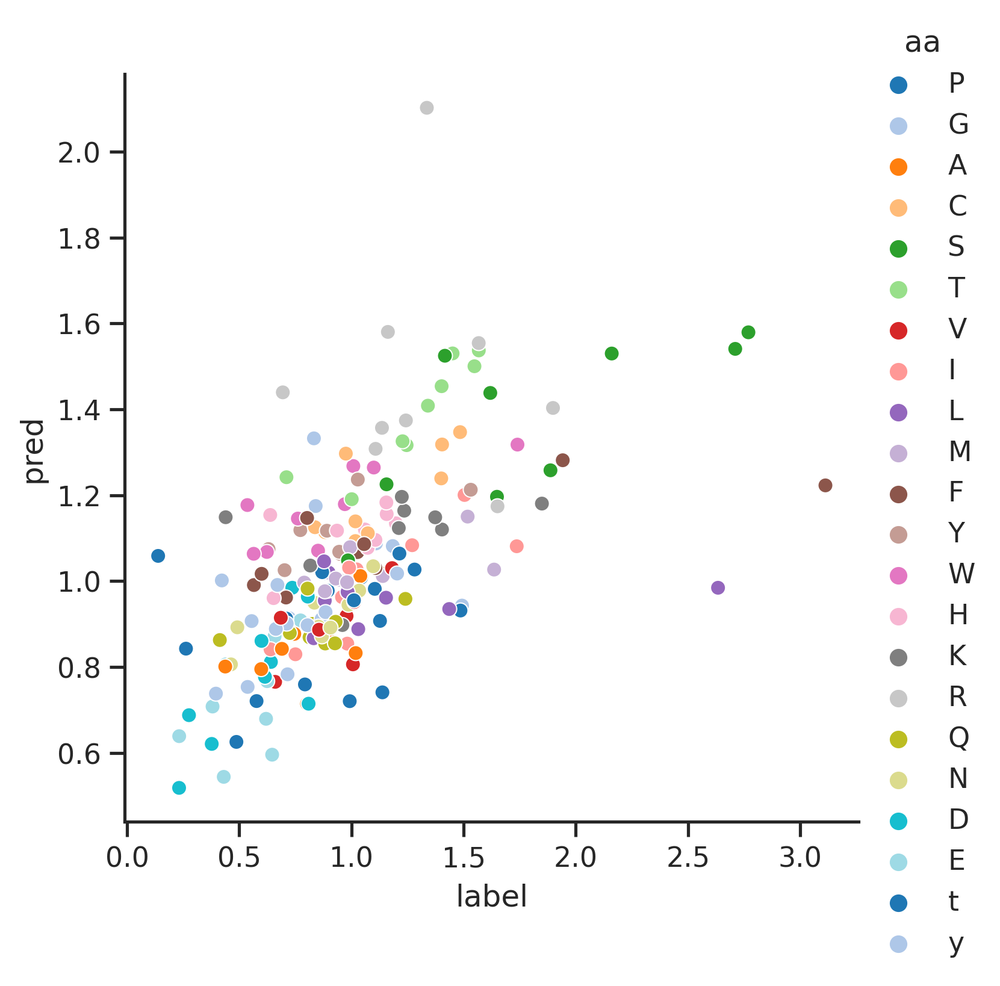

------NLK------
Logo of NLK  from raw dataset


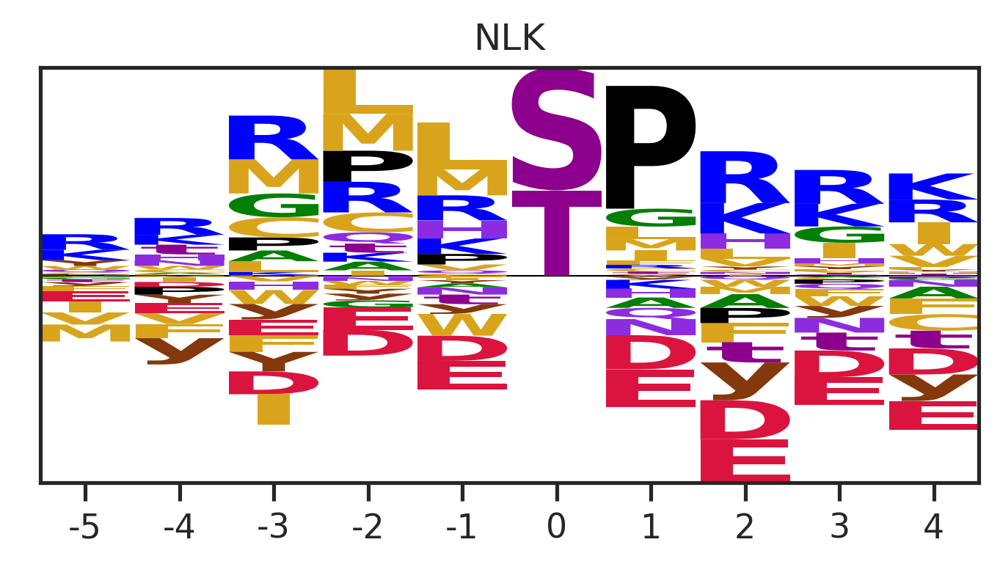

Logo of NLK  from reversed label


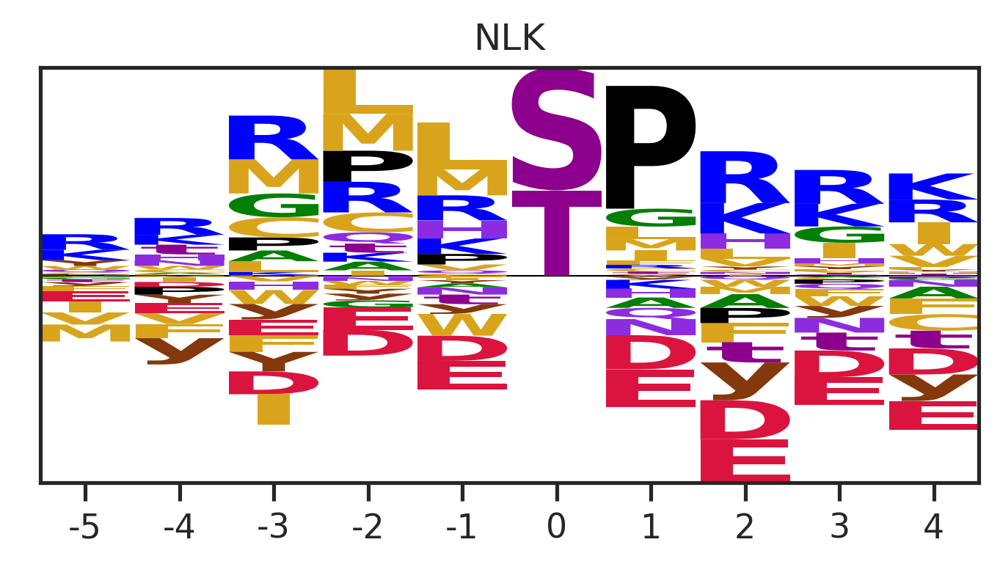

Logo of NLK  based on prediction


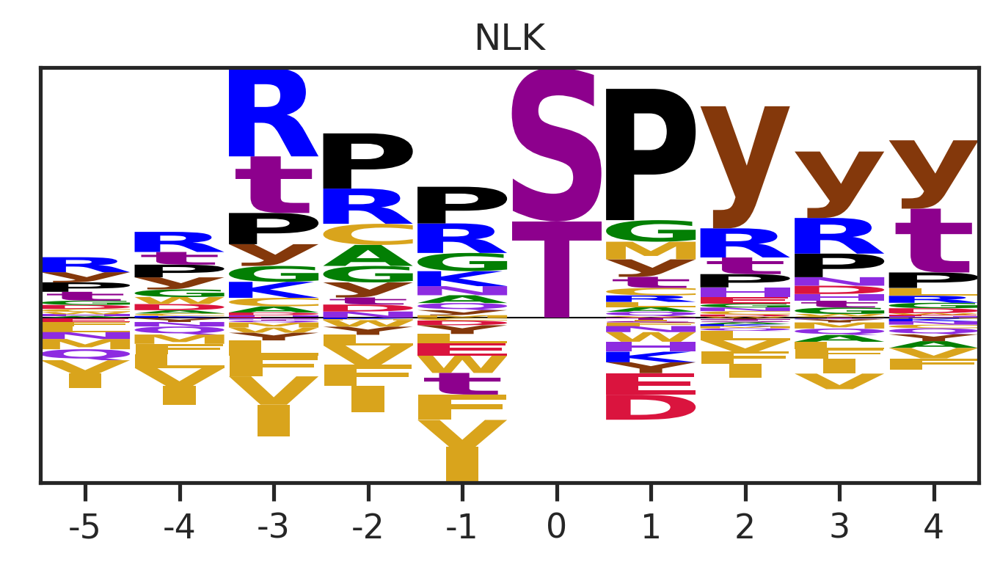

correlation


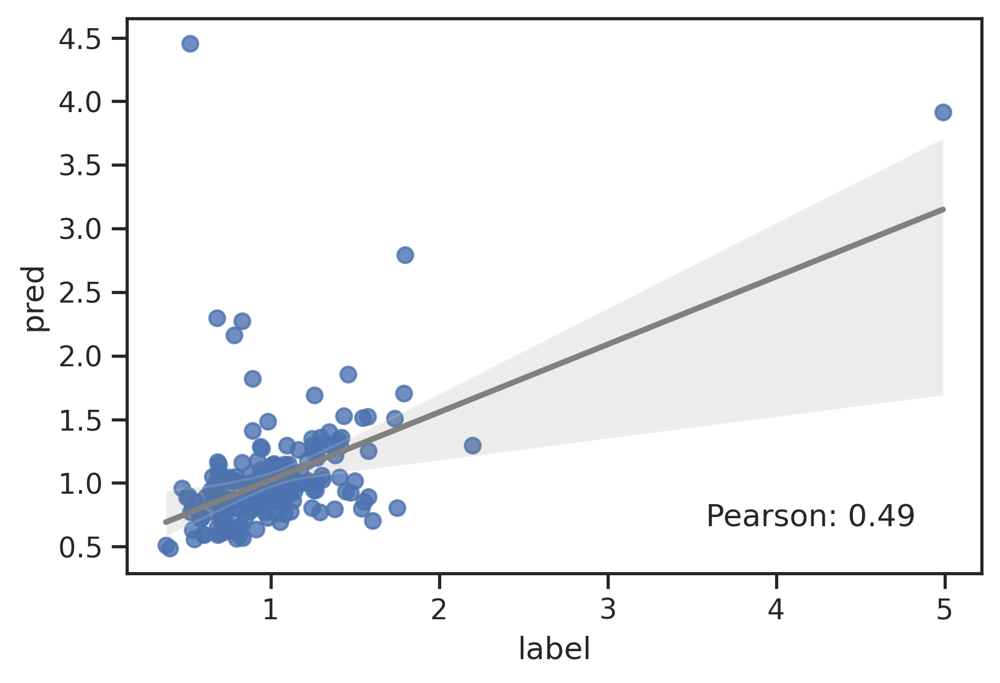

colored by aa


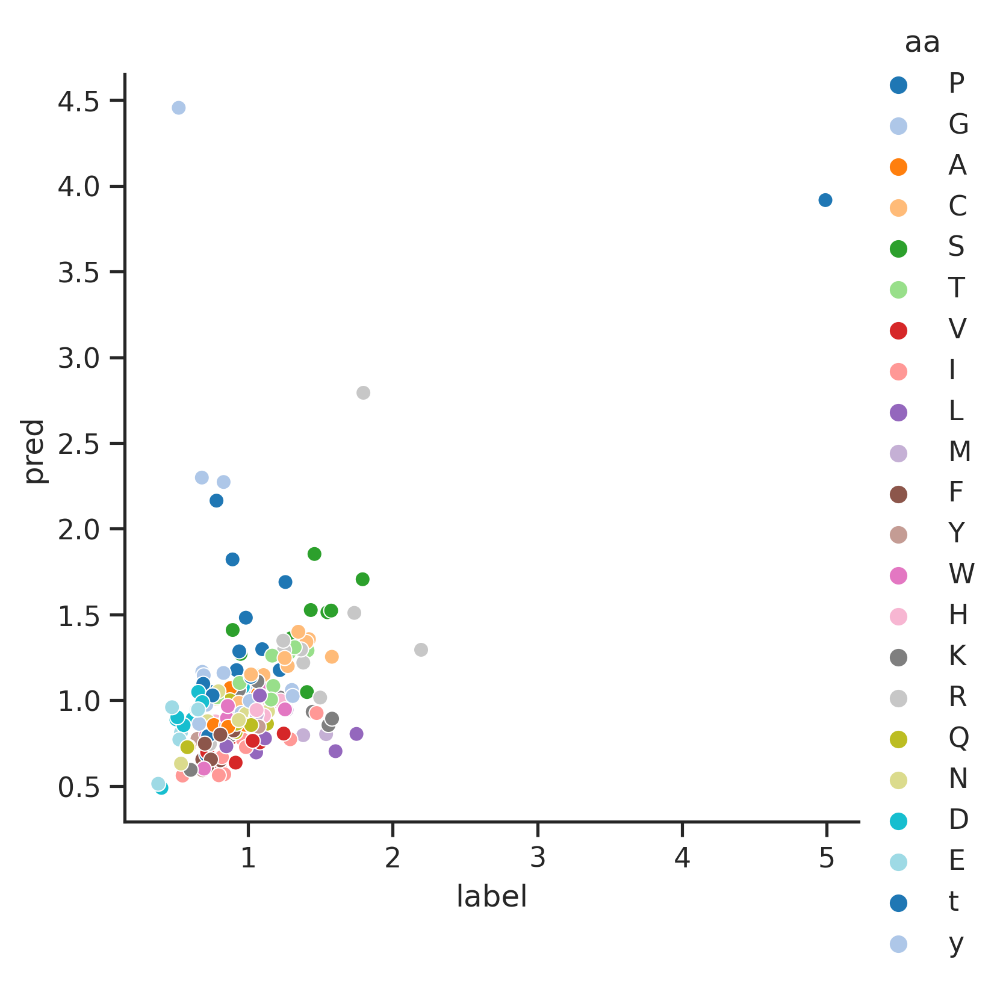

------DNAPK------
Logo of DNAPK  from raw dataset


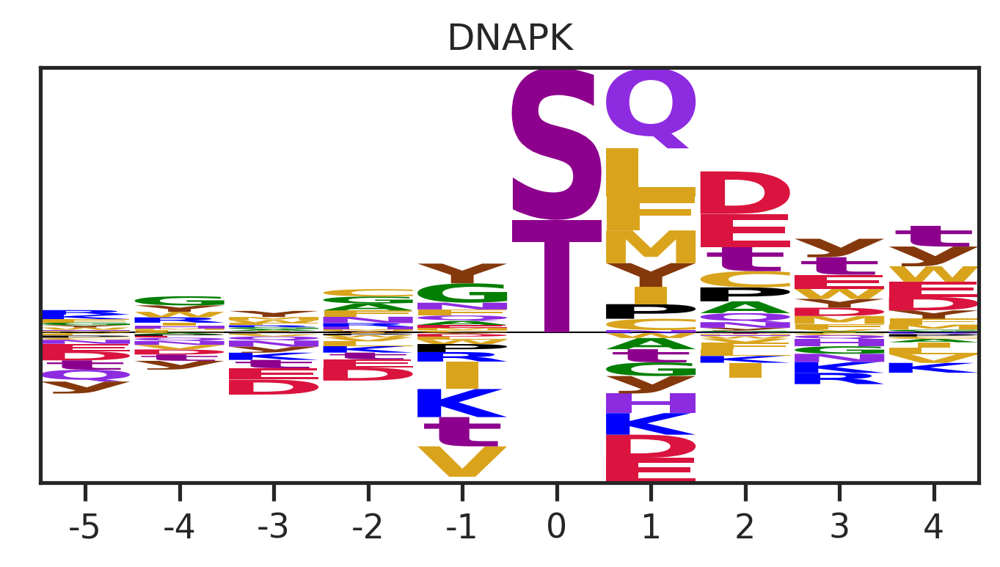

Logo of DNAPK  from reversed label


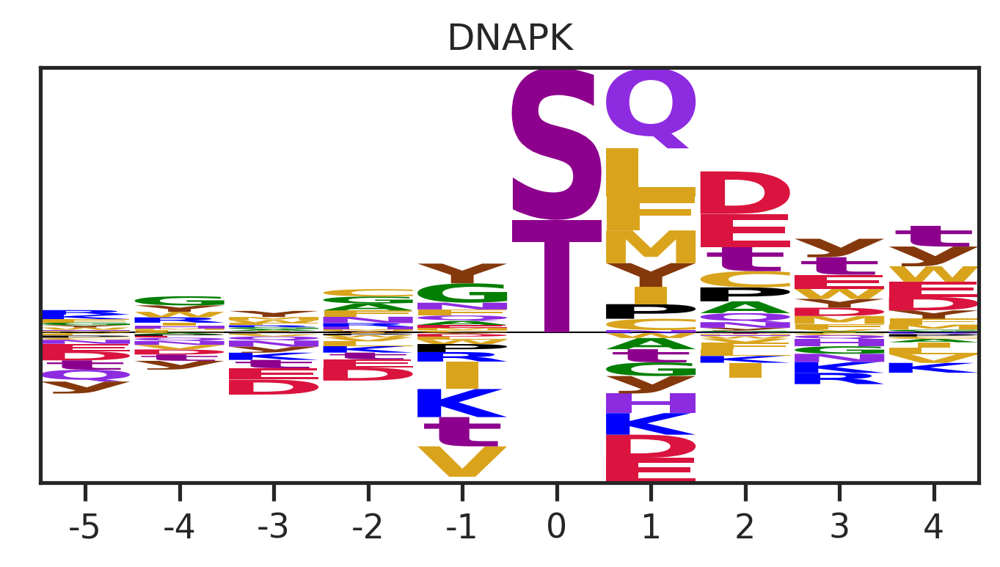

Logo of DNAPK  based on prediction


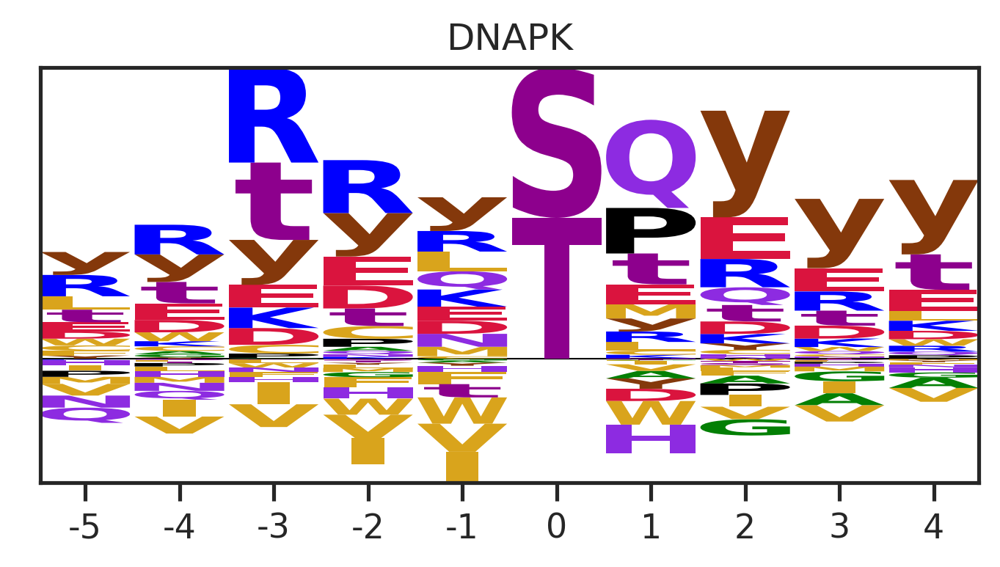

correlation


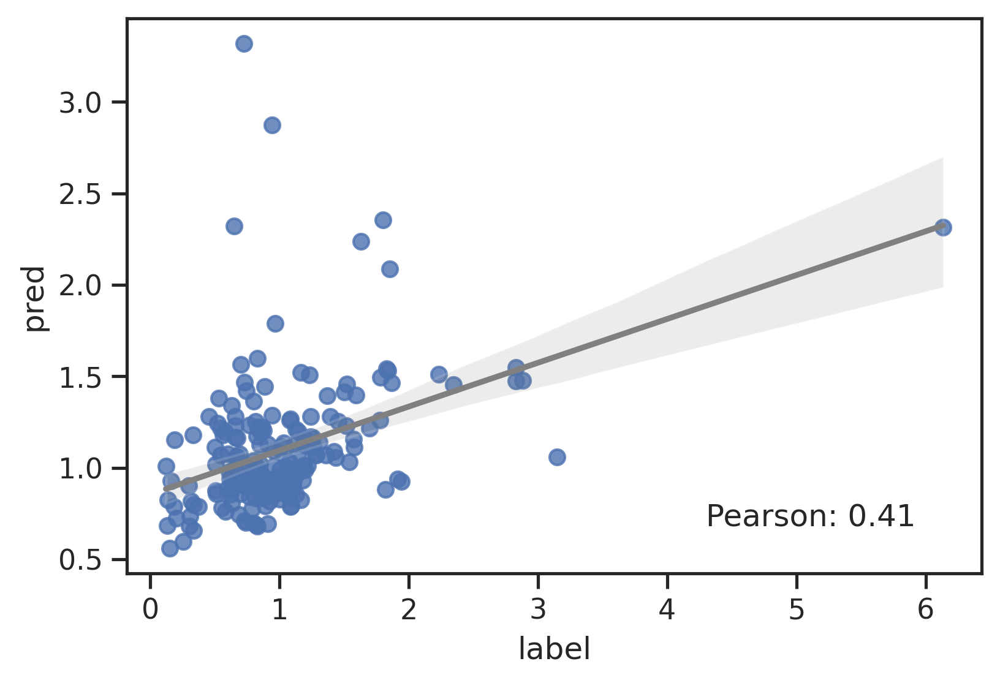

colored by aa


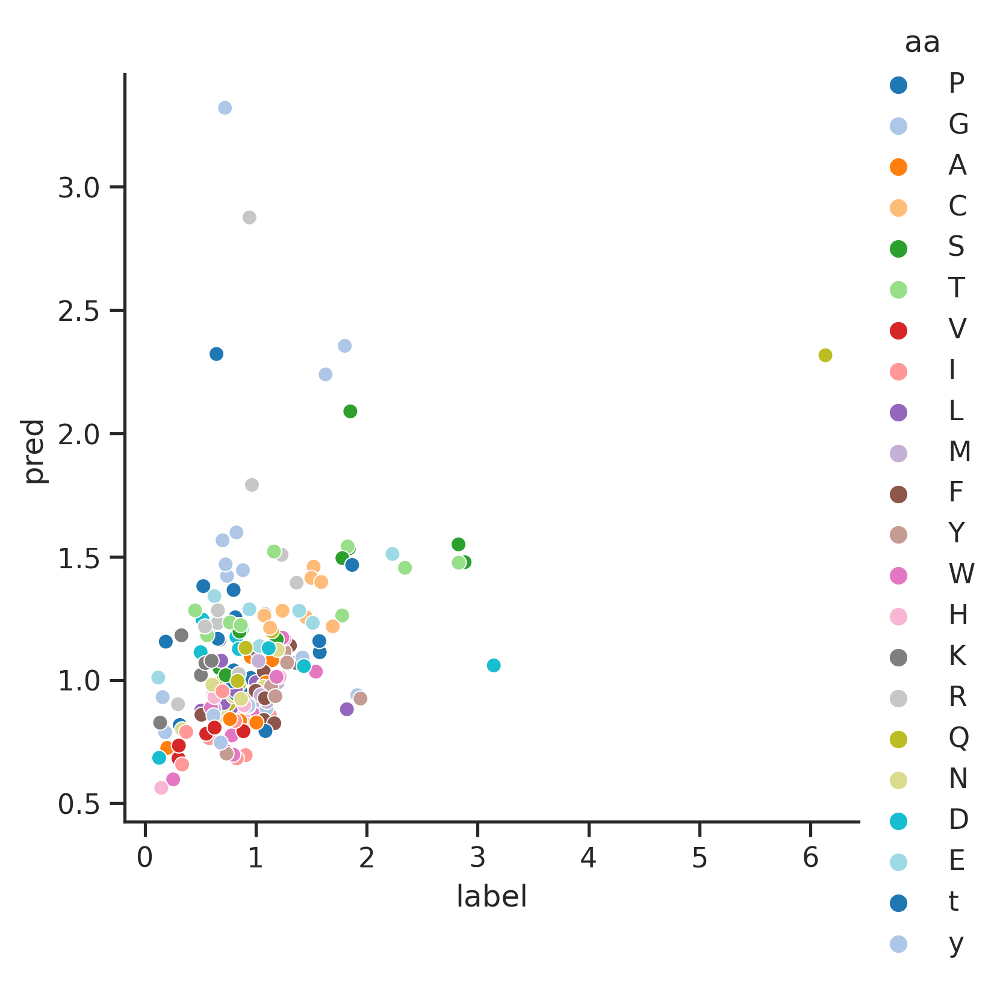

------TTBK2------
Logo of TTBK2  from raw dataset


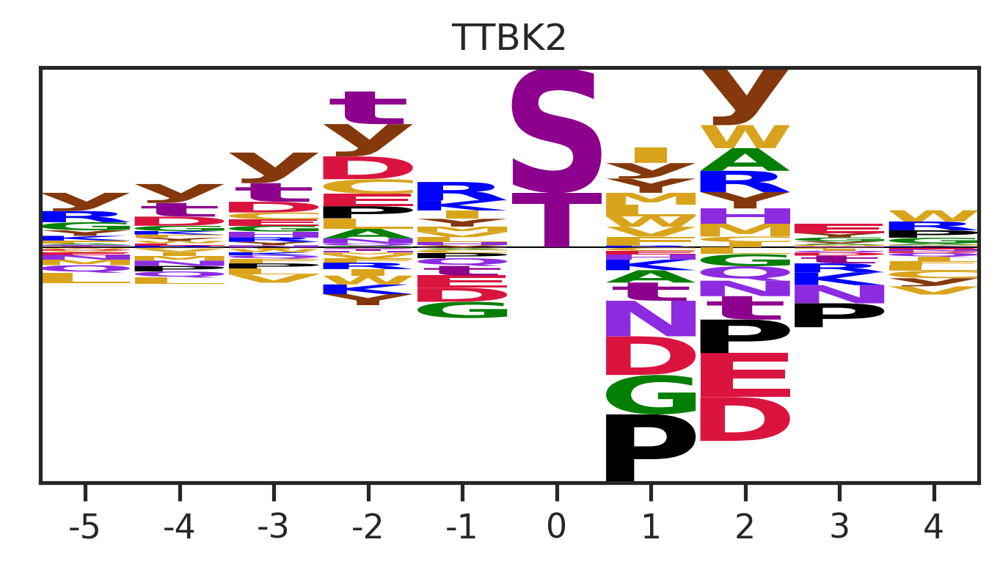

Logo of TTBK2  from reversed label


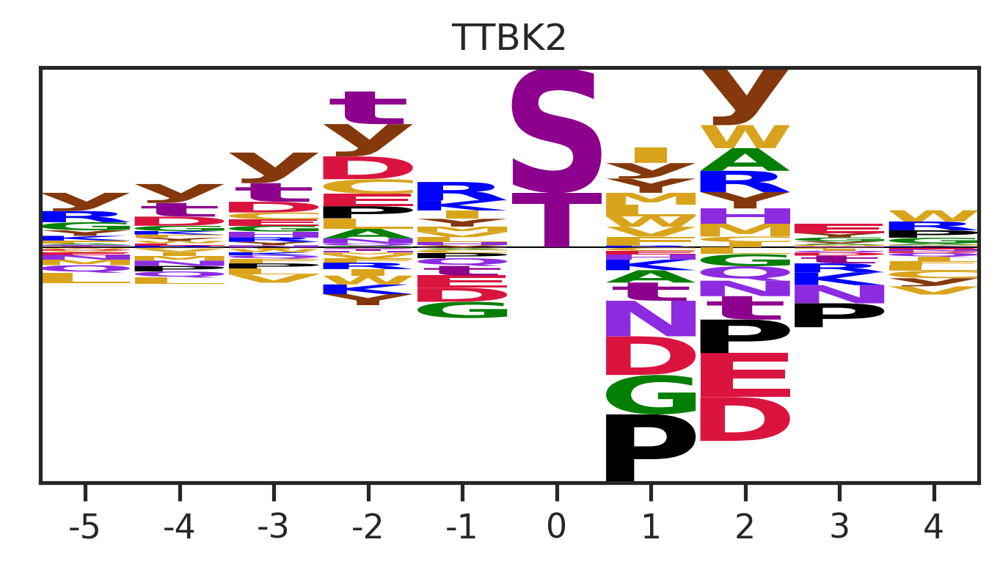

Logo of TTBK2  based on prediction


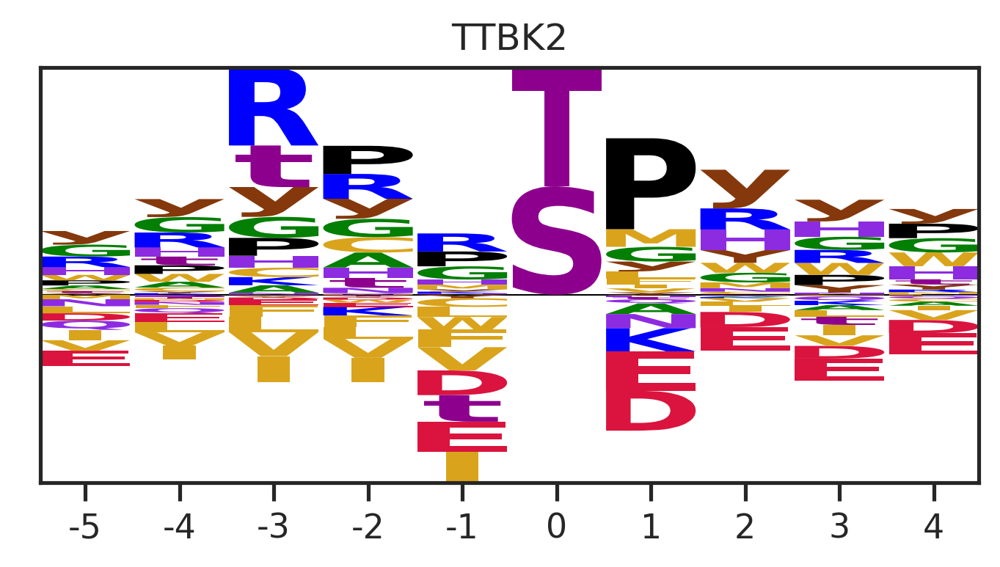

correlation


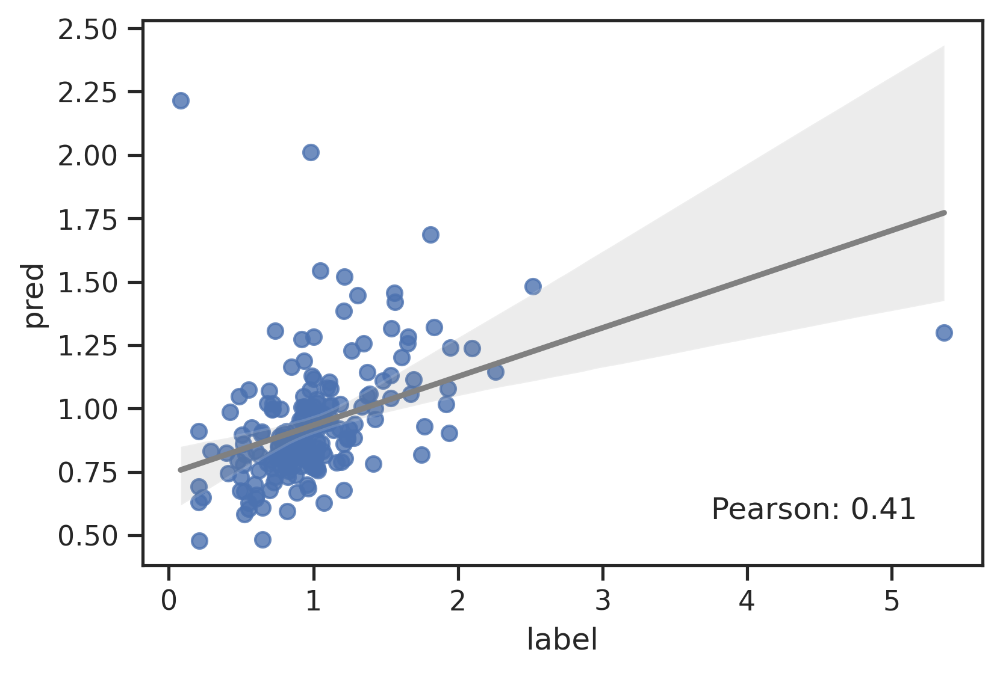

colored by aa


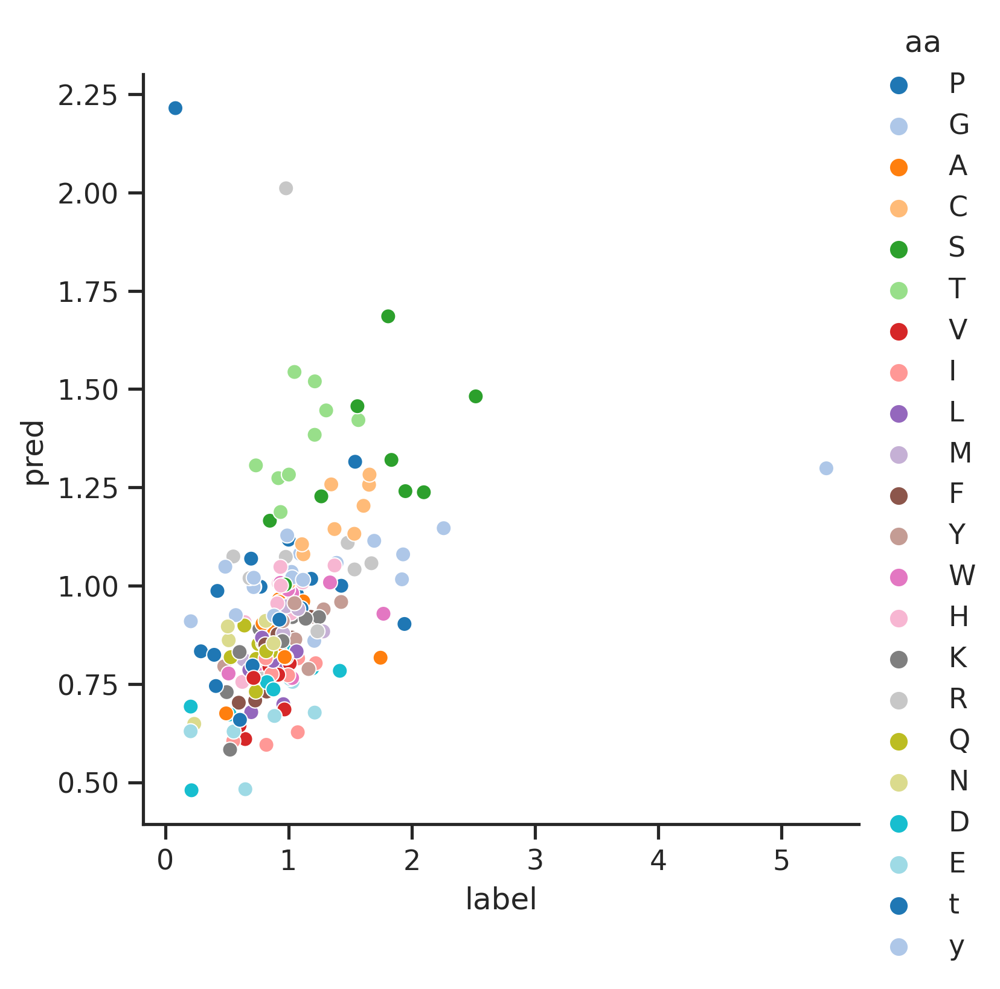

------HRI------
Logo of HRI  from raw dataset


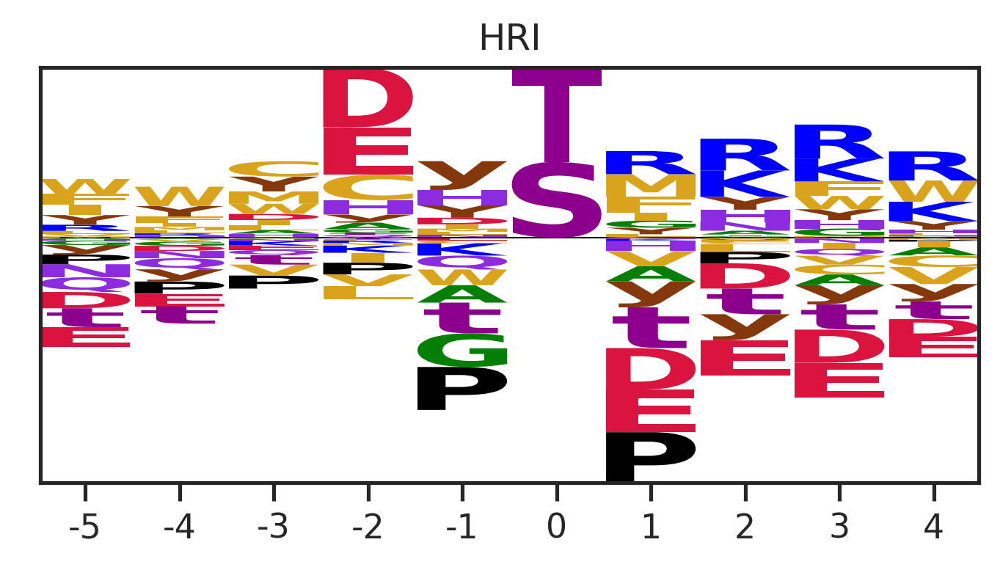

Logo of HRI  from reversed label


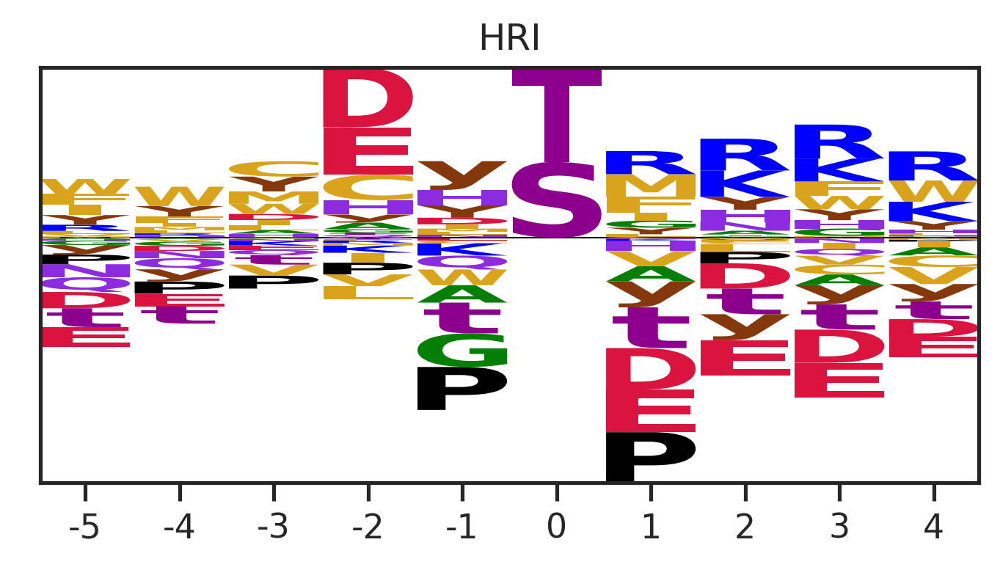

Logo of HRI  based on prediction


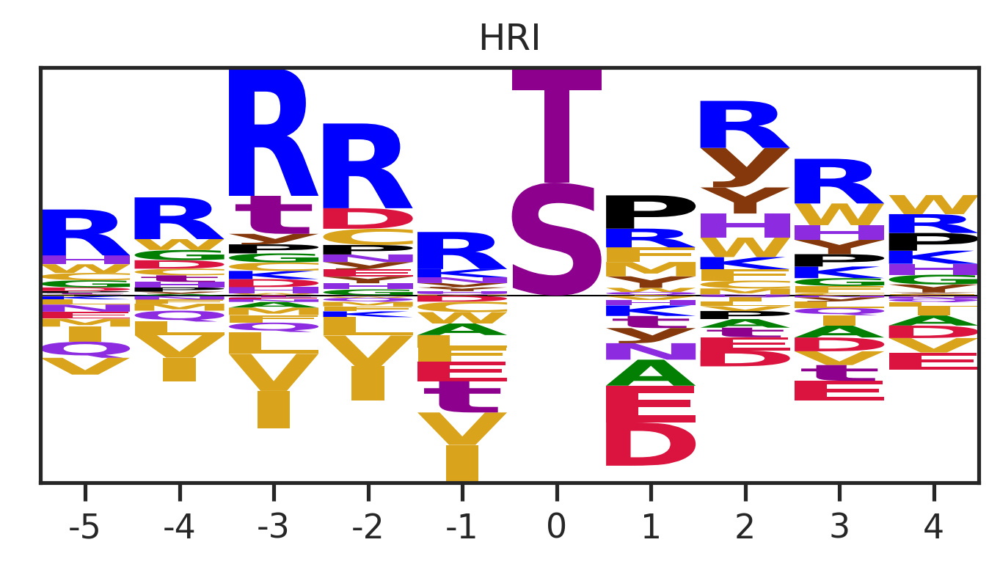

correlation


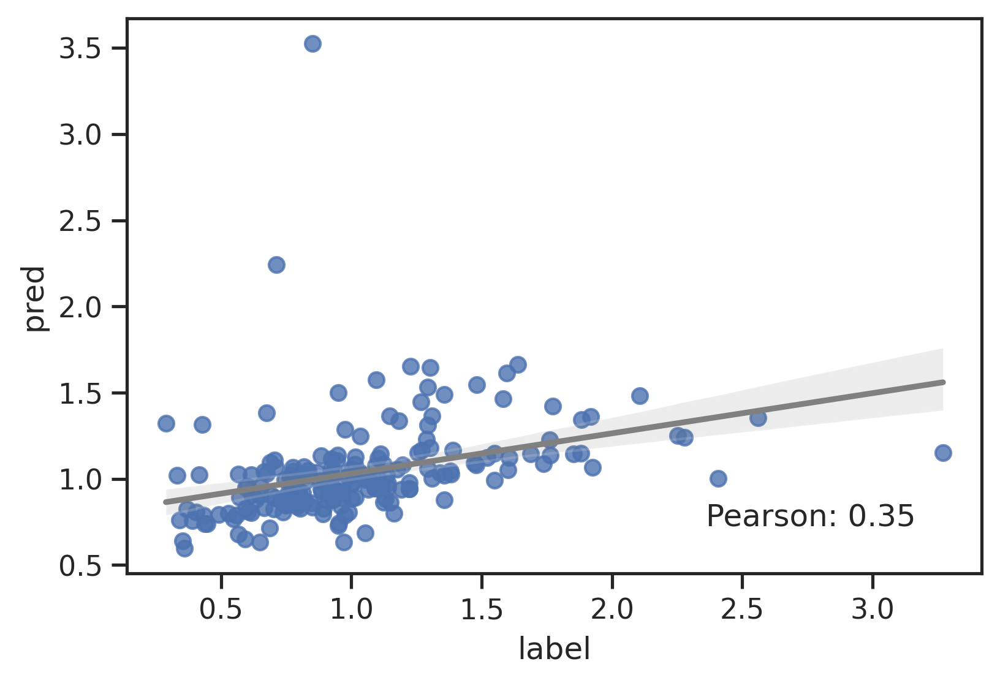

colored by aa


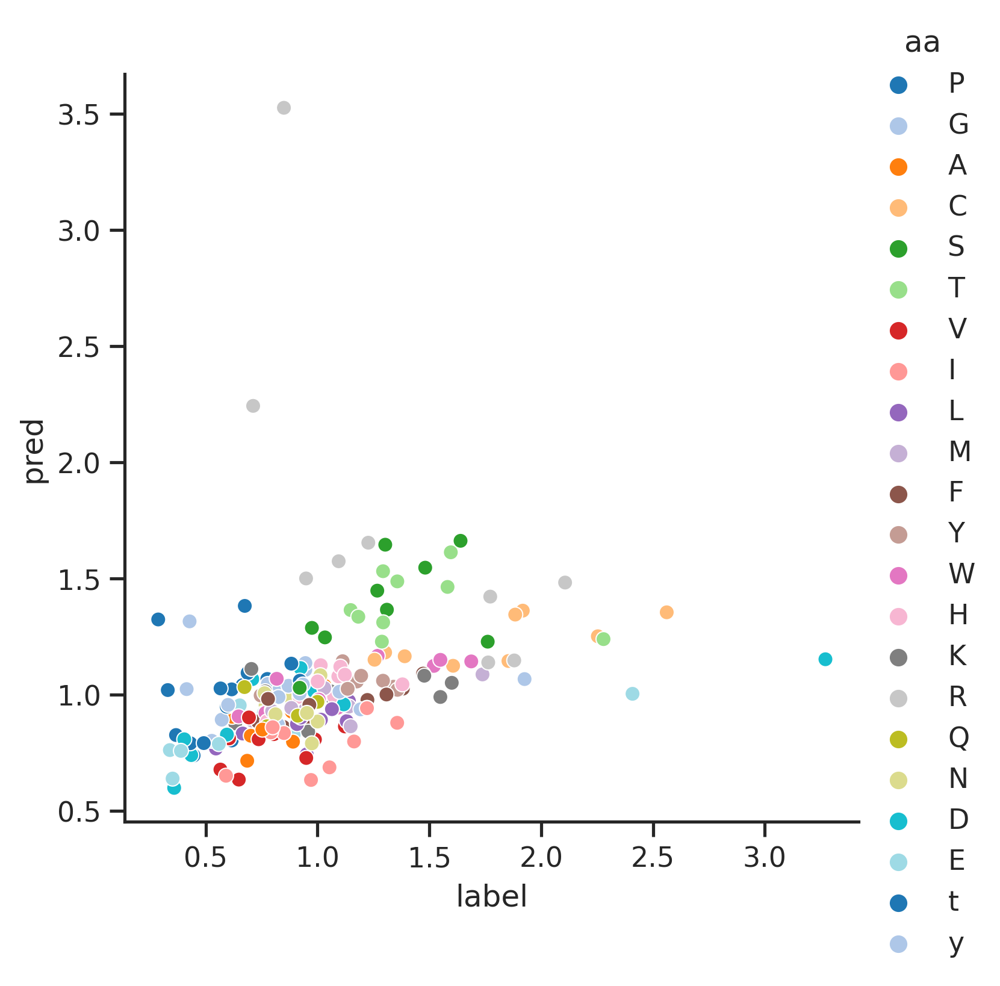

------CAMKK1------
Logo of CAMKK1  from raw dataset


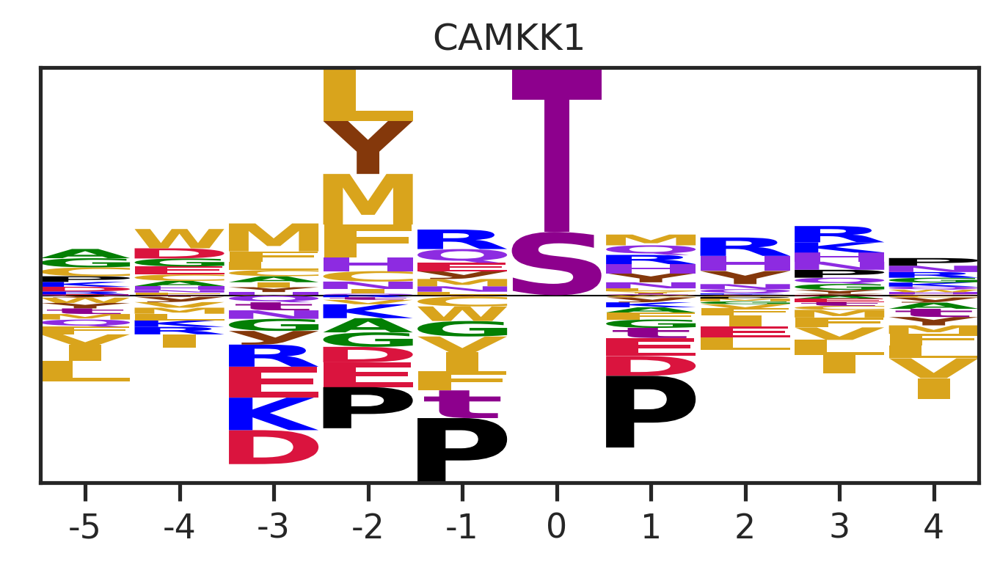

Logo of CAMKK1  from reversed label


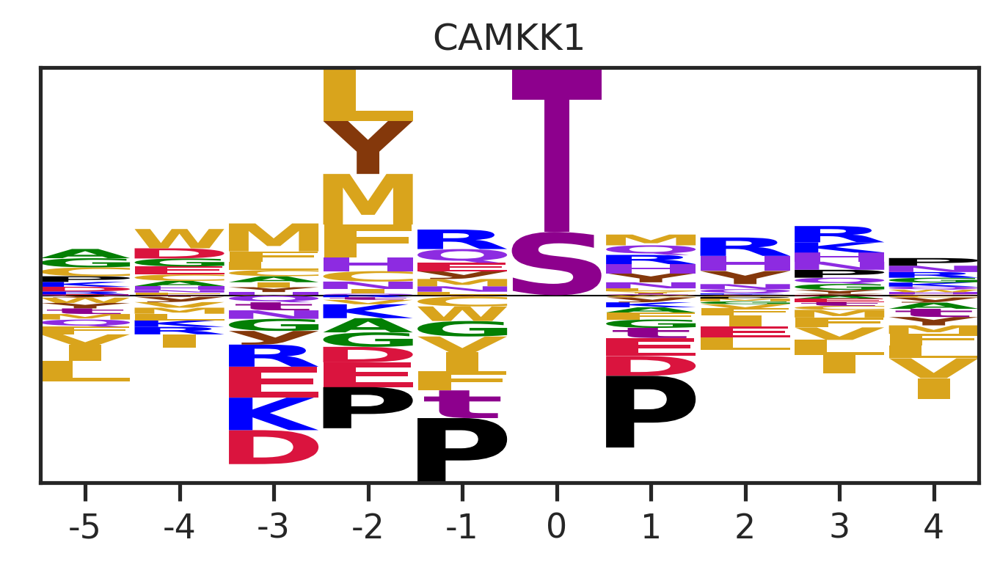

Logo of CAMKK1  based on prediction


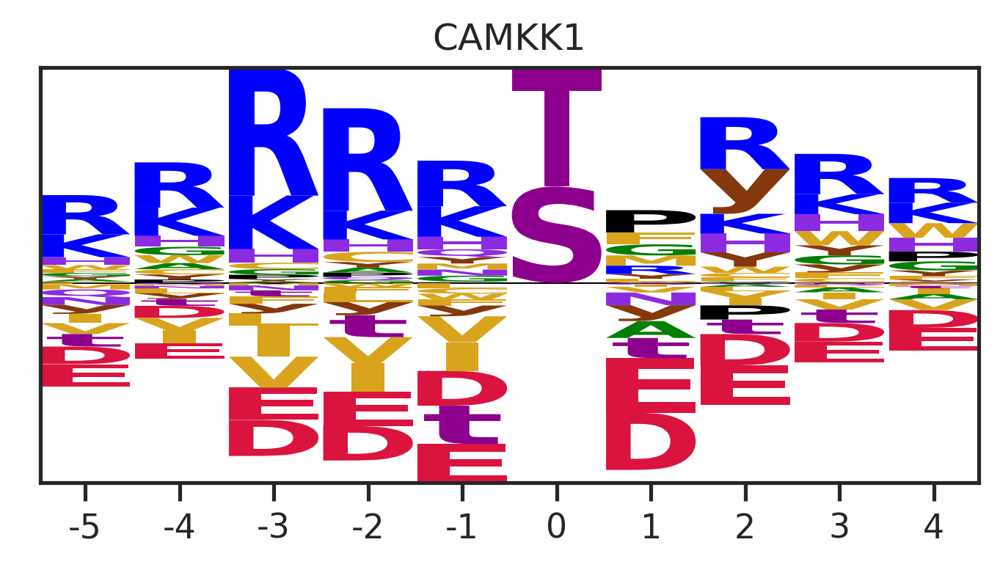

correlation


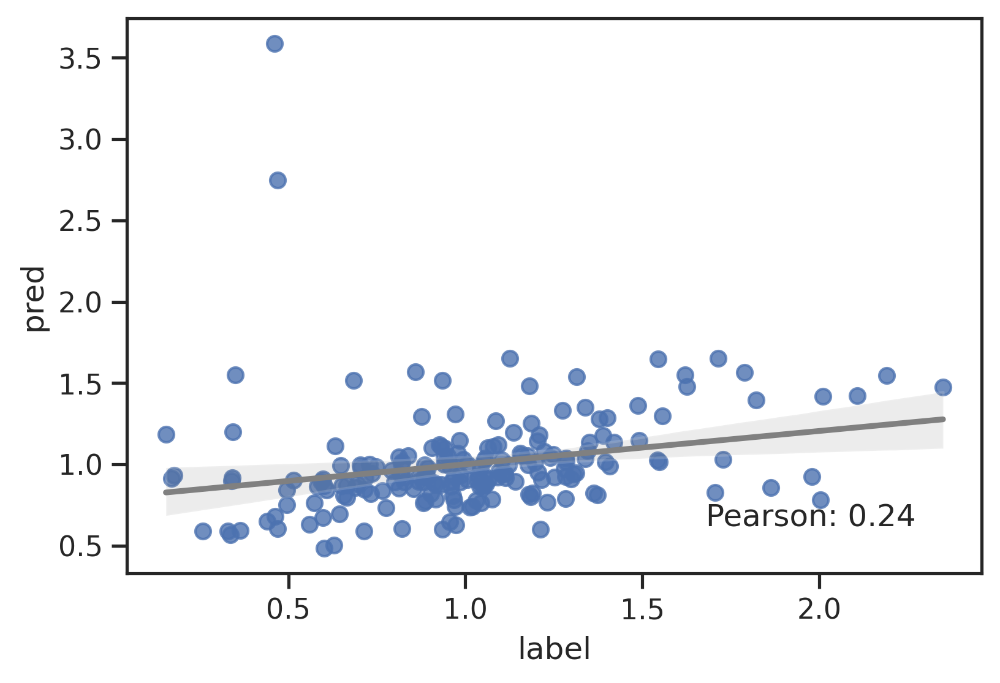

colored by aa


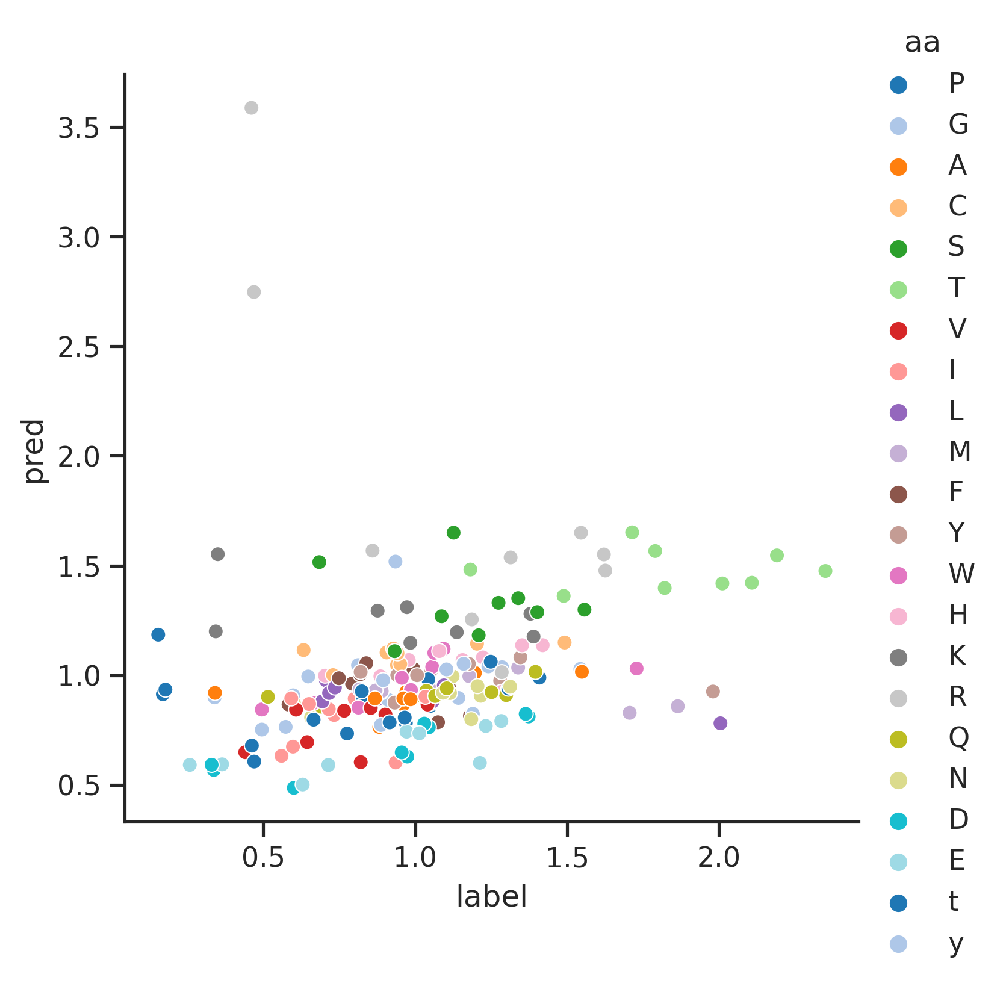

------MASTL------
Logo of MASTL  from raw dataset


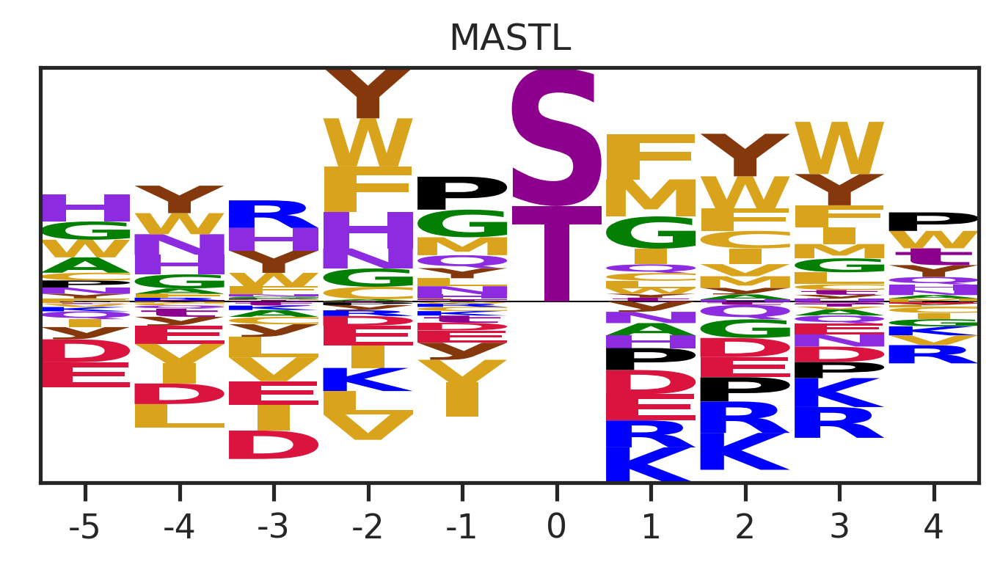

Logo of MASTL  from reversed label


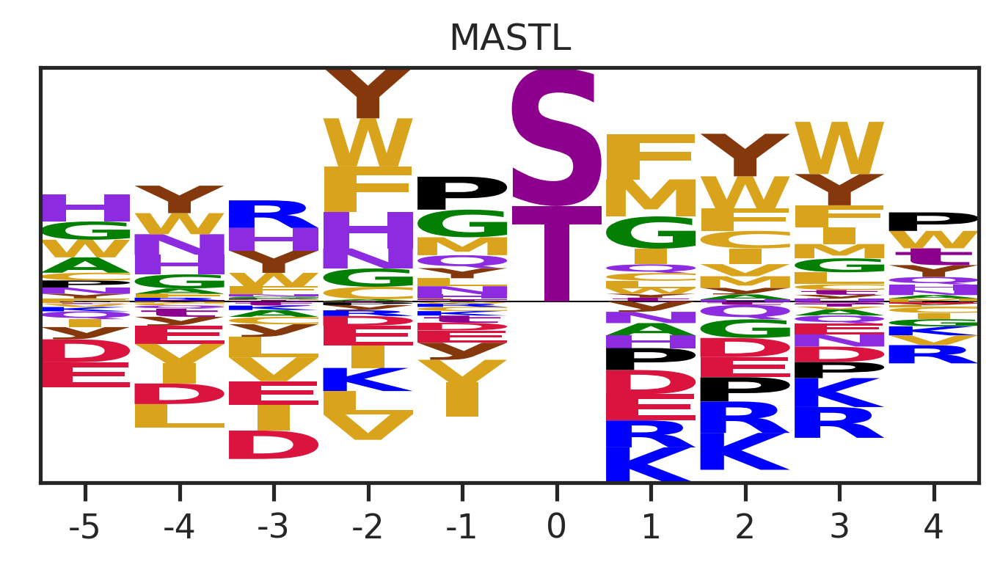

Logo of MASTL  based on prediction


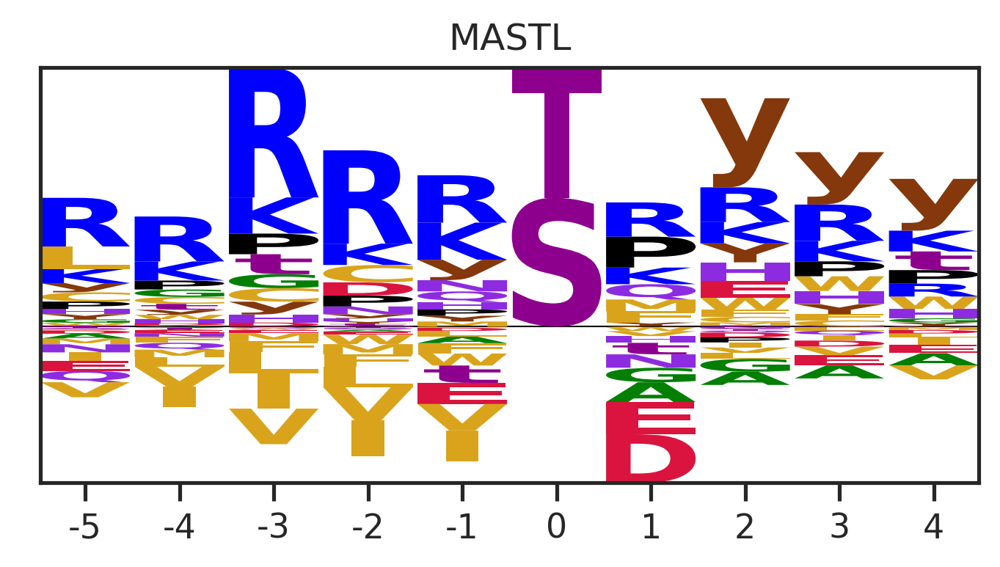

correlation


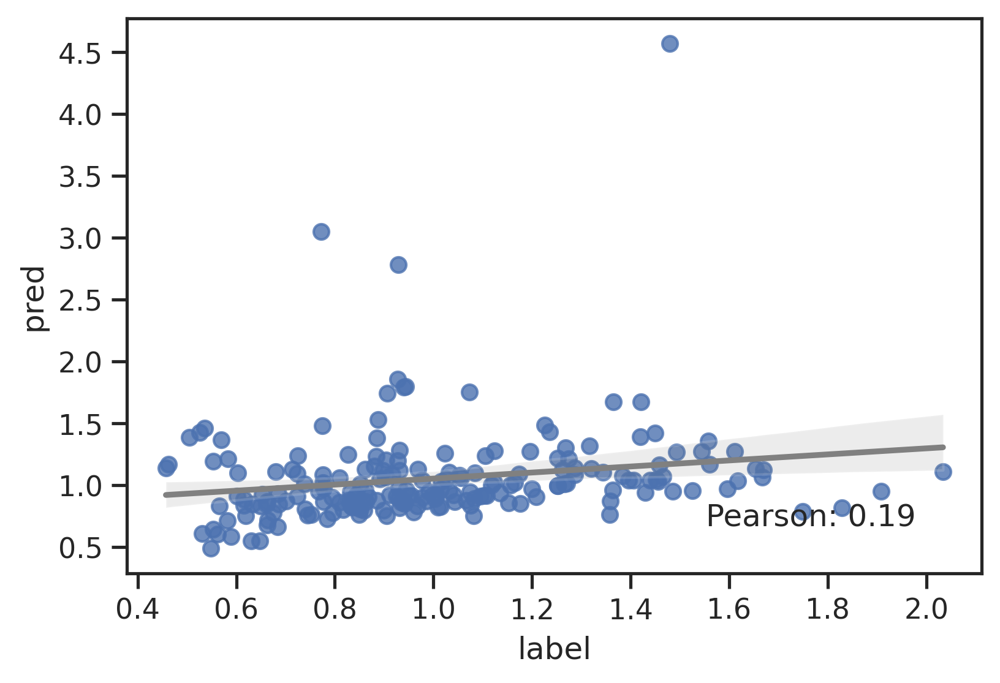

colored by aa


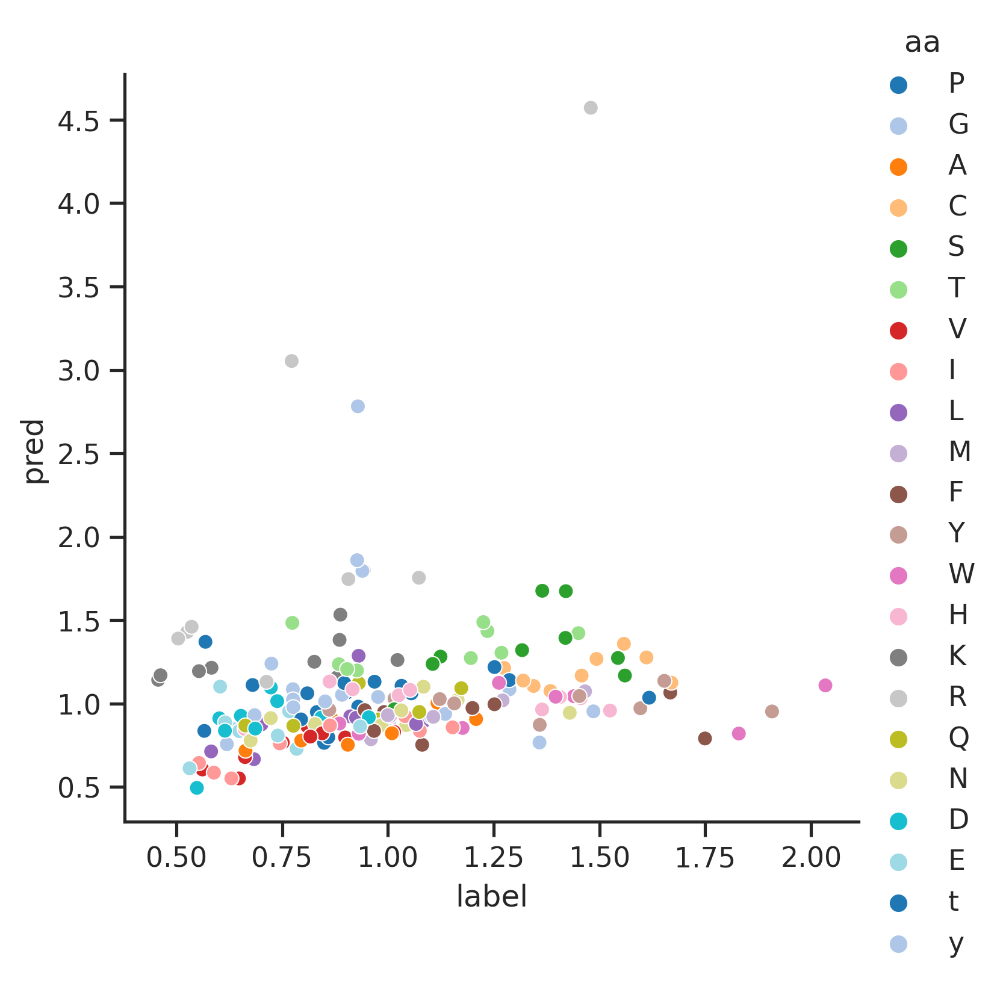

In [ ]:
for k in max_group.kinase:
    print(f'------{k}------')
    kinase_report(pred,k)

### Min group

In [ ]:
# for k in min_group.kinase:
#     print(f'------{k}------')
#     kinase_report(pred,k)